<a id='beginning_CRVA'></a>
# Climate Risk and Vulnerability Analysis
This notebook helps you download and visualize climate data to perform Climate Risk and Vulnerability analyses

## Usage
this is how to use this script

1. [Define user input](#user_input)
2. [Run wanted climate variables](#climate_variables)
    1. [Atmosphere's climate variables](#atmosphere_climate_variables)
    2. [Land climate's variables](#land_climate_variables)
    3. [Hydrosphere's climate variables](#hydrosphere_climate_variables)
    4. [Second effect's climate variables](#second_effect_climate_variables)
3. [Export data](#Export)

## Input data

* [Shapefile with project location(s) as points or polygon](#load_shapefile)
* List of variables
* List of SSP's
* List of time horizons

## [Climate variables](#climate_variables)
### [Atmosphere's climate variables](#atmosphere_climate_variables)
* [Precipitation](#worldbank)
* [Temperature](#worldbank)
* [Wind](#wind)
* [Humidity](#humidity)
* [Solar radiation](#solar_radiation)
* Air quality deterioration
### [Land's climate variables](#land_climate_variables)
* [Landslides](#landslides)
* Coastal erosion
* Soil erosion
* Soil salinity
### [Hydrosphere's climate variables](#hydrosphere_climate_variables)
* [Relative sea level rise](#relative_sea_level_rise)
* [Seawater temperature](#sea_water_temperature)
* [Water availability](#water_availability)
* floods (fluvial)
* floods (coastal)
* forest fires
### [Second effects of climate variables](#second_effect_climate_variables)
* Storms
* Dust storms
* Wildfire
* Urban heat island
* Growinf season length
* [cyclone risk](#cyclone_risk)



* earthquakes (not climate related)

## Climate impacts
* calculate impact on yields

## [Climate change information concerning the projects in the study area](#climate_change_info_for_each_project_in_study_area)


## Contact

rapy@cowi.com


# metedata from WB : file:///C:/Users/CLMRX/AppData/Local/Temp/1/MicrosoftEdgeDownloads/0b2ac254-6810-4449-864f-a2757bc5ce22/CCKP_Metadata_November%202021.pdf

<a id='user_input'></a>
## User inputs

[Home](#beginning_CRVA)

In [2]:
#User inputs
import os.path


#project locations (shapefile with location of elements to evaluate)
data_folder=r'\\COWI.net\projects\A245000\A248363\CRVA\Datasets'
#data_folder=os.path.join(os.pardir,'dataset')
project_location_path=os.path.join(data_folder,'Mozambique_PPIS/EIB_locations_few.shp')
project_id='Name' #name of column used as id

#study boundary (optional)
study_area_path=os.path.join(data_folder,'Mozambique_PPIS/mozambique.shp')

#output folder
#out_path=r'\\COWI.net\projects\A245000\A248363\CRVA\Scripts\outputs'
out_path=r'C:\Users\CLMRX\OneDrive - COWI\Documents\GitHub\CRVA_tool\outputs'
out_path_database=r'\\COWI.net\projects\A245000\A248363\CRVA\Datasets'
#projection CRS (default = 'EPSG:4326')
bCRS='EPSG:4326'

#buffer for climate/grid variables
buffer=40000 #buffer in meters, 0 = no buffer is computed

mCRS='EPSG:31983' #metric CRS for buffer in meters (find relevant metric CRS for location!)

## Import python packages

In [3]:
#Import python packages
from rasterstats import zonal_stats
import pandas as pd
import geopandas as gpd
import rasterio
from rasterio.plot import show
import rioxarray #used when calling ncdata.rio.write_crs
import xarray as xr
import os
import os.path
import matplotlib.pyplot as plt
import netCDF4 as nc#not directly used but needs to be imported for some nc4 files manipulations, use for nc files
from netCDF4 import Dataset
import csv #REMOVE ? not in use ?
import numpy as np
import numpy.ma as ma
from mpl_toolkits.basemap import Basemap
import shutil # to move folders
import warnings
warnings.filterwarnings('ignore') # to ignore the warnings
#import io
import cdsapi # for copernicus function
import datetime # to have actual date
from osgeo import gdal, ogr, osr # in order to convert shp in raster
from geopandas import GeoDataFrame
from shapely.geometry import Point
from matplotlib.lines import Line2D
import seaborn as sns

from FunctionsAndClass import read_cckp_ncdata
from FunctionsAndClass import get_cckp_file_name

from Functions_Indicators import temporal_avg
from Functions_Indicators import df_stat_distr
from Functions_ImportData import import_treat_modeled_NEX_GDDP_CMIP6
from Functions_Indicators import filter_dataframe
from Functions_ImportData import import_BC_NOAA_NEX_GDDP_CMIP6
from Graphs_functions import plot_lines
from Functions_likelihood import likelihood_accross_models
from Functions_exposure import look_best_distr
from Functions_exposure import range_likelihood
from Functions_Indicators import changes_in_indicators
from Functions_Indicators import level_exposure
from Graphs_functions import plot_lines

ModuleNotFoundError: No module named 'mpl_toolkits.basemap'

<a id='load_shapefile'></a>
## Load shapefiles and plot

C:\Users\RAPY\AppData\Local\Temp\ipykernel_11188\347925323.py:23: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  name_project = name_project.str.replace('(','') # take off every ( of project names
C:\Users\RAPY\AppData\Local\Temp\ipykernel_11188\347925323.py:24: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  name_project = name_project.str.replace(')','') # take off every ) of project names
C:\Users\RAPY\AppData\Local\Temp\ipykernel_11188\347925323.py:27: FutureWarning: The default value of regex will change from True to False in a future version.
  name_project = name_project.str.replace(r'"\"','_') # take off every \ of project names
C:\Users\RAPY\AppData\Local\Temp\ipykernel

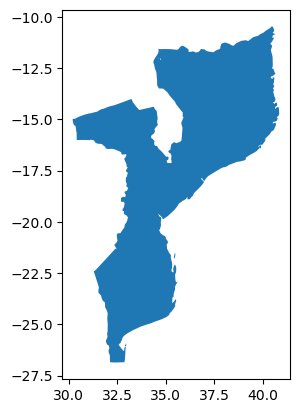

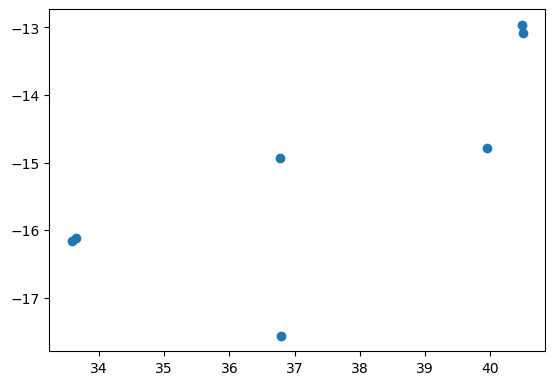

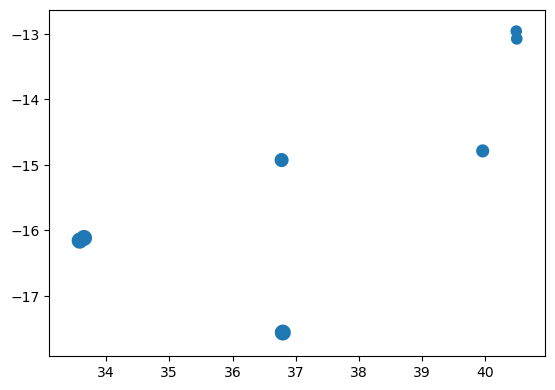

In [4]:
#load shapefiles
projects = gpd.read_file(project_location_path).to_crs(bCRS)
study_area = gpd.read_file(study_area_path).to_crs(bCRS)

#calculate buffer around points/shape
if buffer != 0:
    projects_buf=projects.to_crs(mCRS)  #project to crs with metric units to get buffer in meters
    projects_buf['geometry']=projects.to_crs(mCRS).buffer(buffer) #assign the buffer as the new geometry - 
    projects_buf=projects_buf.to_crs(bCRS)#project back to orginal crs

    
#plot shapefiles
study_area.plot()
projects.plot()
projects_buf.plot() 


#show table
projects[[project_id]]

# prepare name_project for use 
name_project = projects['Name'].str.replace(' ','_') # take off every blank space of project names
name_project = name_project.str.replace('(','') # take off every ( of project names
name_project = name_project.str.replace(')','') # take off every ) of project names
name_project = name_project.str.replace('-','') # take off every - of project names
name_project = name_project.str.replace('/','_') # take off every / of project names
name_project = name_project.str.replace(r'"\"','_') # take off every \ of project names

# register geographic information concerning projects
lon_projects = projects['geometry'].x
lat_projects = projects['geometry'].y
area_projects = [lat_projects - 5, lat_projects+5, lon_projects-5,lon_projects+5] # list format
# 5 degres trop grand 
#### determination of the geographical zone of interest 
lat_min_wanted = min(study_area['LAT'])-10
lat_max_wanted = max(study_area['LAT'])+10
lon_min_wanted = min(study_area['LON'])-20
lon_max_wanted = max(study_area['LON'])+20
# addind and substracting to lon and lat to have margin
# substracting more to longitude because the range of longitude is -180 to 180. The range of latitude is -90 to 90

area = [lat_min_wanted, lon_min_wanted, lat_max_wanted,lon_max_wanted,] # used to download from copernicus
first_year=1950
last_year =2100
### YEAR
year = np.arange(first_year,(last_year+1),1) # create vector of years
year_str = [0]*len(year) # create initiale empty vector to convert years in int
index = np.arange(0,len(year)) # create vector of index for year
i = 0 # initialize index
for i in index: # convert all the date in string format
    year_str[i]=str(year[i])

start_date = "01-01-"+year_str[0] # string start date based on start year
stop_date = "31-12-"+year_str[len(year)-1] # string stop date based on stop year
dates = pd.date_range(start_date,stop_date) # vector of dates between start date and stop date
index_dates = np.arange(0,len(dates)) # vector containning index or dates vector

In [4]:
# name project in mozambique, those ones were added in the shp (there were initially not in the shapefile)
name_projects = np.array(['WTP_Mutua_EIB', 'Gorongosa_EIB', 'Chimoio_WTP_EIB', 'Pemba_EIB'])

lon_projects_data = np.array([34.5927839939706, 34.07824286310398 , 33.47333313659342, 40.52545156033736]) # decimal degrees
lon_projects = pd.Series(lon_projects_data)

lat_projects_data = np.array([-19.495079648575242, -18.68063728746643, -19.125095255188334,-12.973942656747809]) # decimal degrees
lat_projects = pd.Series(lat_projects_data) 
buffer_area_project=2
area_projects = [lat_projects - buffer_area_project, lat_projects+buffer_area_project, lon_projects-buffer_area_project,lon_projects+buffer_area_project] # list format

# elevation above sea level 
elevation_asl_data = np.array([15, 383, 723, 47]) # unit m 
elevation_asl = pd.Series(elevation_asl_data) # unit m 

# add informations of projects in one dataframe
infos_projects = pd.DataFrame()
infos_projects['Name project'] = name_projects
infos_projects['Longitude DD'] = lon_projects
infos_projects['Latitude DD'] = lat_projects
infos_projects['Elevation above sea level m'] = elevation_asl
infos_projects

,Name project,Longitude DD,Latitude DD,Elevation above sea level m
0,WTP_Mutua_EIB,34.592784,-19.495080,15
1,Gorongosa_EIB,34.078243,-18.680637,383
2,Chimoio_WTP_EIB,33.473333,-19.125095,723
3,Pemba_EIB,40.525452,-12.973943,47


<a id='climate_variables'></a>
# Climate variables

[Home](#beginning_CRVA)

<a id='atmosphere_climate_variables'></a>
# ATMOSPHERE

[Home](#beginning_CRVA)

<a id='worldbank'></a>
## World Bank Climate knowledge portal, Precipitation and Temperature - Atmosphere
data source: https://climateknowledgeportal.worldbank.org/download-data

List of different variables:

### Precipitation 
* return period of current 50 and 100 year event
* yearly average precipitation
* seasonal average precipitation - OR MONTH? i word documnet: average dry season precipitation 
* maximum precipitation in one day - NOT REALLY, instead "Average of the largest daily precipitation amount" rx1day 
* maximum precipitation in five days - NOT REALLY, instead "Average of the largest 5-day consecutive precipitation amount".
* FORSLAG: Could also include: precipitation amount from very wet days/ days >50mm. eg. 

### Temperature
* Yearly mean temperature (average) - tas 
* Number of hot days >40 degrees C (average)
* Number of hot days >35 degrees C (average) 
* Maximum of daily max-temperature (per year) -txx
* Average of maximum temperature (daily??) - tasmax 

### How to use
define 

`variables = {variablename1:{'periods':['2020-2039'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']}, variablename2:...}`

where variablename corresponds to a variable name in the cckp, periods include the desired periods, ssps the desired ssp-rcp scenarios, and gcms can be either median, p10, or p90 (50%, 10%, and 90% percentile of ensemble models).

In [6]:
#Read downloaded precipitation and temperature data
#settings

variables= {
    #Temperature
        #era/cru
            #'climatology-hd35-annual-mean_era':{'periods':['1991-2020']},
            'climatology-hd40-annual-mean_era':{'periods':['1991-2020']},
            'climatology-tasmax-annual-mean_era':{'periods':['1991-2020']}, 
            'climatology-tas-annual-mean_era':{'periods':['1991-2020']},
            'climatology-tasmax-annual-mean_cru':{'periods':['1991-2020']}, 
        #realtime
            'climatology-hd40':{'periods':['2020-2039'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            'anomaly-hd40':{'periods':['2020-2039'],'ssps':['ssp245','ssp370'],'gcms':['median']},
            #'anomaly-hd35':{'periods':['2020-2039'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            #'anomaly-tasmax':{'periods':['2020-2039','2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']}, 
            'anomaly-txx':{'periods':['2020-2039','2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']}, #txx=maximum of daily max temperature
            'climatology-txx':{'periods':['2020-2039','2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            'anomaly-tas':{'periods':['2020-2039'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            'climatology-tas':{'periods':['2020-2039','2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']}, #data not downloaded 
    #Precipitation
       #era/cru
            #'climatology-r50mm-annual-mean_era_annual':{'periods':['1991-2020']},
            'climatology-rx1day-monthly-mean_era_monthly':{'periods':['1991-2020']},
            'climatology-rx1day-annual-mean_era_annual':{'periods':['1991-2020']},
            'climatology-pr-annual-mean_era_annual':{'periods':['1991-2020']},
            'climatology-pr-monthly-mean_era_monthly':{'periods':['1991-2020']},
            'climatology-pr-annual-mean_cru':{'periods':['1991-2020']},
        #realtime
            'frp100yr-rx1day-period-mean_cmip6_period':{'periods':['2010-2039','2035-2064'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']}, 
            'frp50yr-rx1day-period-mean_cmip6_period':{'periods':['2010-2039'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            'climatology-rx5day-annual-mean_cmip6_annual':{'periods':['2020-2039','2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            'climatology-rx1day-annual-mean_cmip6_annual':{'periods':['2020-2039','2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            'climatology-pr-monthly-mean_cmip6_monthly':{'periods':['2020-2039','2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            'climatology-pr-annual-mean_cmip6_annual':{'periods':['2020-2039','2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            'climatology-pr-seasonal-mean_cmip6_seasonal':{'periods':['2020-2039','2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            'changefactorfaep100yr-rx1day-period-mean_cmip6_period':{'periods':['2010-2039'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']},
            #'anomaly-pr-monthly-mean_cmip6_monthly':{'periods':['2040-2059'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']}
            }
       ## 'timeseries-rx1day':{'periods':['2015-2100'],'ssps':['ssp245'],'gcms':['median']} # Den kan ikke læse den - brokker sig over Dimension time=0. 
       
#Create multi index for cckp_output
idx=pd.IndexSlice
mindex=[]
for var in variables.keys():
    for period in variables[var]['periods']:
        if period in ['1991-2020']:
            mindex.append((var,period,None,None))
        else:
            for ssp in variables[var]['ssps']:
                    for gcm in variables[var]['gcms']:
                        mindex.append((var,period,ssp,gcm))
mindex=pd.MultiIndex.from_tuples(mindex, names=['variable', 'period','ssp','gcm'])
#cckp_output=pd.DataFrame(index=projects[project_id],columns=mindex)
cckp_output=pd.DataFrame(index=mindex,columns=projects[project_id])

#read data from cckp and spatial statistics
for var in variables.keys():
    for period in variables[var]['periods']:
        if period in ['1991-2020']: # for era/cru data
            varname='_'.join((var,period))
            data_path=get_cckp_file_name(var,period=period)
            if os.path.exists(data_path):
                data=read_cckp_ncdata(data_path)
                stats=pd.DataFrame(zonal_stats(vectors=projects_buf, raster=data,all_touched=True, stats='mean'))
                projects[varname]=stats
                #cckp_output.loc[:,idx[var,period,:,:]]=stats.values
                cckp_output.loc[idx[var,period,:,:],:]=stats.T.values
            else:
                print(data_path,"not found")
                projects[varname]='not found'
        elif period not in ['1991-2020']: #for realtime data 
                for ssp in variables[var]['ssps']:
                    for gcm in variables[var]['gcms']:
                        varname='_'.join((var,period,ssp,gcm))
                        data_path=get_cckp_file_name(var,ssp=ssp,period=period,gcm=gcm)
                        if os.path.exists(data_path):
                            data=read_cckp_ncdata(data_path)
                            stats=pd.DataFrame(zonal_stats(vectors=projects_buf, raster=data,all_touched=True, stats='mean'))
                            projects[varname]=stats
                            #cckp_output.loc[:,idx[var,period,ssp,gcm]]=stats.values
                            cckp_output.loc[idx[var,period,ssp,gcm],:]=stats.T.values
                        else:
                            print(data_path,"not found")
                            projects[varname]='not found'


#plot, show #ADD enlarge the clip + something wierd with nodata value
cckp_output.to_csv('outputs/csv/cckp_output.csv')
projects[[project_id,varname]].head()

fig, ax = plt.subplots()
precip = rioxarray.open_rasterio(data)
precip_clip = precip.rio.clip(study_area.geometry, study_area.crs, drop=True)
precip_clip.plot(ax=ax)
projects.plot(ax=ax)

#close
precip.close()

NameError: name 'get_cckp_file_name' is not defined

## DELETE FROM HERE Temperature

By comparing NEX GDDP CMIP6 data to observed data, we know that the models 'TAIESM1' and 'CMCC-CM2-SR5' do not comply to the observed data. We are taking them off the analysis.
A bias correction does not better the queality of the data. It follows oberved data enough

In [6]:
df_tas_NEXGDDPCMIP6=import_treat_modeled_NEX_GDDP_CMIP6('tas','Celsius','day',1950,2100)

In [7]:
df_tas_NEXGDDPCMIP6

,Name project,Experiment,Model,Latitude,Longitude,Date,Daily Near-Surface Air Temperature °C,Year,Month,Season
0,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,01-01-1950,30.038757,1950,Jan,Humid
1,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,02-01-1950,30.407043,1950,Jan,Humid
2,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,03-01-1950,30.592712,1950,Jan,Humid
3,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,04-01-1950,31.287659,1950,Jan,Humid
4,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,05-01-1950,25.517853,1950,Jan,Humid
...,...,...,...,...,...,...,...,...,...,...
8963095,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,27-12-2100,35.812469,2100,Dec,Humid
8963096,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,28-12-2100,35.473541,2100,Dec,Humid
8963097,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,29-12-2100,34.798248,2100,Dec,Humid
8963098,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,30-12-2100,33.925507,2100,Dec,Humid


In [8]:
df_tas_NEXGDDPCMIP6_gorongosa = filter_dataframe(df_tas_NEXGDDPCMIP6,['Gorongosa_EIB'],['TAIEMS1','CMCC-CM2-SR5'])

In [9]:
df_tas_NEXGDDPCMIP6_all_projects = filter_dataframe(df_tas_NEXGDDPCMIP6,list(set(df_tas_NEXGDDPCMIP6['Name project'])),['TAIEMS1','CMCC-CM2-SR5'])

### Incremental air temperature change

In [10]:
df_yearly_avg_tas_NEXGDDPCMIP6_gorongosa=temporal_avg(df_tas_NEXGDDPCMIP6_gorongosa,'temperature','Yearly average temperature','year')

In [11]:
df_yearly_avg_tas_NEXGDDPCMIP6_gorongosa

Yearly average temperature
Name project  Experiment Model      Year                            
Gorongosa_EIB historical ACCESS-CM2 1950                   23.864192
                                    1951                   23.243487
                                    1952                   23.682020
                                    1953                   23.113887
                                    1954                   23.167121
...                                                              ...
              ssp585     TaiESM1    2096                   31.616700
                                    2097                   30.400238
                                    2098                   30.168588
                                    2099                   33.272017
                                    2100                   32.822640

[5726 rows x 1 columns]

In [12]:
df_yearly_avg_tas_NEXGDDPCMIP6=temporal_avg(df_tas_NEXGDDPCMIP6_all_projects,'temperature','Yearly average temperature','year')

In [13]:
# use this function to know statistical dittribution of data

df_stat_distr_yearly_avg_tas_NEXGDDPCMIP6_gorongosa=df_stat_distr(df_yearly_avg_tas_NEXGDDPCMIP6_gorongosa)

In [14]:
df_stat_distr_yearly_avg_tas_NEXGDDPCMIP6_gorongosa

Yearly average temperature                                  \
                                   count       mean       std        min   
Name project                                                               
Gorongosa_EIB                     5635.0  25.492532  1.500983  22.059981   

                                                           
                     10%        50%        90%        max  
Name project                                               
Gorongosa_EIB  23.677566  25.316314  27.460903  33.272017

In [15]:
# use this function to know statistical dittribution of data

df_stat_distr_yearly_avg_tas_NEXGDDPCMIP6=df_stat_distr(df_yearly_avg_tas_NEXGDDPCMIP6)
df_stat_distr_yearly_avg_tas_NEXGDDPCMIP6

Yearly average temperature                                  \
                                     count       mean       std        min   
Name project                                                                 
Chimoio_WTP_EIB                     5635.0  24.200671  1.564313  20.541947   
Gorongosa_EIB                       5635.0  25.492532  1.500983  22.059981   
Pemba_EIB                           5635.0  28.196791  1.390928  25.229386   
WTP_Mutua_EIB                       5635.0  26.757209  1.392905  23.333962   

                                                             
                       10%        50%        90%        max  
Name project                                                 
Chimoio_WTP_EIB  22.347565  23.989958  26.255106  32.893055  
Gorongosa_EIB    23.677566  25.316314  27.460903  33.272017  
Pemba_EIB        26.353523  28.134202  30.024502  33.511357  
WTP_Mutua_EIB    24.989720  26.665115  28.549426  33.756870

In [16]:
df_monthly_avg_tas_NEXGDDPCMIP6_gorongosa=temporal_avg(df_tas_NEXGDDPCMIP6_gorongosa,'temperature','Monthly average temperature','month')

In [17]:
df_monthly_avg_tas_NEXGDDPCMIP6=temporal_avg(df_tas_NEXGDDPCMIP6,'temperature','Monthly average temperature','month')

### Extreme temperature increase

In [18]:
df_tasmax_NEXGDDPCMIP6=import_treat_modeled_NEX_GDDP_CMIP6('tasmax','Celsius','day',1950,2100)

In [19]:
df_tasmax_NEXGDDPCMIP6

,Name project,Experiment,Model,Latitude,Longitude,Date,Daily Maximum Near-Surface Air Temperature °C,Year,Month,Season
0,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,01-01-1950,35.320282,1950,Jan,Humid
1,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,02-01-1950,36.137665,1950,Jan,Humid
2,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,03-01-1950,36.790802,1950,Jan,Humid
3,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,04-01-1950,38.028870,1950,Jan,Humid
4,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,05-01-1950,30.809021,1950,Jan,Humid
...,...,...,...,...,...,...,...,...,...,...
8365555,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,27-12-2100,41.910736,2100,Dec,Humid
8365556,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,28-12-2100,41.574432,2100,Dec,Humid
8365557,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,29-12-2100,40.901733,2100,Dec,Humid
8365558,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,30-12-2100,40.031464,2100,Dec,Humid


In [20]:
df_tasmax_NEXGDDPCMIP6 = filter_dataframe(df_tasmax_NEXGDDPCMIP6,list(set(df_tasmax_NEXGDDPCMIP6['Name project'])),['TAIEMS1','CMCC-CM2-SR5'])

In [21]:
df_tasmax_NEXGDDPCMIP6

,Name project,Experiment,Model,Latitude,Longitude,Date,Daily Maximum Near-Surface Air Temperature °C,Year,Month,Season
6274170,Pemba_EIB,historical,ACCESS-CM2,-12.875,40.625,01-01-1950,33.245087,1950,Jan,Humid
6274171,Pemba_EIB,historical,ACCESS-CM2,-12.875,40.625,02-01-1950,33.782166,1950,Jan,Humid
6274172,Pemba_EIB,historical,ACCESS-CM2,-12.875,40.625,03-01-1950,33.477509,1950,Jan,Humid
6274173,Pemba_EIB,historical,ACCESS-CM2,-12.875,40.625,04-01-1950,32.702179,1950,Jan,Humid
6274174,Pemba_EIB,historical,ACCESS-CM2,-12.875,40.625,05-01-1950,32.773590,1950,Jan,Humid
...,...,...,...,...,...,...,...,...,...,...
6274165,Chimoio_WTP_EIB,ssp370,TaiESM1,-19.125,33.375,27-12-2100,35.355743,2100,Dec,Humid
6274166,Chimoio_WTP_EIB,ssp370,TaiESM1,-19.125,33.375,28-12-2100,44.227753,2100,Dec,Humid
6274167,Chimoio_WTP_EIB,ssp370,TaiESM1,-19.125,33.375,29-12-2100,45.011108,2100,Dec,Humid
6274168,Chimoio_WTP_EIB,ssp370,TaiESM1,-19.125,33.375,30-12-2100,29.857178,2100,Dec,Humid


In [22]:
df=df_tasmax_NEXGDDPCMIP6[['Name project','Experiment','Model','Year','Daily Maximum Near-Surface Air Temperature °C']].groupby(['Name project','Experiment','Model','Year'])[['Daily Maximum Near-Surface Air Temperature °C']].mean().reset_index()

In [23]:
df

,Name project,Experiment,Model,Year,Daily Maximum Near-Surface Air Temperature °C
0,Chimoio_WTP_EIB,historical,ACCESS-CM2,1950,28.015329
1,Chimoio_WTP_EIB,historical,ACCESS-CM2,1951,26.720178
2,Chimoio_WTP_EIB,historical,ACCESS-CM2,1952,28.130722
3,Chimoio_WTP_EIB,historical,ACCESS-CM2,1953,27.224301
4,Chimoio_WTP_EIB,historical,ACCESS-CM2,1954,27.198646
...,...,...,...,...,...
21263,WTP_Mutua_EIB,ssp585,TaiESM1,2096,41.472748
21264,WTP_Mutua_EIB,ssp585,TaiESM1,2097,40.648567
21265,WTP_Mutua_EIB,ssp585,TaiESM1,2098,39.462682
21266,WTP_Mutua_EIB,ssp585,TaiESM1,2099,42.749100


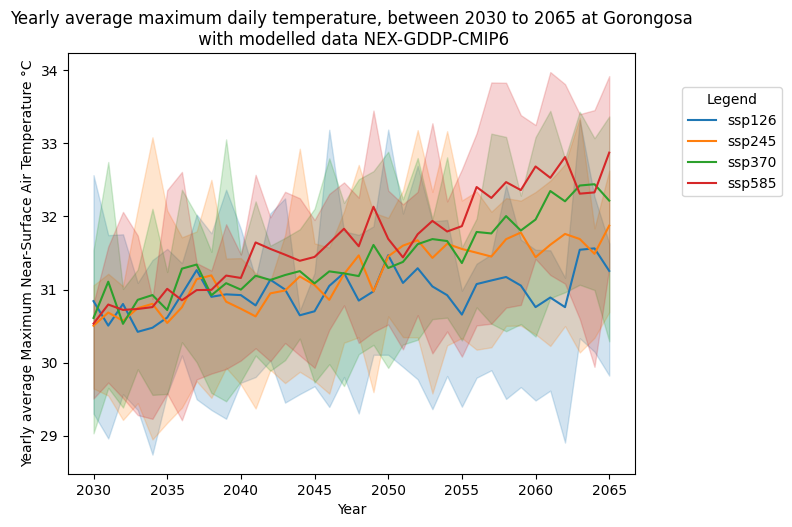

In [24]:
plot_lines(df[(df['Name project']=='Gorongosa_EIB') & (df['Year'].between(2030,2065))],'Year','Daily Maximum Near-Surface Air Temperature °C','Experiment','NEX-GDDP-CMIP6','Yearly average Maximum Near-Surface Air Temperature °C','Yearly average maximum daily temperature','Gorongosa',y_start=2030,y_stop=2065,tuple_error_bar=('pi',80))

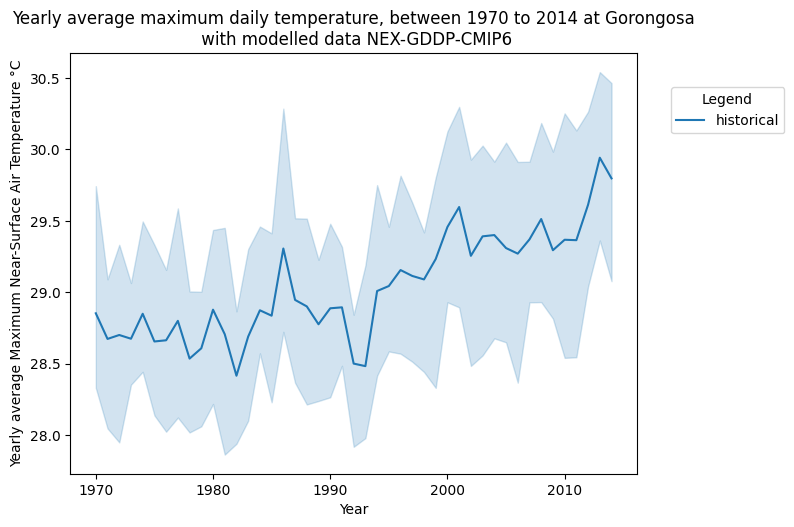

In [25]:
plot_lines(df[(df['Name project']=='Gorongosa_EIB') & (df['Year'].between(1970,2014))],'Year','Daily Maximum Near-Surface Air Temperature °C','Experiment','NEX-GDDP-CMIP6','Yearly average Maximum Near-Surface Air Temperature °C','Yearly average maximum daily temperature','Gorongosa',y_start=1970,y_stop=2014,tuple_error_bar=('pi',80))

In [26]:
# tasmax with BC data 

In [27]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj=import_BC_NOAA_NEX_GDDP_CMIP6('tasmax',2030,2065,EmplacementStationNOAA='no')

In [28]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_past=import_BC_NOAA_NEX_GDDP_CMIP6('tasmax',1970,2014,EmplacementStationNOAA='no')

In [29]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj_gorongosa=df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj[df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj['Name project']=='Gorongosa_EIB']

In [30]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_past_gorongosa=df_tasmax_NEXGDDPCMIP6_BC_NOAA_past[df_tasmax_NEXGDDPCMIP6_BC_NOAA_past['Name project']=='Gorongosa_EIB']

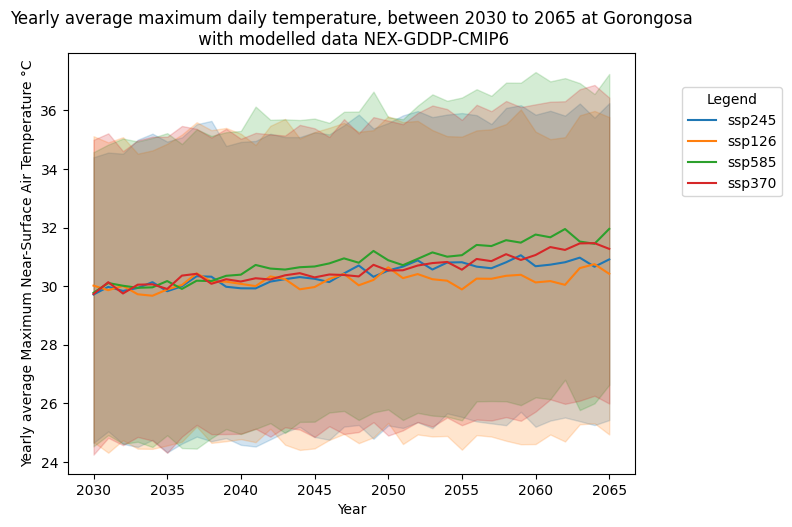

In [31]:
plot_lines(df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj,'Year','Daily Maximum Near-Surface Air Temperature °C','Experiment','NEX-GDDP-CMIP6','Yearly average Maximum Near-Surface Air Temperature °C','Yearly average maximum daily temperature','Gorongosa',y_start=2030,y_stop=2065,tuple_error_bar=('pi',80))

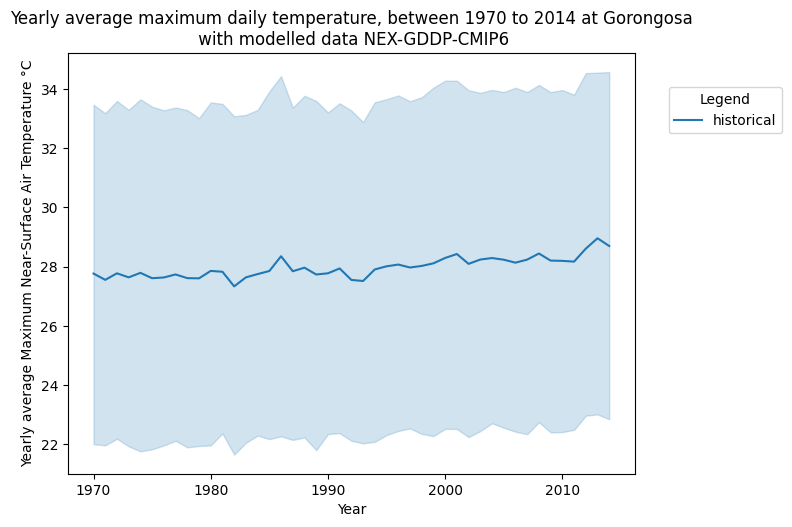

In [32]:
plot_lines(df_tasmax_NEXGDDPCMIP6_BC_NOAA_past_gorongosa,'Year','Daily Maximum Near-Surface Air Temperature °C','Experiment','NEX-GDDP-CMIP6','Yearly average Maximum Near-Surface Air Temperature °C','Yearly average maximum daily temperature','Gorongosa',y_start=1970,y_stop=2014,tuple_error_bar=('pi',80))

In [33]:
# vulnerability

In [34]:
df_tasmax_NEXGDDPCMIP6_past = df_tasmax_NEXGDDPCMIP6_BC_NOAA_past
df_tasmax_NEXGDDPCMIP6_future = df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj

In [35]:
df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_past=df_stat_distr(df_tasmax_NEXGDDPCMIP6_past[['Name project','Daily Maximum Near-Surface Air Temperature °C']])
df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_future=df_stat_distr(df_tasmax_NEXGDDPCMIP6_future[['Name project','Daily Maximum Near-Surface Air Temperature °C']])

In [36]:
df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_past

Daily Maximum Near-Surface Air Temperature °C             \
                                                        count       mean   
Name project                                                               
Chimoio_WTP_EIB                                      180741.0  26.773981   
Gorongosa_EIB                                        180741.0  27.979314   
Pemba_EIB                                            180741.0  29.529723   
WTP_Mutua_EIB                                        180741.0  29.197164   

                                                                       \
                      std        min        10%        50%        90%   
Name project                                                            
Chimoio_WTP_EIB  4.418543   8.567041  20.992195  26.770608  32.541770   
Gorongosa_EIB    4.393882   8.265334  22.251981  27.984481  33.723474   
Pemba_EIB        1.953121  19.891615  27.021954  29.525763  32.024243   
WTP_Mutua_EIB    3.350075  17.166876  24.672211  29.367613  33.404891   

                            
                       max  
Name project                
Chimoio_WTP_EIB  44.041470  
Gorongosa_EIB    44.966620  
Pemba_EIB        41.792486  
WTP_Mutua_EIB    44.510667

In [37]:
df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_future

Daily Maximum Near-Surface Air Temperature °C             \
                                                        count       mean   
Name project                                                               
Chimoio_WTP_EIB                                      630936.0  29.201292   
Gorongosa_EIB                                        630936.0  30.320724   
Pemba_EIB                                            630936.0  31.163893   
WTP_Mutua_EIB                                        630936.0  31.271808   

                                                                       \
                      std        min        10%        50%        90%   
Name project                                                            
Chimoio_WTP_EIB  5.022242  10.721912  22.866574  28.981729  35.700172   
Gorongosa_EIB    4.955625  10.082307  24.075540  30.121552  36.732203   
Pemba_EIB        2.307403  20.368086  28.336820  31.034378  34.129940   
WTP_Mutua_EIB    3.821334  17.227309  26.294358  31.265712  36.081102   

                            
                       max  
Name project                
Chimoio_WTP_EIB  54.591113  
Gorongosa_EIB    55.867739  
Pemba_EIB        44.760951  
WTP_Mutua_EIB    50.463914

In [38]:
changes_past_future_indicator=changes_in_indicators(df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_past,df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_future,'Maximum temperature in year', '°C','Extreme temperature increase')

In [39]:
changes_past_future_indicator

Extreme temperature increase                            \
                  Maximum temperature in year                             
                Median for the past period °C Change in the median in %   
Chimoio_WTP_EIB                     26.770608                  8.259510   
Gorongosa_EIB                       27.984481                  7.636628   
Pemba_EIB                           29.525763                  5.109486   
WTP_Mutua_EIB                       29.367613                  6.463238   

                                                         \
                                                          
                10-th percentile for the past period °C   
Chimoio_WTP_EIB                               20.992195   
Gorongosa_EIB                                 22.251981   
Pemba_EIB                                     27.021954   
WTP_Mutua_EIB                                 24.672211   

                                              \
                                               
                Change in 10-th percentile %   
Chimoio_WTP_EIB                     8.928937   
Gorongosa_EIB                       8.195041   
Pemba_EIB                           4.865915   
WTP_Mutua_EIB                       6.574794   

                                                         \
                                                          
                90-th percentile for the past period °C   
Chimoio_WTP_EIB                               32.541770   
Gorongosa_EIB                                 33.723474   
Pemba_EIB                                     32.024243   
WTP_Mutua_EIB                                 33.404891   

                                              
                                              
                Change in 90-th percentile %  
Chimoio_WTP_EIB                     9.705686  
Gorongosa_EIB                       8.921767  
Pemba_EIB                           6.575323  
WTP_Mutua_EIB                       8.011433

In [40]:
ExposureLevel_tasmax = level_exposure(changes_past_future_indicator)

For project Chimoio_WTP_EIB, climate variable Extreme temperature increase
For project Gorongosa_EIB, climate variable Extreme temperature increase
For project Pemba_EIB, climate variable Extreme temperature increase
For project WTP_Mutua_EIB, climate variable Extreme temperature increase


In [41]:
ExposureLevel_tasmax

,Exposure level
,Extreme temperature increase
Chimoio_WTP_EIB,No
Gorongosa_EIB,No
Pemba_EIB,No
WTP_Mutua_EIB,No


In [42]:
# vulnerability with BC data

In [43]:
df_tasmax_NEXGDDPCMIP6_BC_past = df_tasmax_NEXGDDPCMIP6[df_tasmax_NEXGDDPCMIP6['Experiment']=='historical']
df_tasmax_NEXGDDPCMIP6_BC_future = df_tasmax_NEXGDDPCMIP6[df_tasmax_NEXGDDPCMIP6['Experiment']!='historical']
df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_BC_past=df_stat_distr(df_tasmax_NEXGDDPCMIP6_BC_past[['Name project','Daily Maximum Near-Surface Air Temperature °C']])
df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_BC_future=df_stat_distr(df_tasmax_NEXGDDPCMIP6_BC_future[['Name project','Daily Maximum Near-Surface Air Temperature °C']])
changes_past_future_indicator_BC=changes_in_indicators(df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_BC_past,df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_BC_future,'Maximum temperature in year', '°C','Extreme temperature increase')
ExposureLevel_tasmax_BC = level_exposure(changes_past_future_indicator_BC)

For project Chimoio_WTP_EIB, climate variable Extreme temperature increase
For project Gorongosa_EIB, climate variable Extreme temperature increase
For project Pemba_EIB, climate variable Extreme temperature increase
For project WTP_Mutua_EIB, climate variable Extreme temperature increase


In [44]:
df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_BC_past

Daily Maximum Near-Surface Air Temperature °C             \
                                                        count       mean   
Name project                                                               
Chimoio_WTP_EIB                                      308537.0  27.724600   
Gorongosa_EIB                                        308537.0  28.931773   
Pemba_EIB                                            308537.0  30.673569   
WTP_Mutua_EIB                                        308537.0  29.753461   

                                                                       \
                      std        min        10%        50%        90%   
Name project                                                            
Chimoio_WTP_EIB  3.526273  13.305054  23.117255  27.681976  32.351147   
Gorongosa_EIB    3.434802  15.580231  24.460406  28.913879  33.420020   
Pemba_EIB        1.447977  22.855896  28.854663  30.635468  32.543713   
WTP_Mutua_EIB    3.145639  17.020630  25.556519  29.868164  33.773907   

                            
                       max  
Name project                
Chimoio_WTP_EIB  43.314514  
Gorongosa_EIB    43.583130  
Pemba_EIB        37.176727  
WTP_Mutua_EIB    43.098328

In [45]:
df_stat_distr_yearly_avg_tasmax_NEXGDDPCMIP6_BC_future

Daily Maximum Near-Surface Air Temperature °C             \
                                                        count       mean   
Name project                                                               
Chimoio_WTP_EIB                                     1601457.0  30.574914   
Gorongosa_EIB                                       1601457.0  31.689442   
Pemba_EIB                                           1601457.0  32.656300   
WTP_Mutua_EIB                                       1601457.0  32.239084   

                                                                       \
                      std        min        10%        50%        90%   
Name project                                                            
Chimoio_WTP_EIB  4.579486  14.185394  25.070770  30.197388  36.397552   
Gorongosa_EIB    4.433929  15.844086  26.350024  31.336548  37.308655   
Pemba_EIB        2.133422  22.238281  30.169678  32.448975  35.400024   
WTP_Mutua_EIB    3.925993  16.888428  27.343677  32.073212  37.186615   

                            
                       max  
Name project                
Chimoio_WTP_EIB  61.075409  
Gorongosa_EIB    61.573547  
Pemba_EIB        46.091614  
WTP_Mutua_EIB    57.338226

In [46]:
ExposureLevel_tasmax_BC

,Exposure level
,Extreme temperature increase
Chimoio_WTP_EIB,No
Gorongosa_EIB,No
Pemba_EIB,No
WTP_Mutua_EIB,No


In [47]:
# Likelihood

In [48]:
# accross all the models and scenarios # way too long
#(name_distr,param_distr)=look_best_distr(df_tasmax_NEXGDDPCMIP6_mutua['Daily Maximum Near-Surface Air Temperature °C'].dropna(),'tasmax','°C')

In [49]:
df_tasmax_NEXGDDPCMIP6_Gorongosa_EIB = df_tasmax_NEXGDDPCMIP6[df_tasmax_NEXGDDPCMIP6['Name project']=='Gorongosa_EIB']

In [50]:
df_tasmax_NEXGDDPCMIP6_gorongosa_modelACCESS=df_tasmax_NEXGDDPCMIP6_Gorongosa_EIB[df_tasmax_NEXGDDPCMIP6_Gorongosa_EIB['Model']=='ACCESS-CM2']

In [51]:
df_tasmax_NEXGDDPCMIP6_gorongosa_modelACCESS_ssp370=df_tasmax_NEXGDDPCMIP6_gorongosa_modelACCESS[df_tasmax_NEXGDDPCMIP6_gorongosa_modelACCESS['Experiment']=='ssp370']

In [52]:
df_tasmax_NEXGDDPCMIP6_gorongosa_modelACCESS_ssp370

,Name project,Experiment,Model,Latitude,Longitude,Date,Daily Maximum Near-Surface Air Temperature °C,Year,Month,Season
3743026,Gorongosa_EIB,ssp370,ACCESS-CM2,-18.625,34.125,01-01-2015,29.709473,2015,Jan,Humid
3743027,Gorongosa_EIB,ssp370,ACCESS-CM2,-18.625,34.125,02-01-2015,31.274048,2015,Jan,Humid
3743028,Gorongosa_EIB,ssp370,ACCESS-CM2,-18.625,34.125,03-01-2015,33.196442,2015,Jan,Humid
3743029,Gorongosa_EIB,ssp370,ACCESS-CM2,-18.625,34.125,04-01-2015,32.853363,2015,Jan,Humid
3743030,Gorongosa_EIB,ssp370,ACCESS-CM2,-18.625,34.125,05-01-2015,27.969299,2015,Jan,Humid
...,...,...,...,...,...,...,...,...,...,...
3774432,Gorongosa_EIB,ssp370,ACCESS-CM2,-18.625,34.125,27-12-2100,29.814453,2100,Dec,Humid
3774433,Gorongosa_EIB,ssp370,ACCESS-CM2,-18.625,34.125,28-12-2100,34.121490,2100,Dec,Humid
3774434,Gorongosa_EIB,ssp370,ACCESS-CM2,-18.625,34.125,29-12-2100,36.449097,2100,Dec,Humid
3774435,Gorongosa_EIB,ssp370,ACCESS-CM2,-18.625,34.125,30-12-2100,36.032867,2100,Dec,Humid


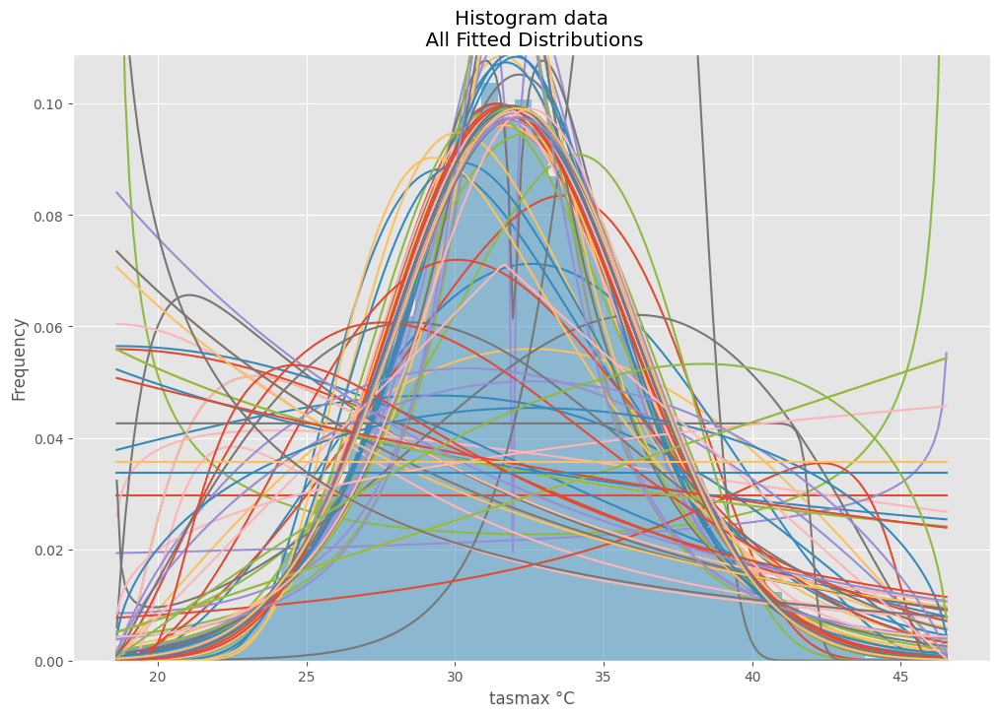

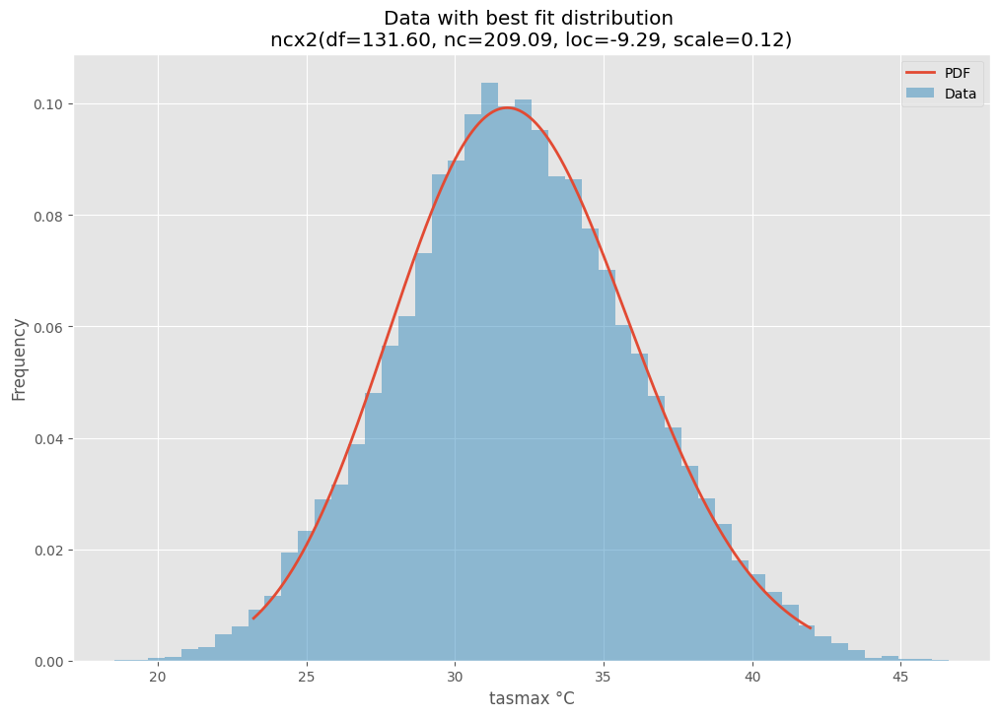

In [53]:
(name_distr,param_distr)=look_best_distr(df_tasmax_NEXGDDPCMIP6_gorongosa_modelACCESS_ssp370['Daily Maximum Near-Surface Air Temperature °C'],'tasmax','°C')

In [54]:
# do for each model, do the mean of all the probability

best distribution nct
params df=339.30, nc=9.12, loc=-1.85, scale=3.60
proba_event_model 0.011253483677238885
proba_event_model registered
best distribution skewnorm
params a=0.58, loc=28.82, scale=3.95
proba_event_model 0.004479487173484342
proba_event_model registered
best distribution powerlognorm
params c=3.84, s=0.20, loc=2.85, scale=33.41
proba_event_model 0.009555447250836901
proba_event_model registered
best distribution exponweib
params a=4.98, c=3.80, loc=2.87, scale=23.76
proba_event_model 0.02112338132617486
proba_event_model registered
best distribution genlogistic
params c=1.79, loc=34.46, scale=3.75
proba_event_model 0.30788301956161
proba_event_model registered
best distribution burr12
params c=13.68, d=1.26, loc=-0.20, scale=31.66
proba_event_model 0.015552843397862559
proba_event_model registered
best distribution skewnorm
params a=1.11, loc=28.65, scale=5.06
proba_event_model 0.024819417629949436
proba_event_model registered
best distribution skewnorm
params a=0.94, 

<Figure size 1200x800 with 0 Axes>

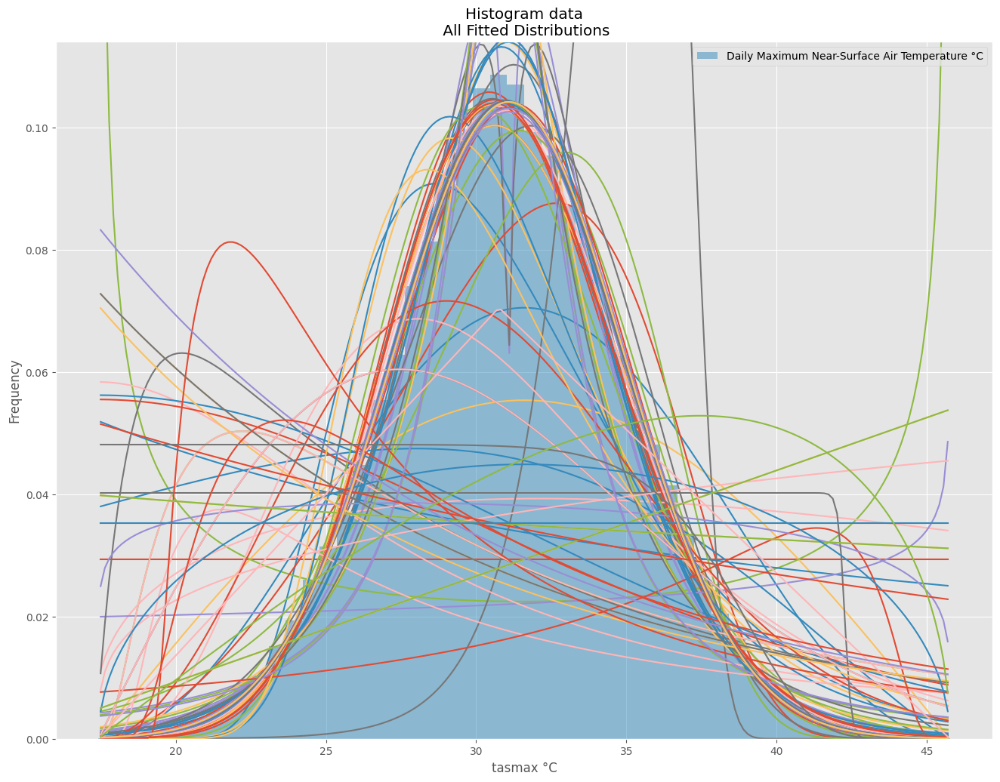

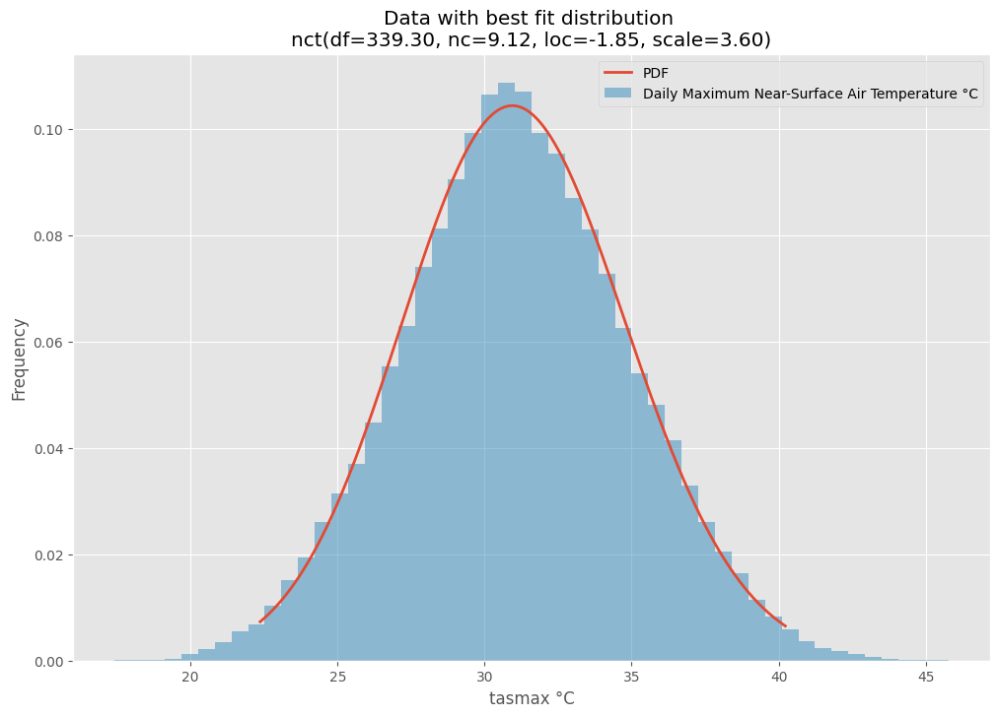

<Figure size 1200x800 with 0 Axes>

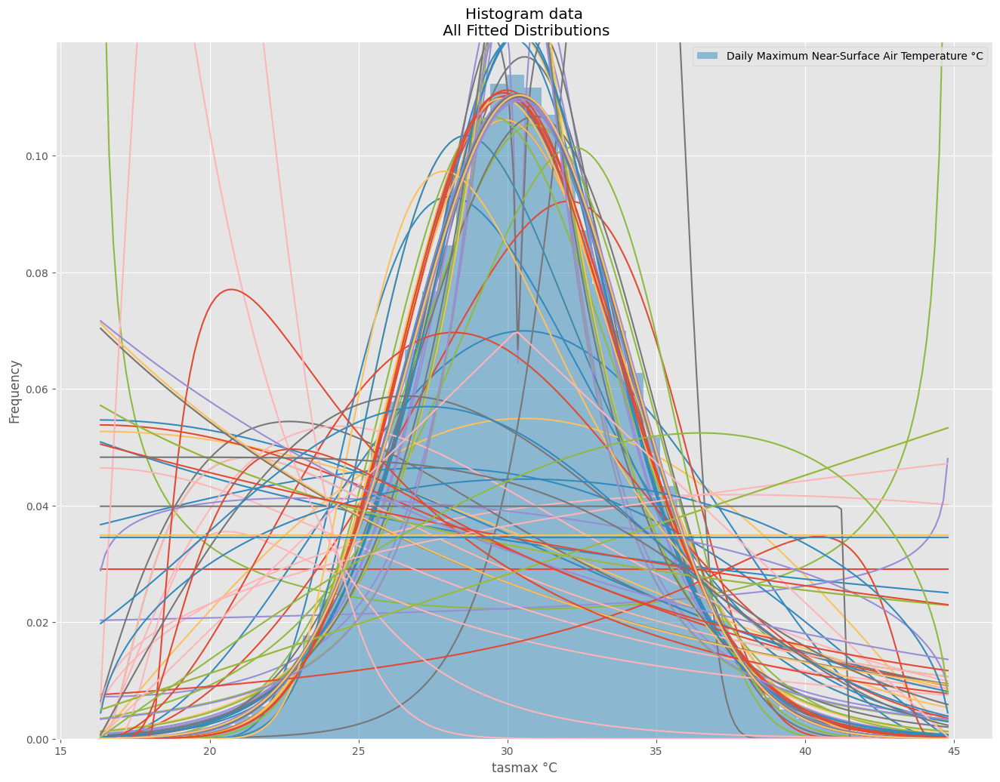

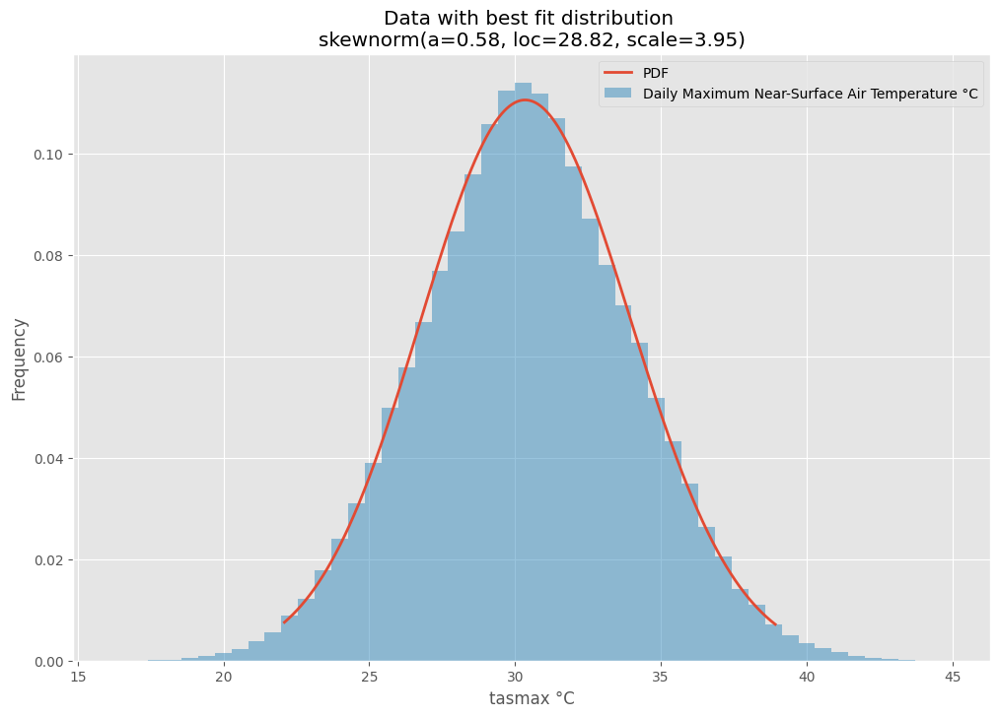

<Figure size 1200x800 with 0 Axes>

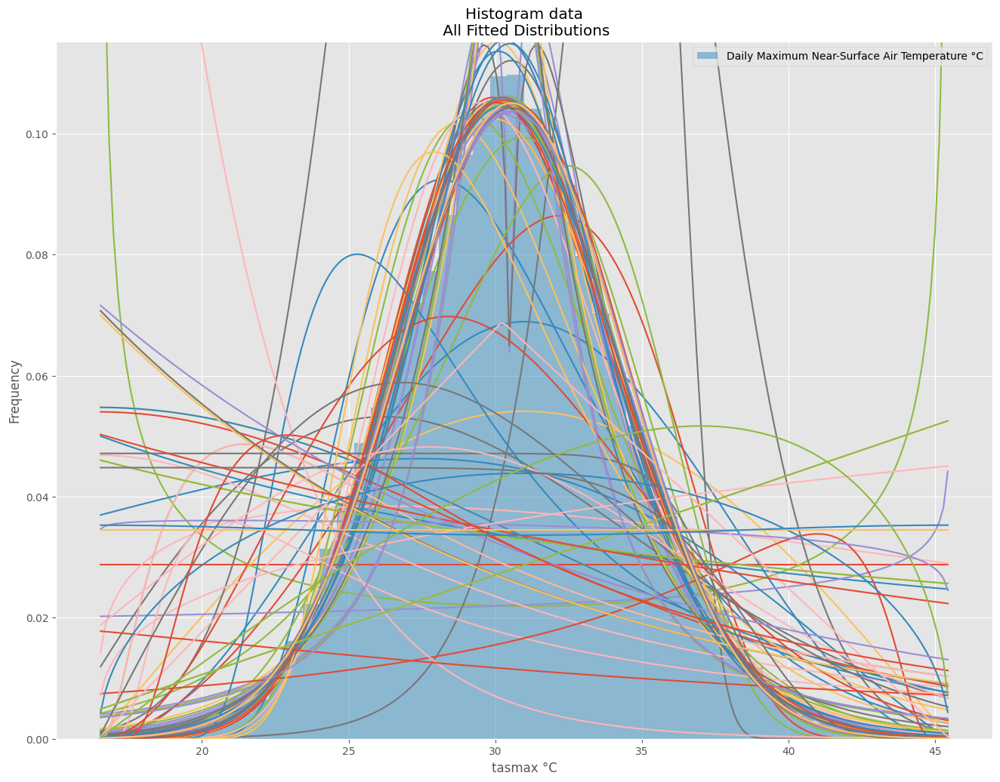

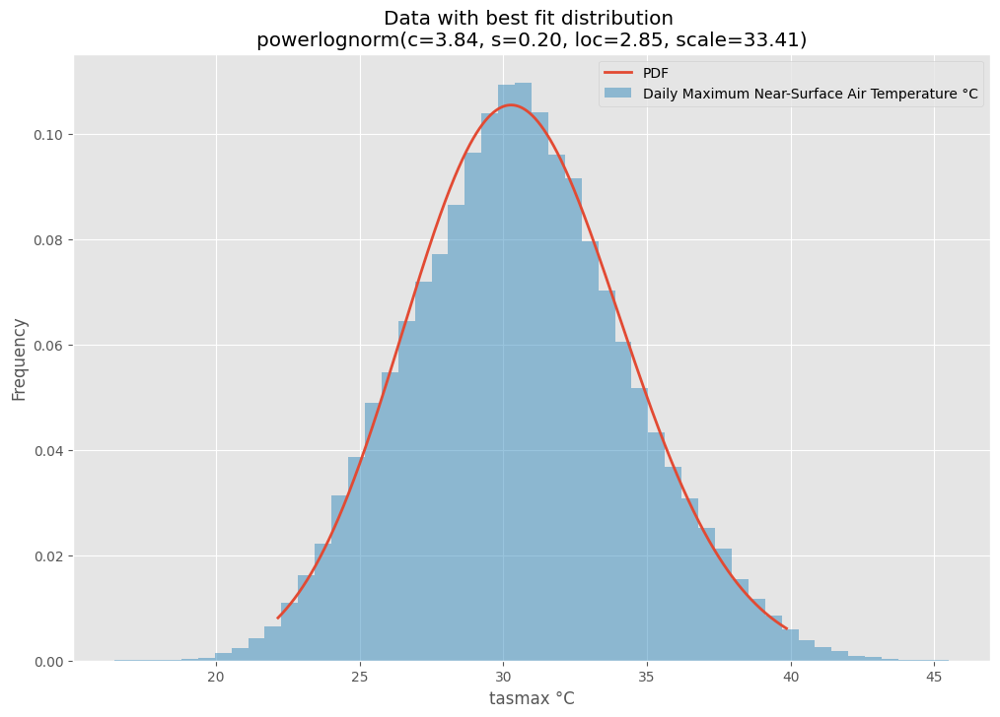

<Figure size 1200x800 with 0 Axes>

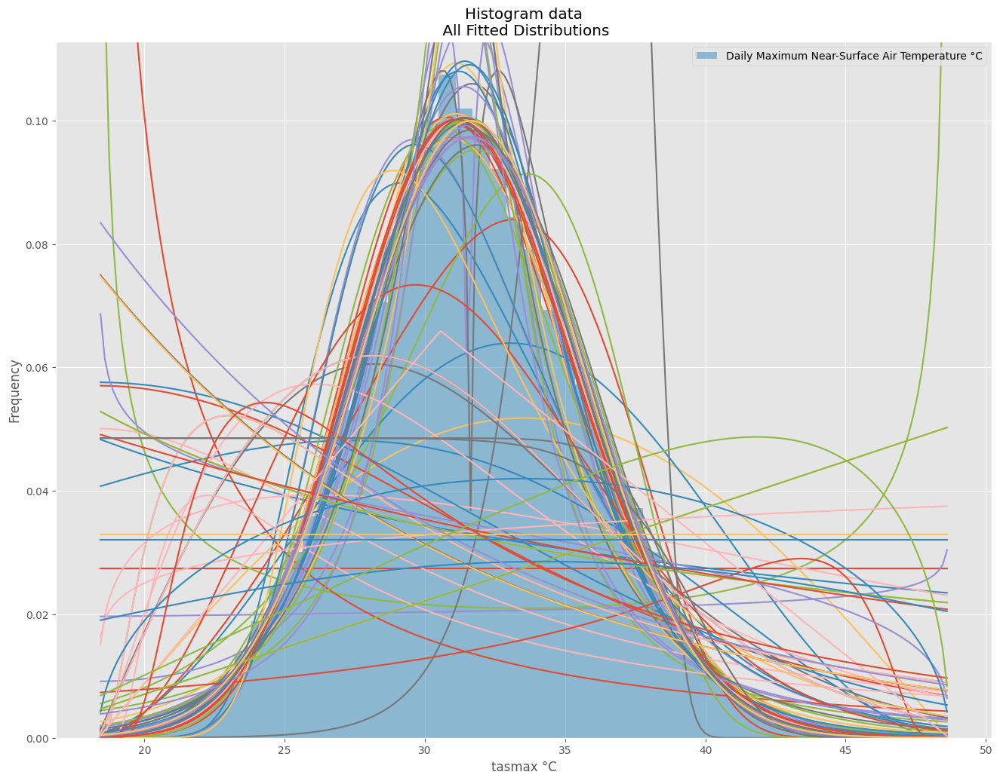

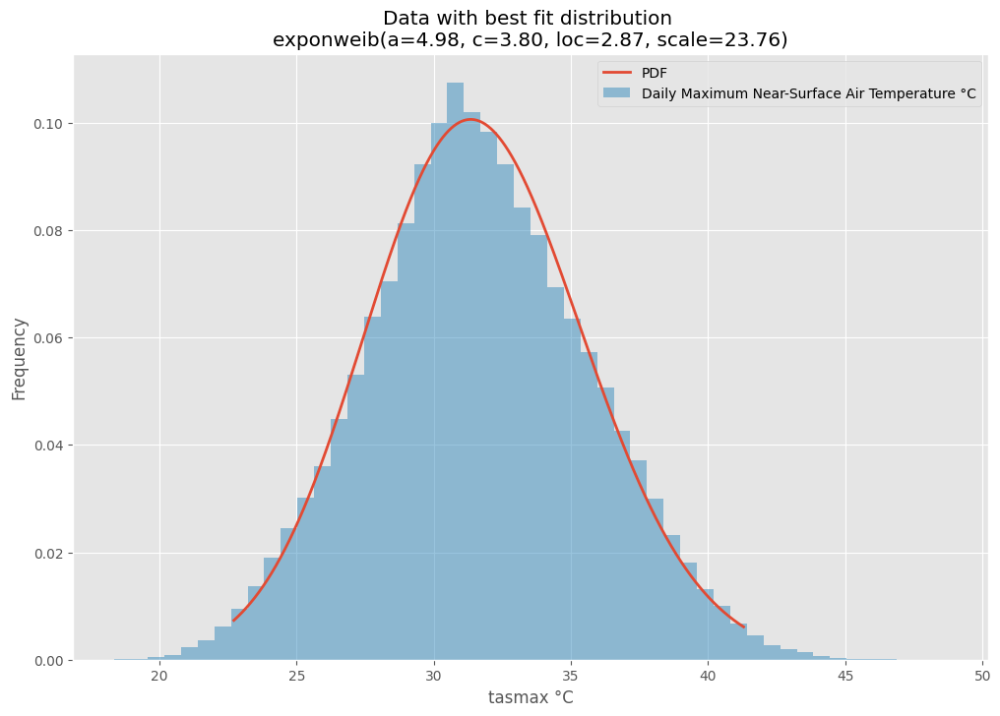

<Figure size 1200x800 with 0 Axes>

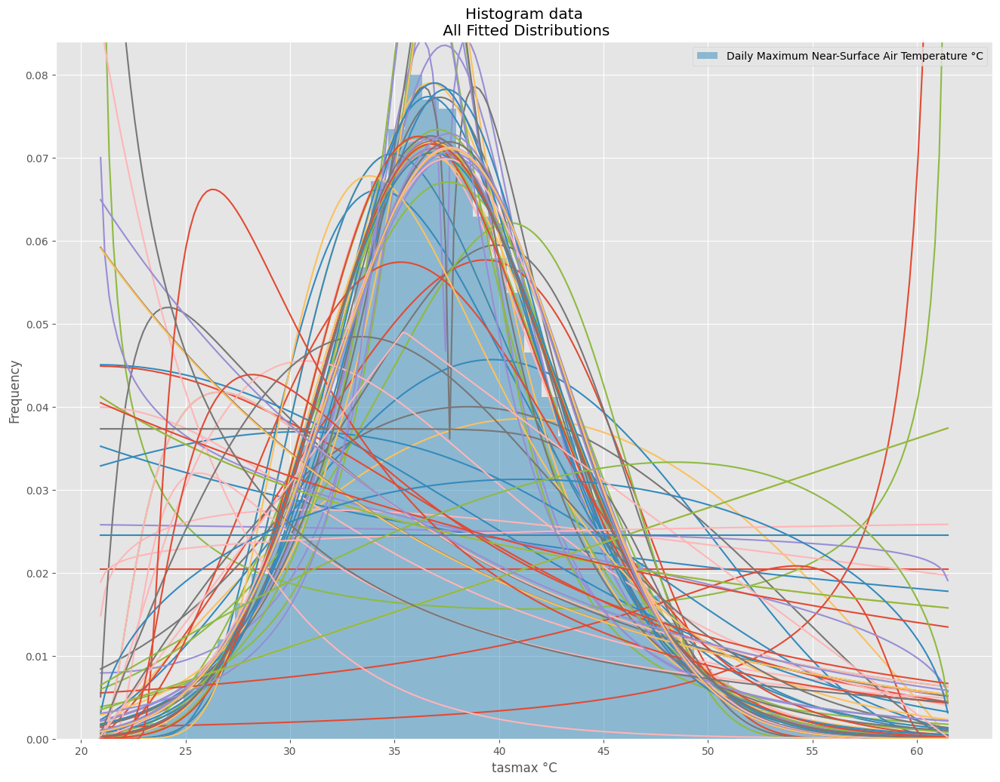

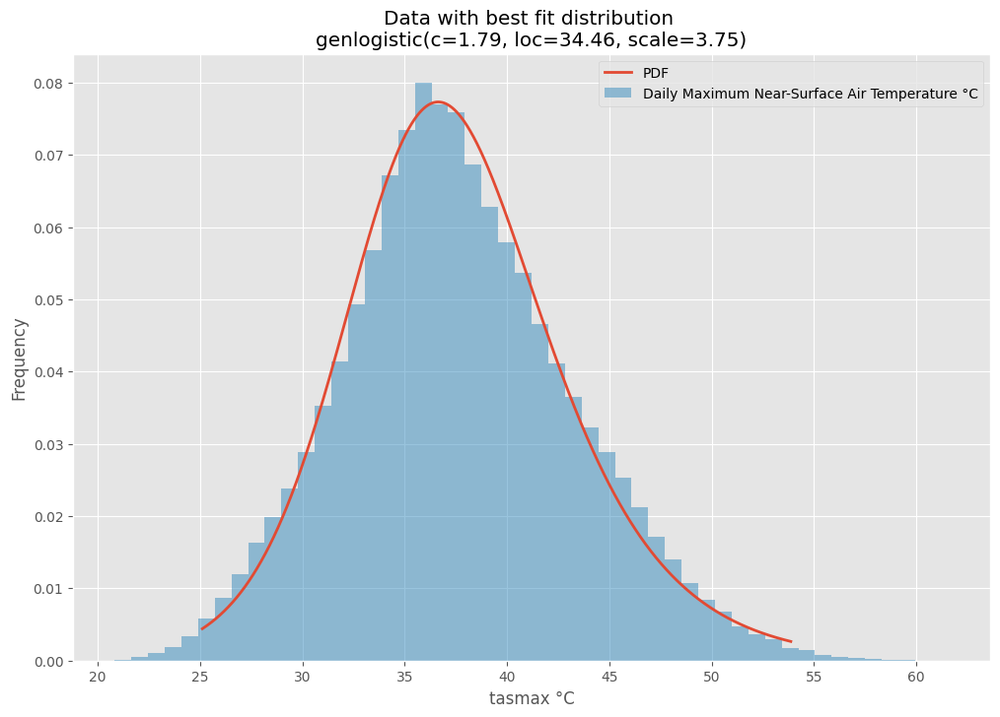

<Figure size 1200x800 with 0 Axes>

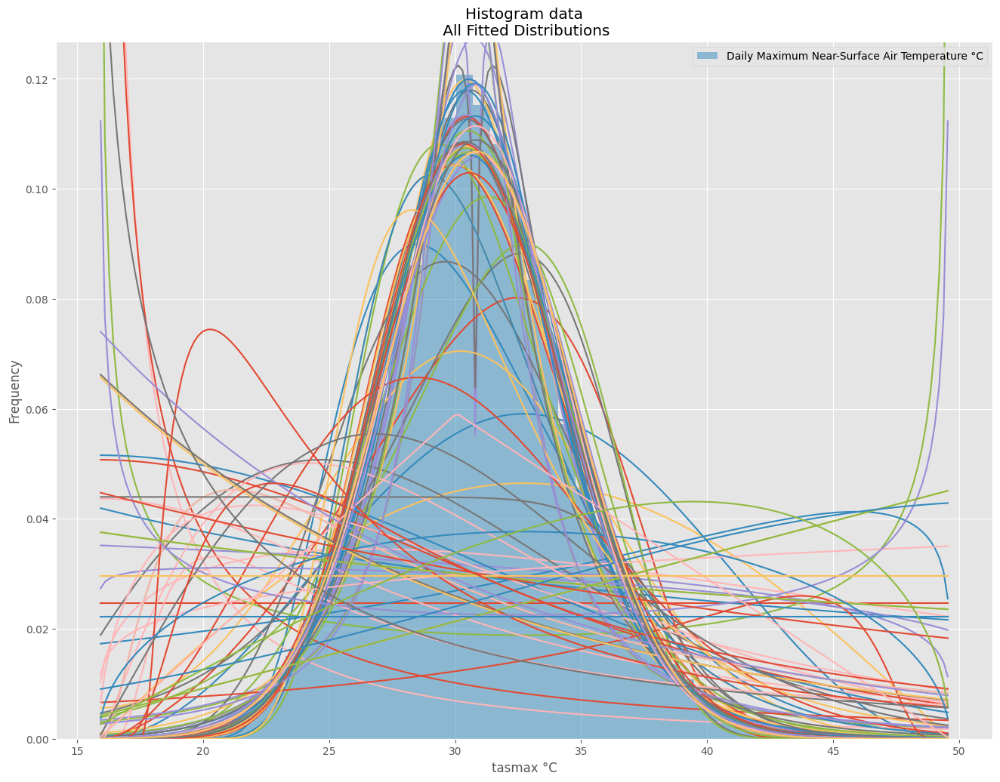

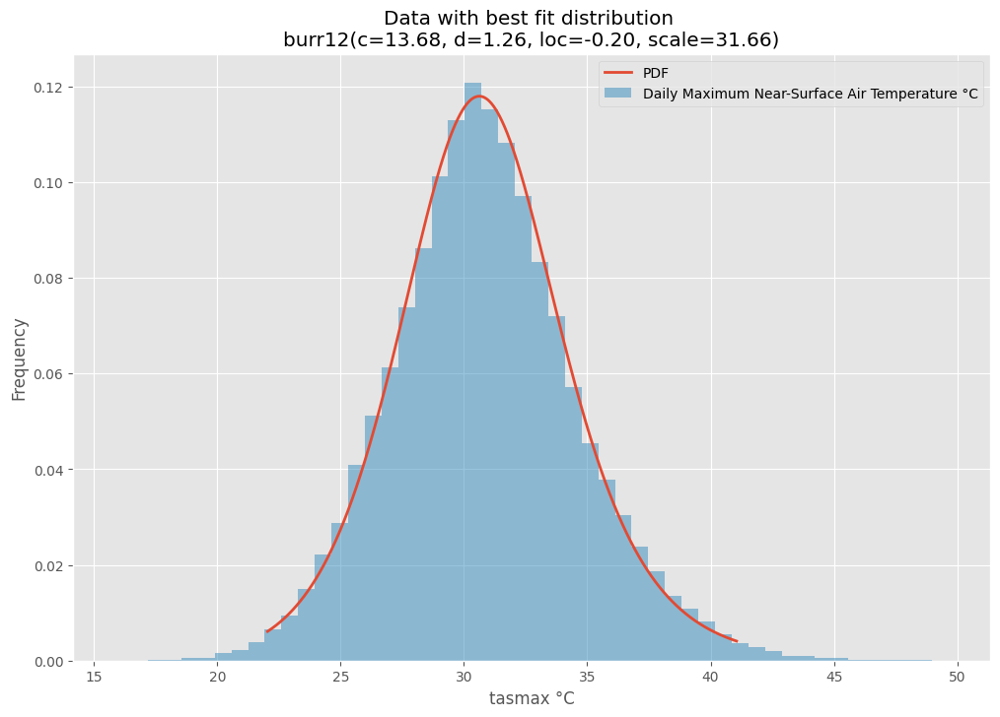

<Figure size 1200x800 with 0 Axes>

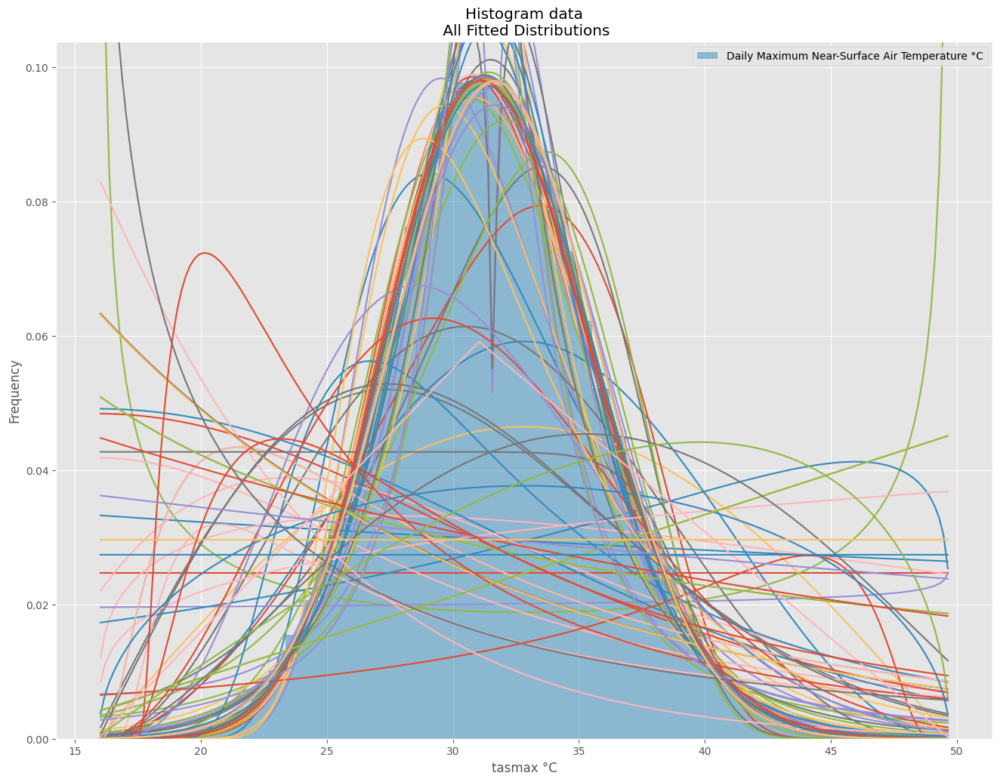

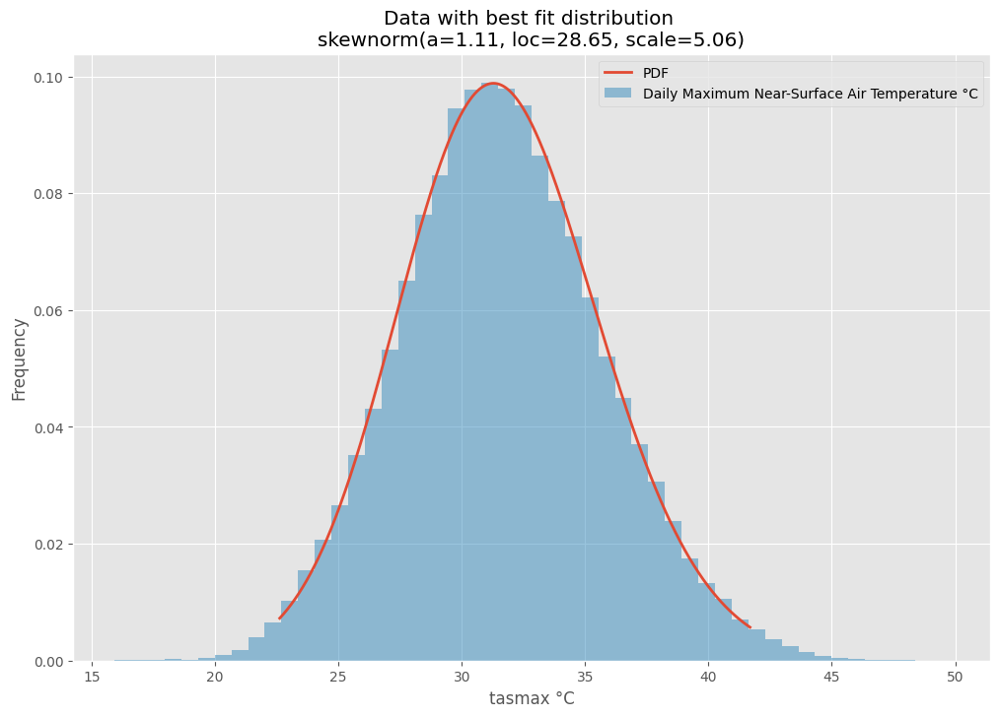

<Figure size 1200x800 with 0 Axes>

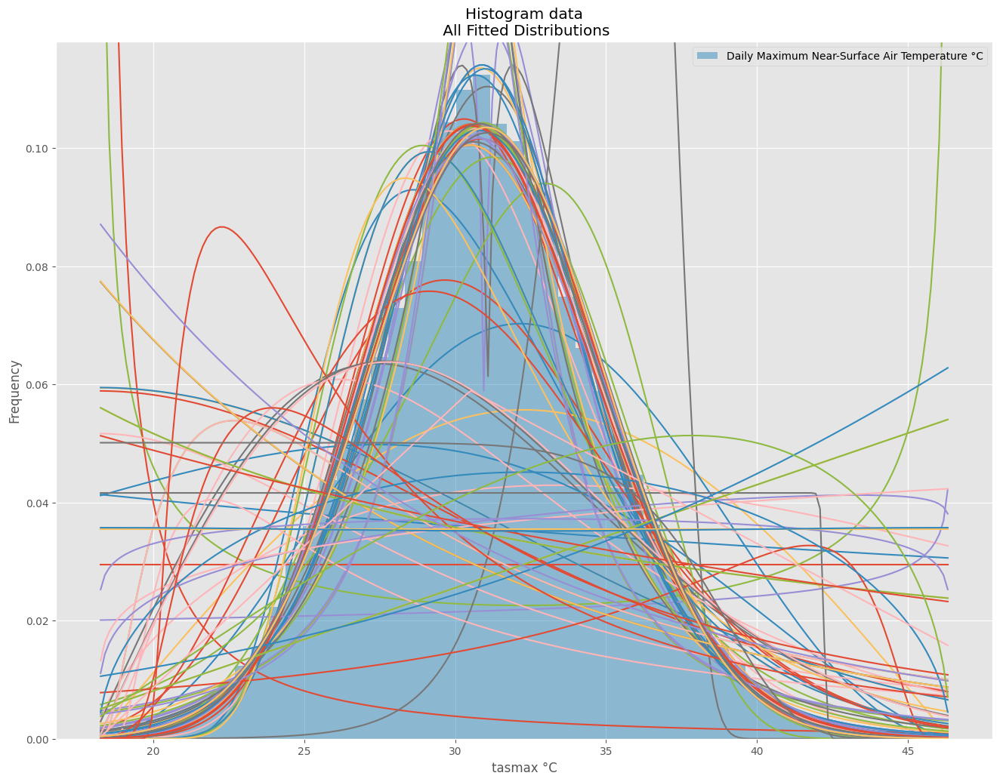

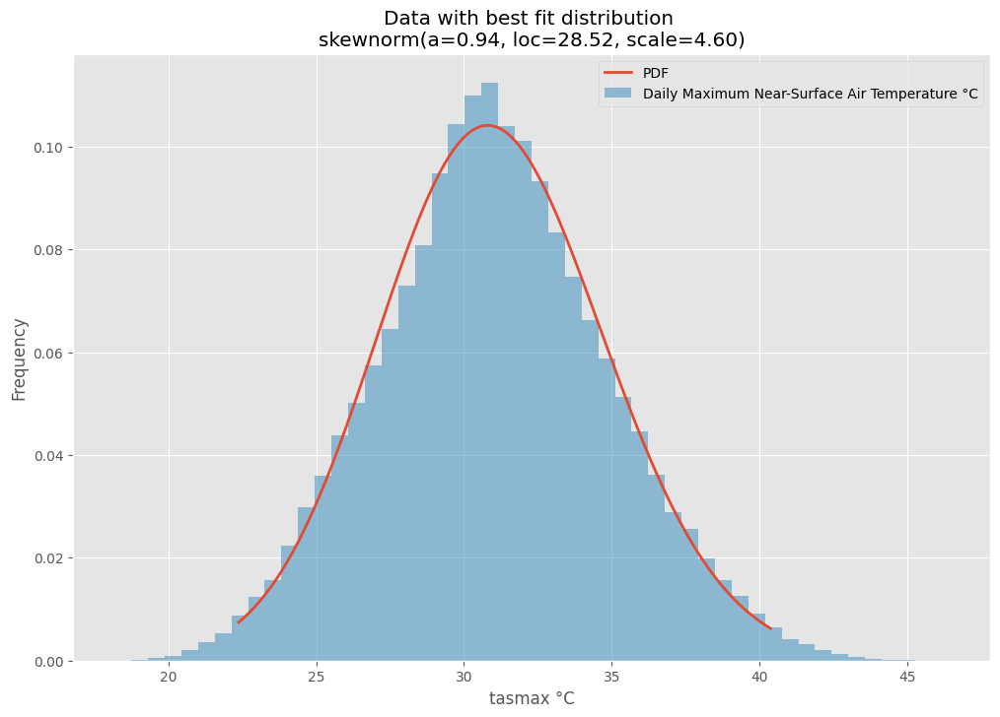

<Figure size 1200x800 with 0 Axes>

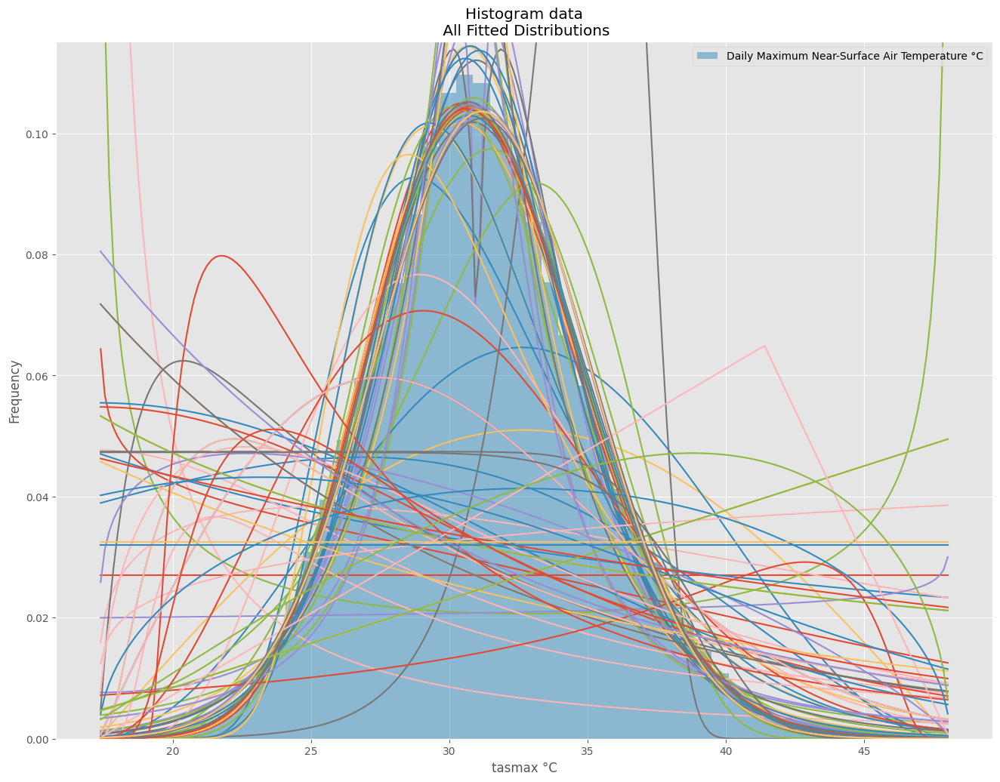

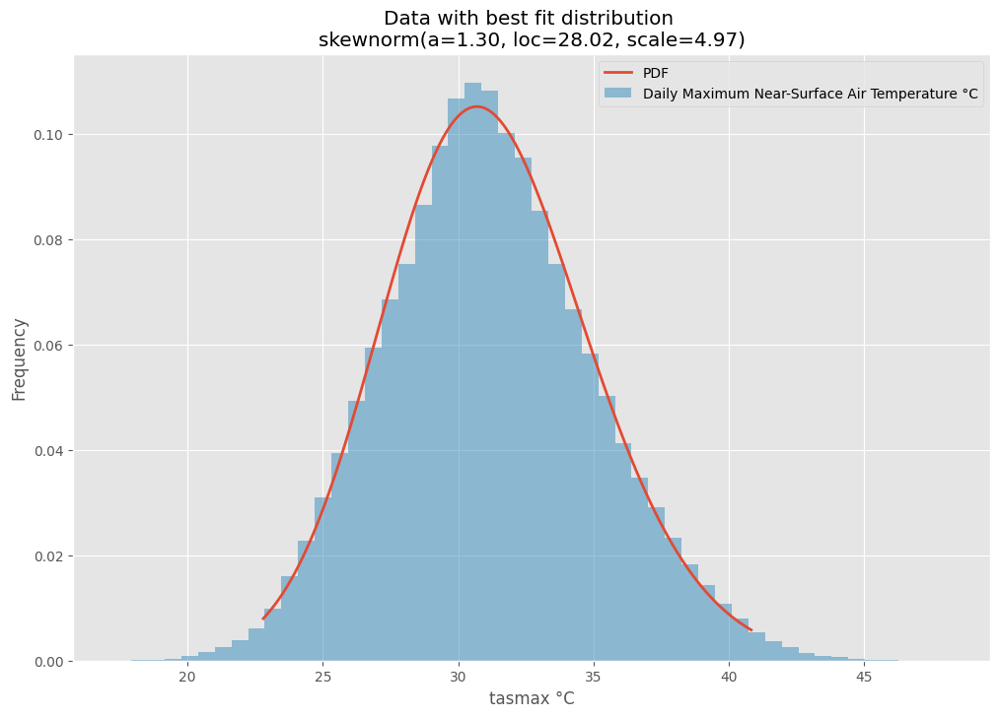

<Figure size 1200x800 with 0 Axes>

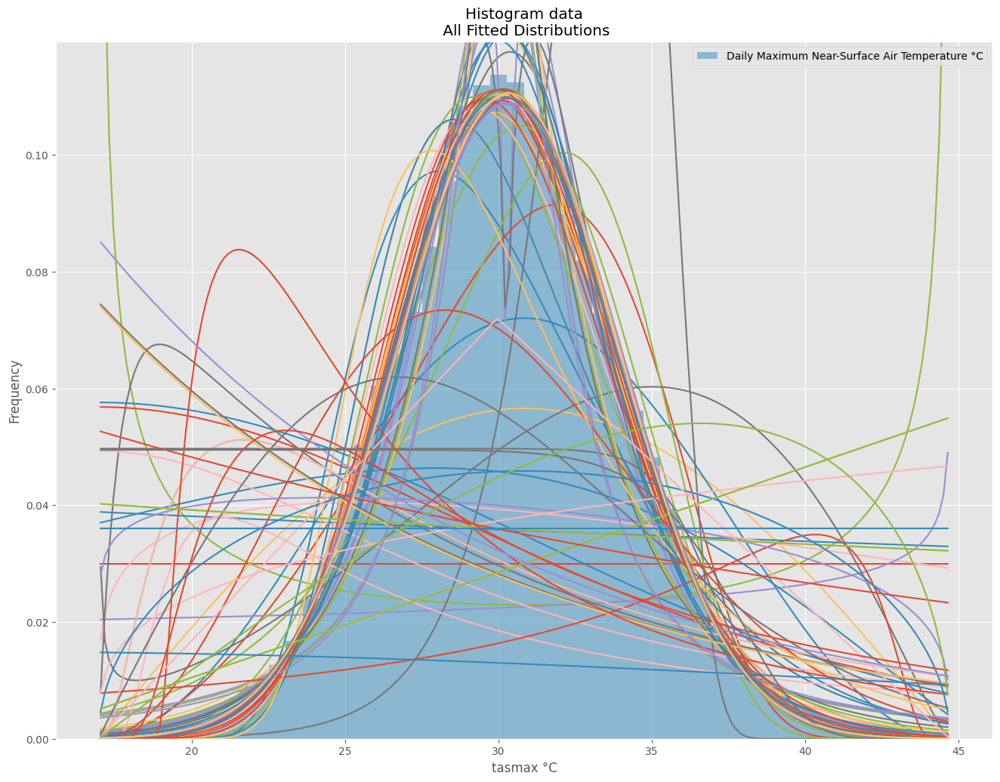

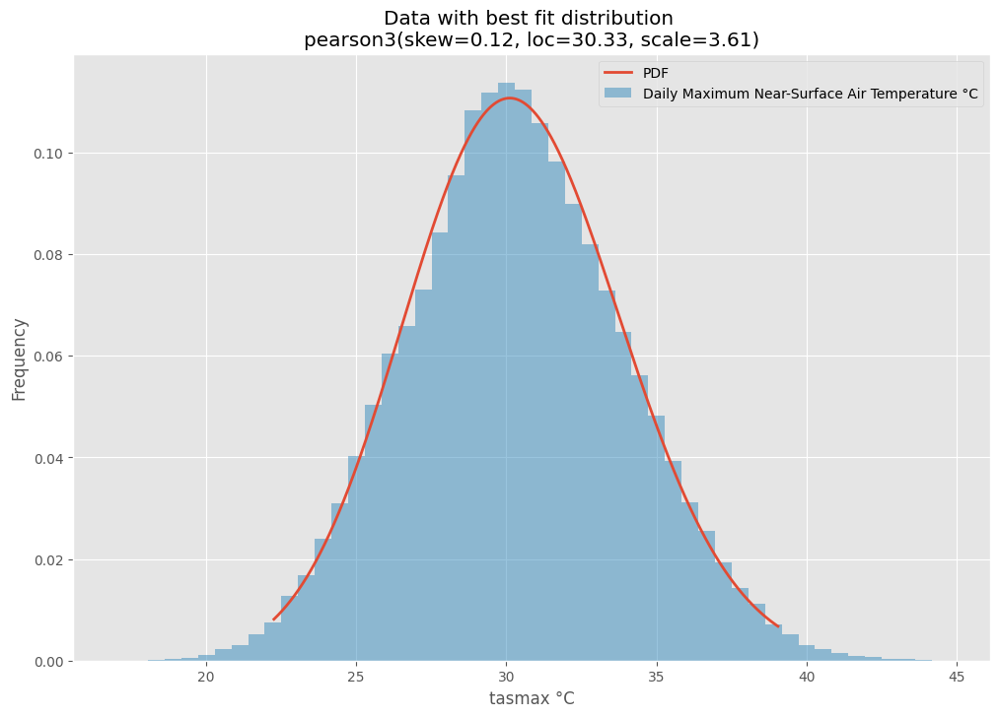

<Figure size 1200x800 with 0 Axes>

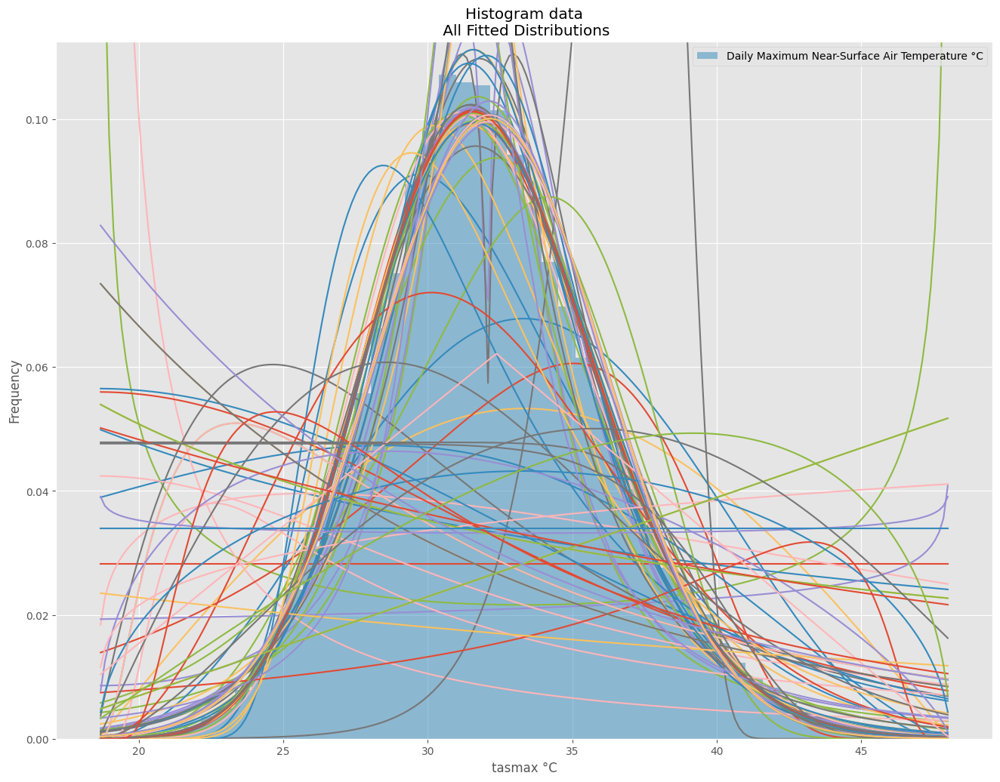

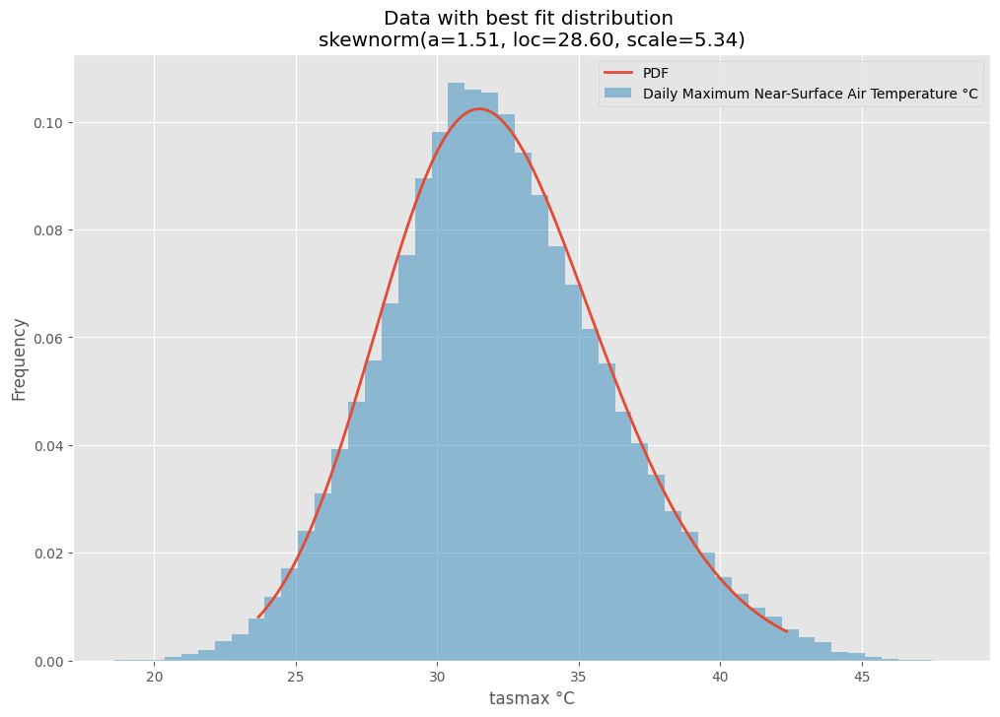

<Figure size 1200x800 with 0 Axes>

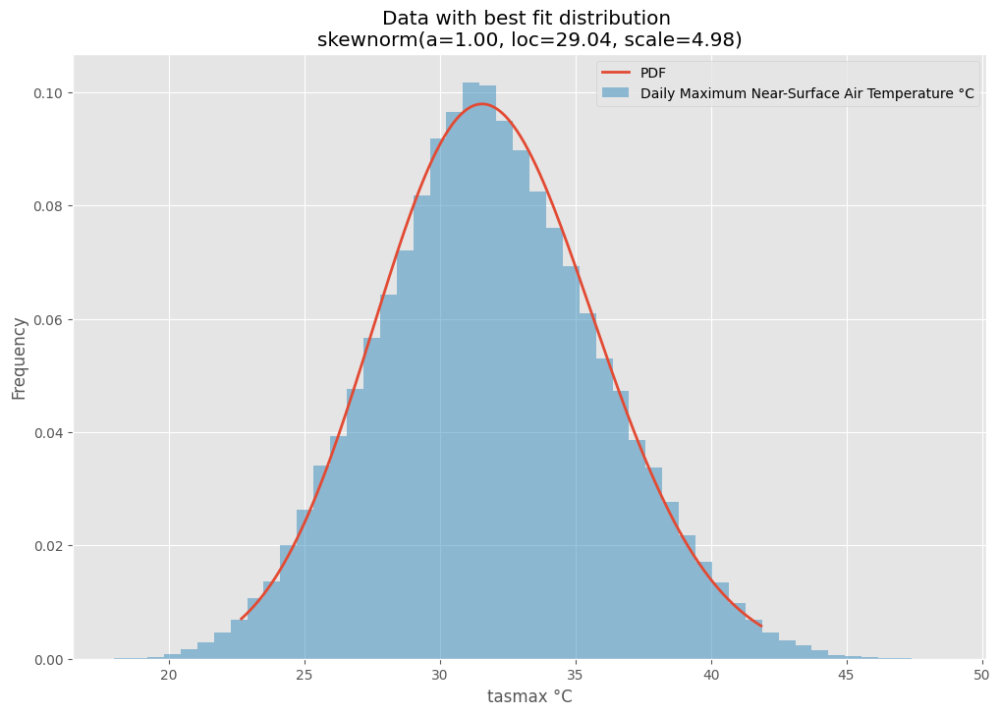

<Figure size 1200x800 with 0 Axes>

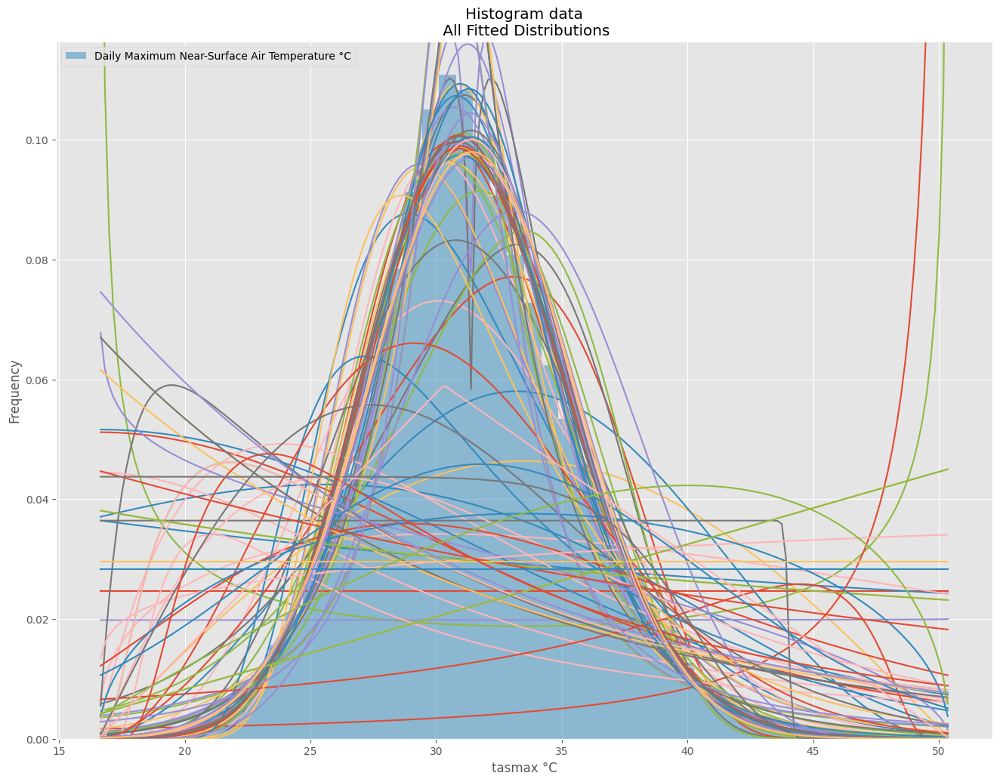

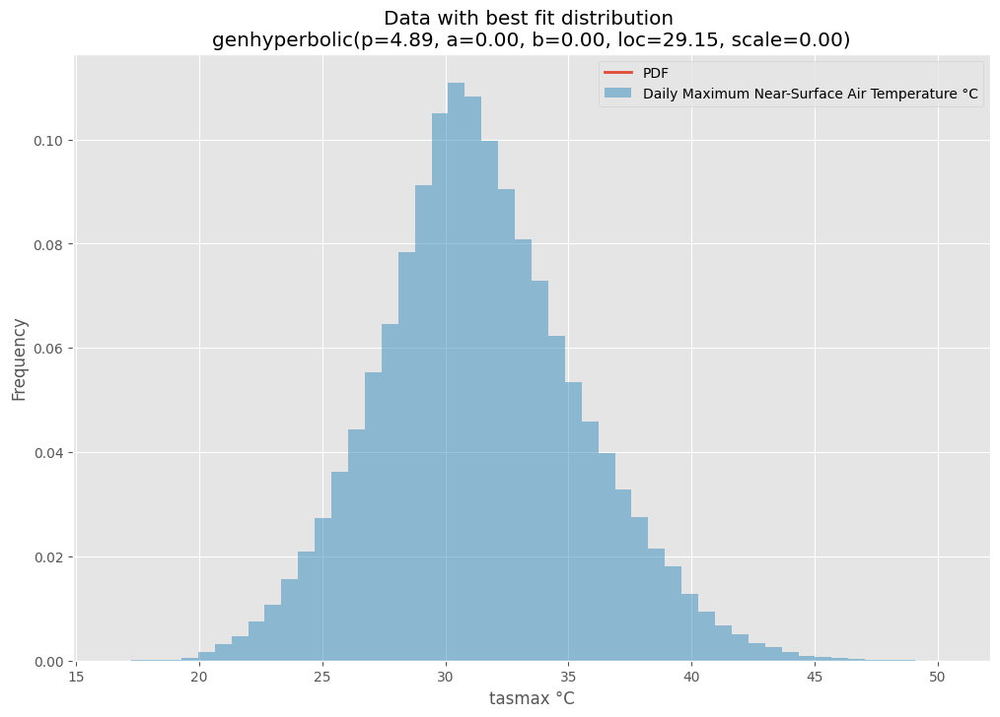

In [60]:
# probability with BC corrected data at Gorongosa
(proba_event_accross_model_gorongosa_BC,likelihood_gorongosa_BC)=likelihood_accross_models(df_tasmax_NEXGDDPCMIP6_BC_future[df_tasmax_NEXGDDPCMIP6_BC_future['Name project']=='Gorongosa_EIB'].dropna(),'tasmax','°C','Daily Maximum Near-Surface Air Temperature °C',40,'>')

best distribution dweibull
params c=1.36, loc=30.67, scale=0.72
proba_event_model 3.552713678800501e-15
proba_event_model registered
best distribution triang
params c=0.53, loc=28.19, scale=3.69
proba_event_model 0.0
proba_event_model registered
best distribution exponnorm
params K=0.63, loc=29.99, scale=0.45
proba_event_model 1.6653345369377348e-15
proba_event_model registered
best distribution genhyperbolic
params p=2.72, a=0.01, b=0.00, loc=30.36, scale=0.00
proba_event_model nan
best distribution fisk
params c=14.38, loc=28.17, scale=8.79
proba_event_model 0.013772616439881258
proba_event_model registered
best distribution dgamma
params a=1.91, loc=30.65, scale=0.35
proba_event_model 2.6626256754980204e-11
proba_event_model registered
best distribution beta
params a=10.60, b=17.61, loc=27.18, scale=10.92
proba_event_model 0.0
proba_event_model registered
best distribution laplace_asymmetric
params kappa=0.86, loc=30.52, scale=0.64
proba_event_model 1.687259063243296e-06
proba_event

<Figure size 1200x800 with 0 Axes>

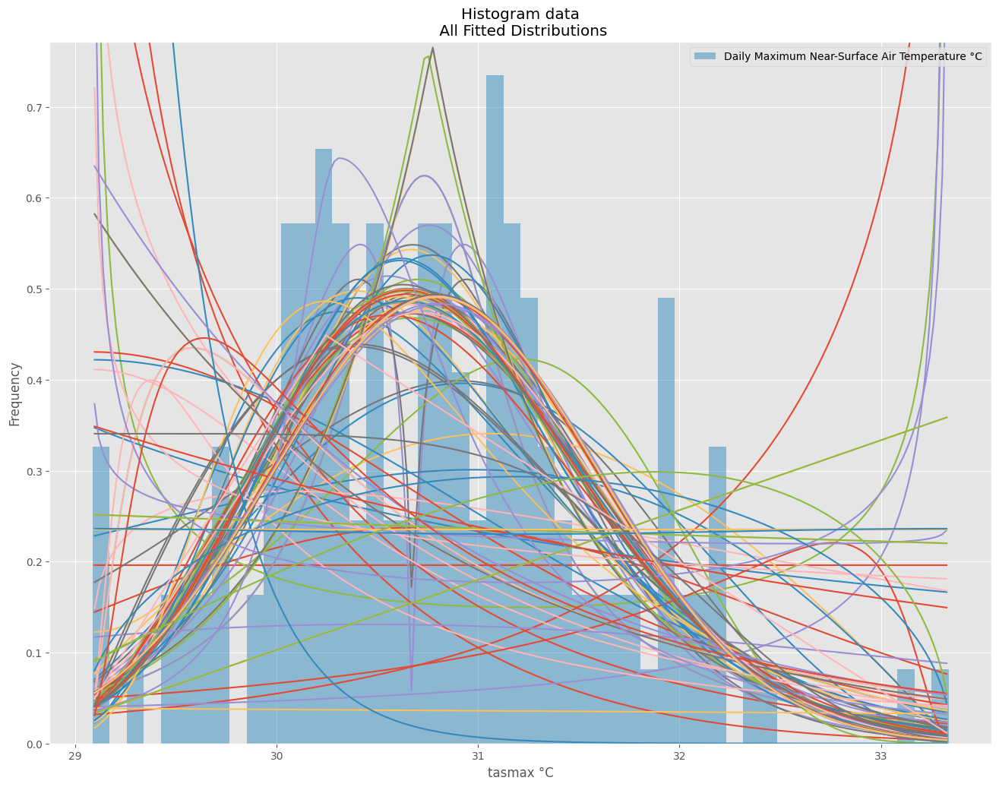

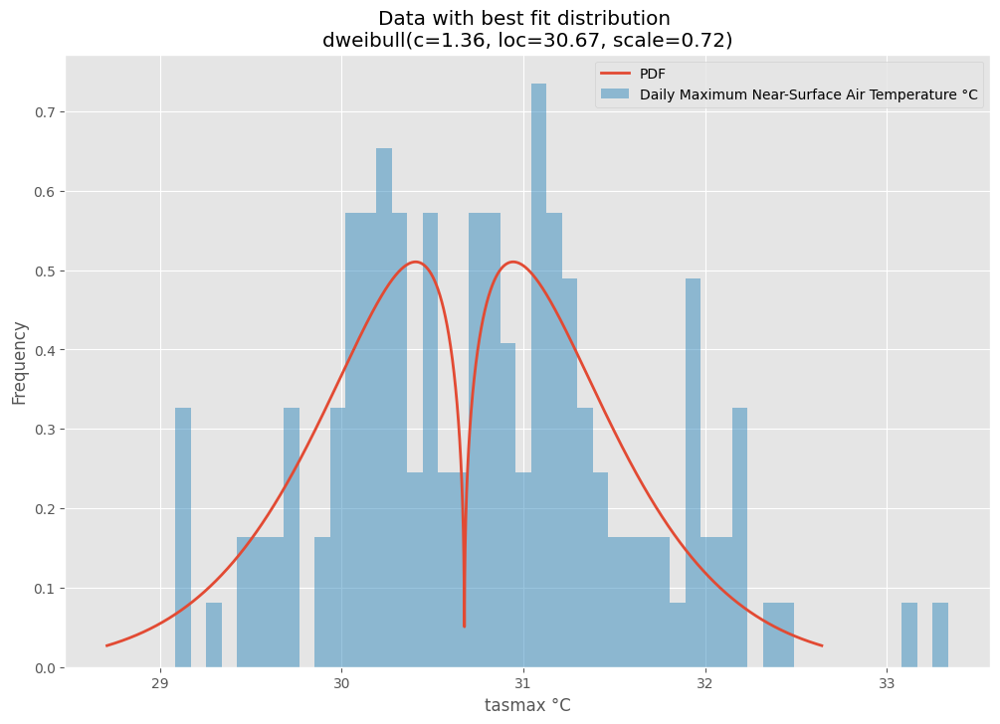

<Figure size 1200x800 with 0 Axes>

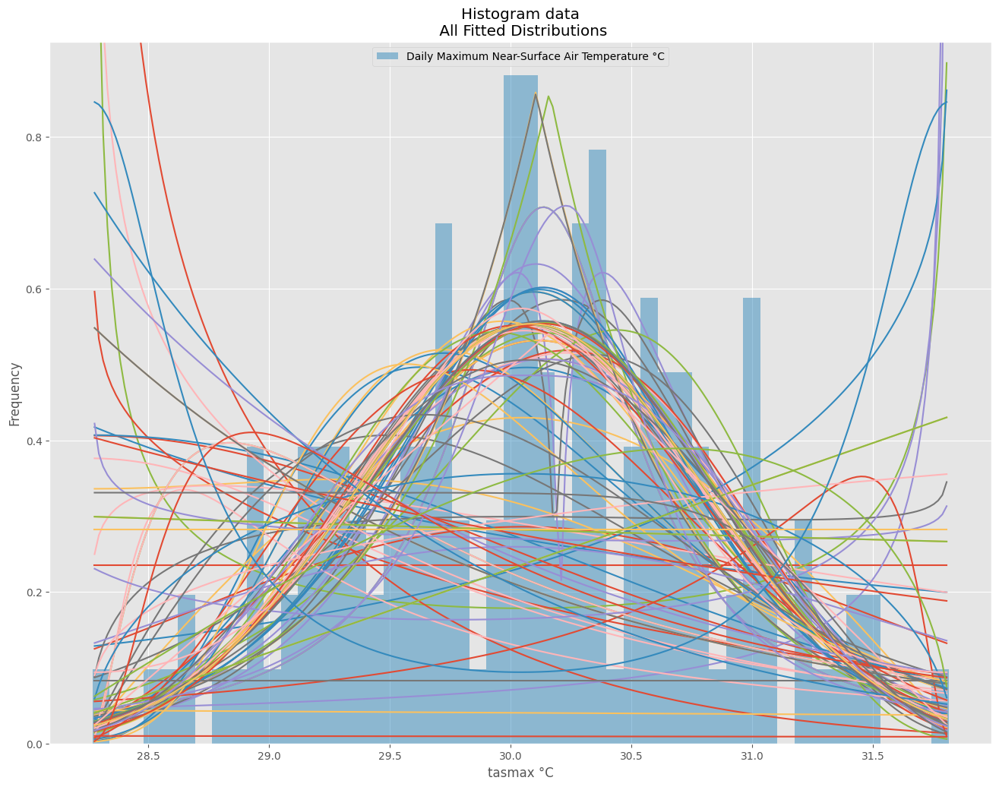

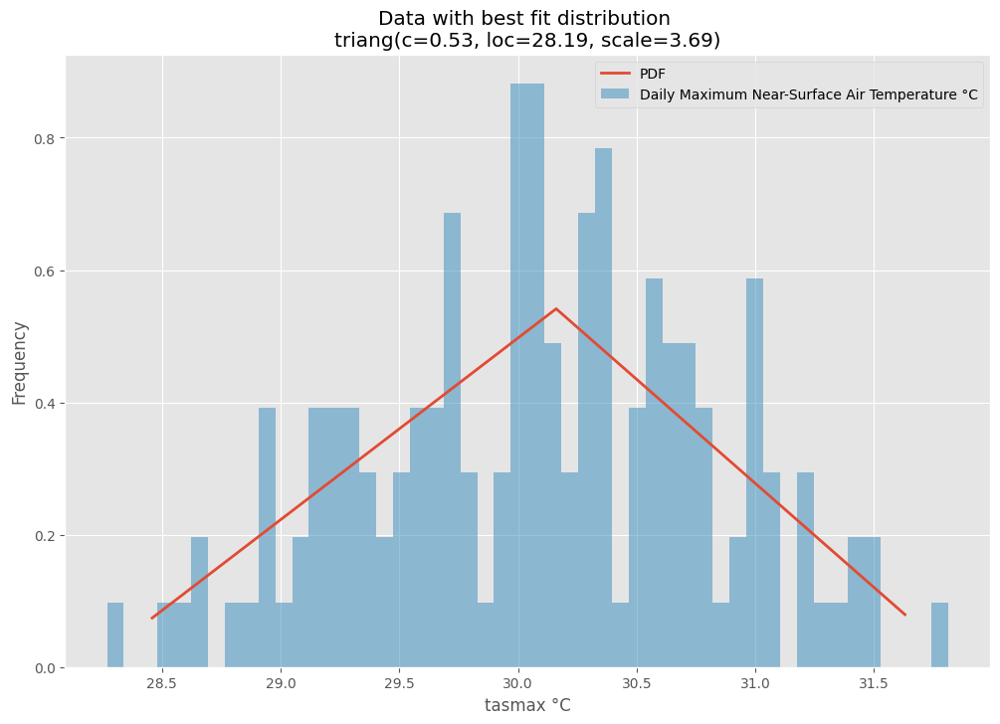

<Figure size 1200x800 with 0 Axes>

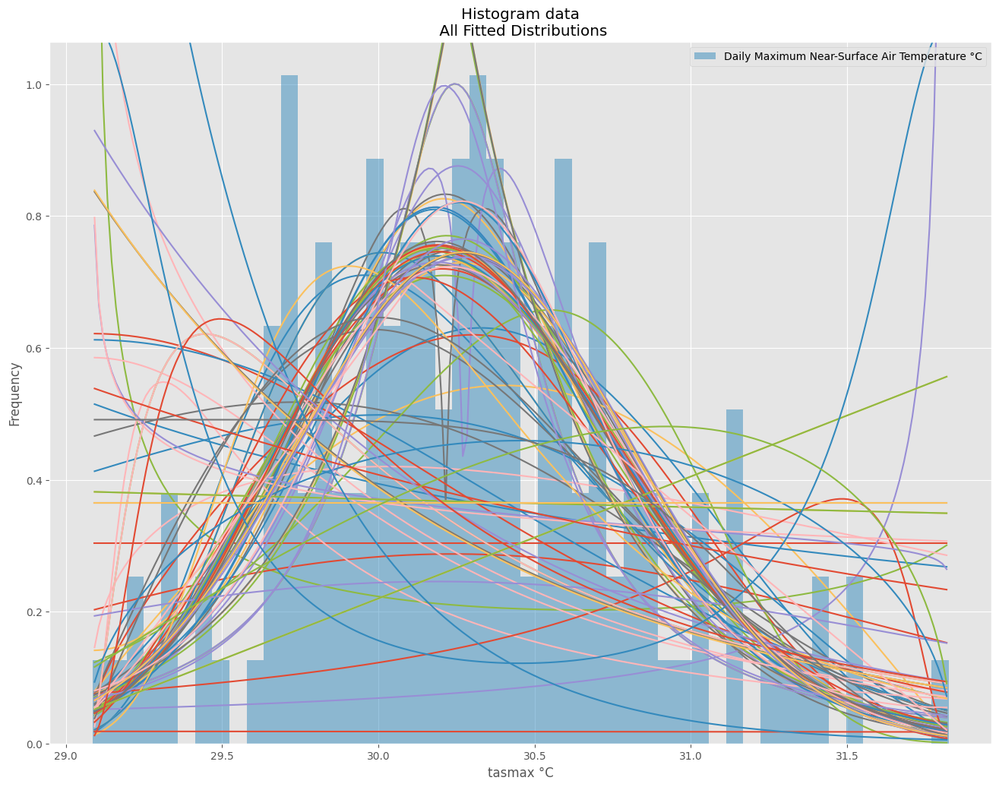

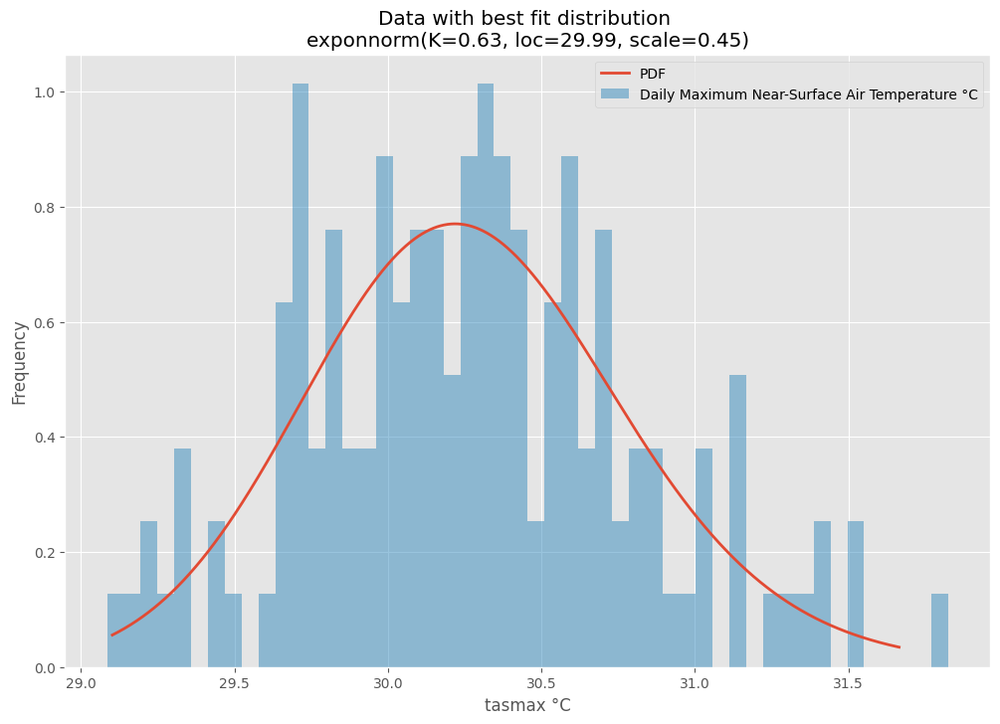

<Figure size 1200x800 with 0 Axes>

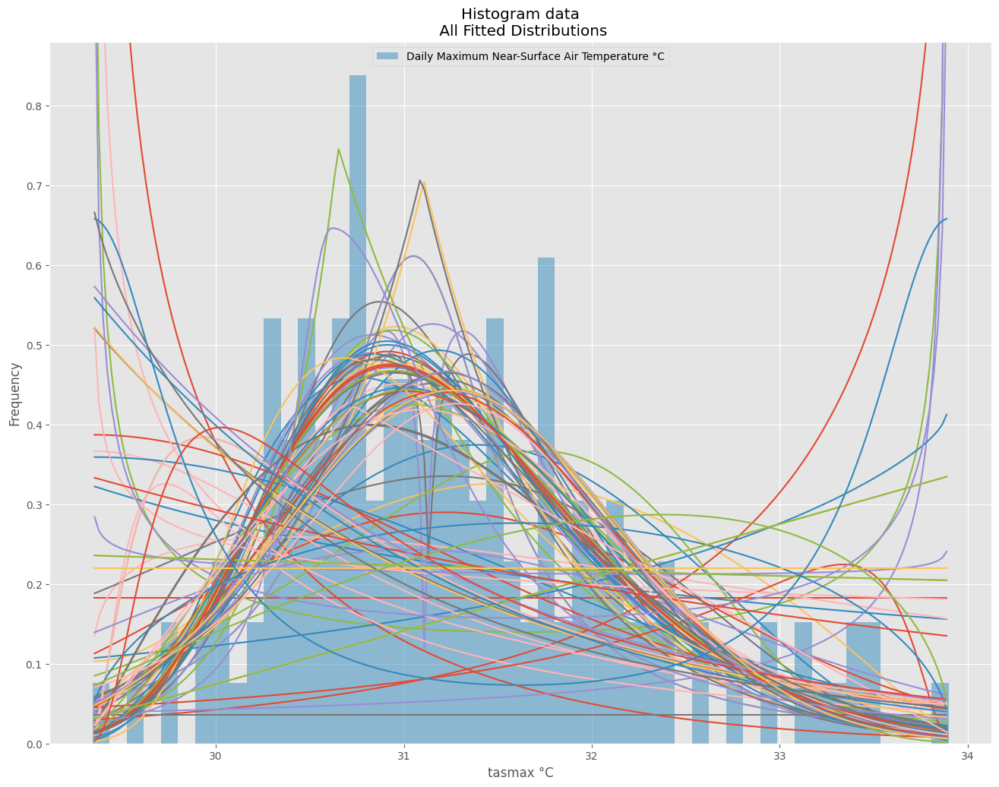

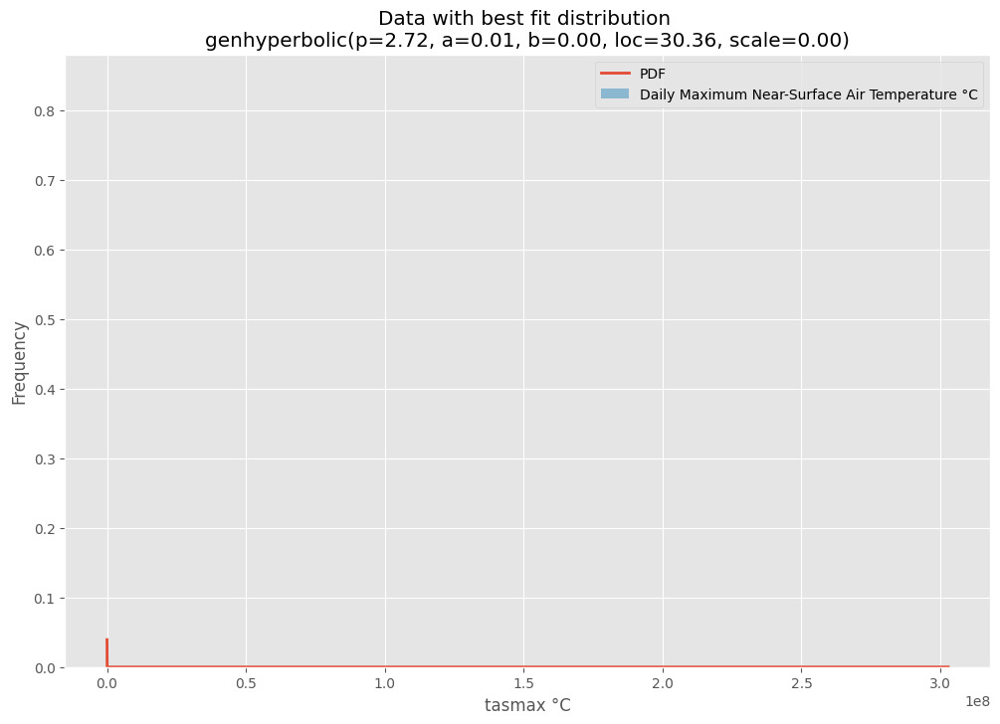

<Figure size 1200x800 with 0 Axes>

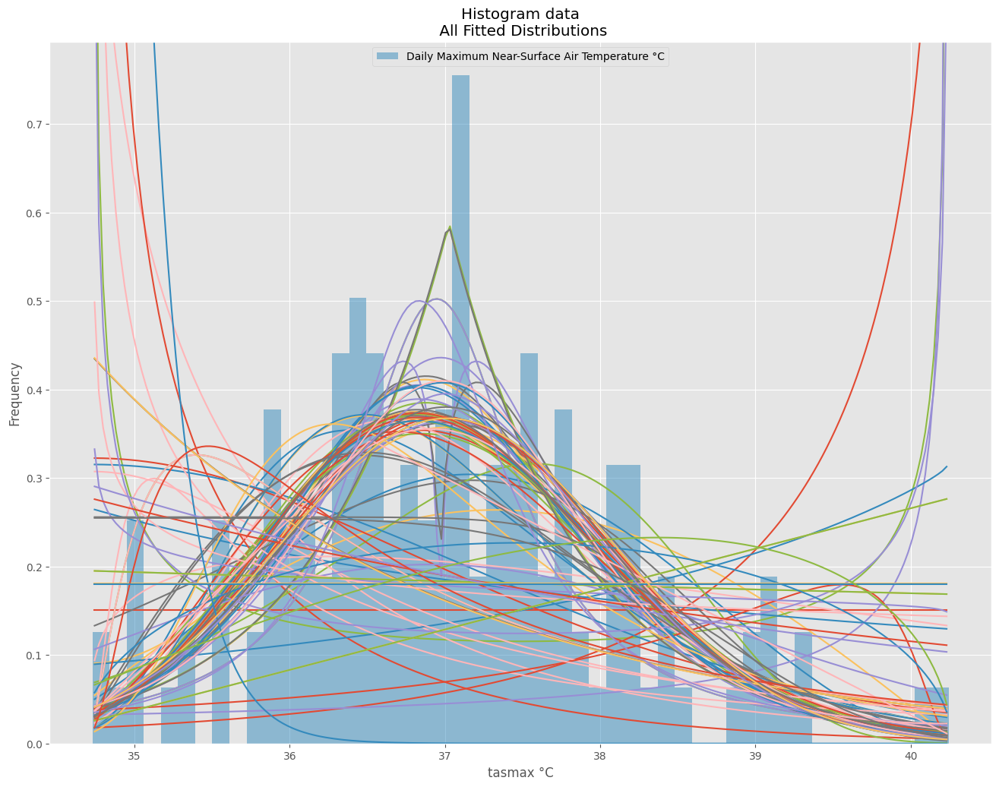

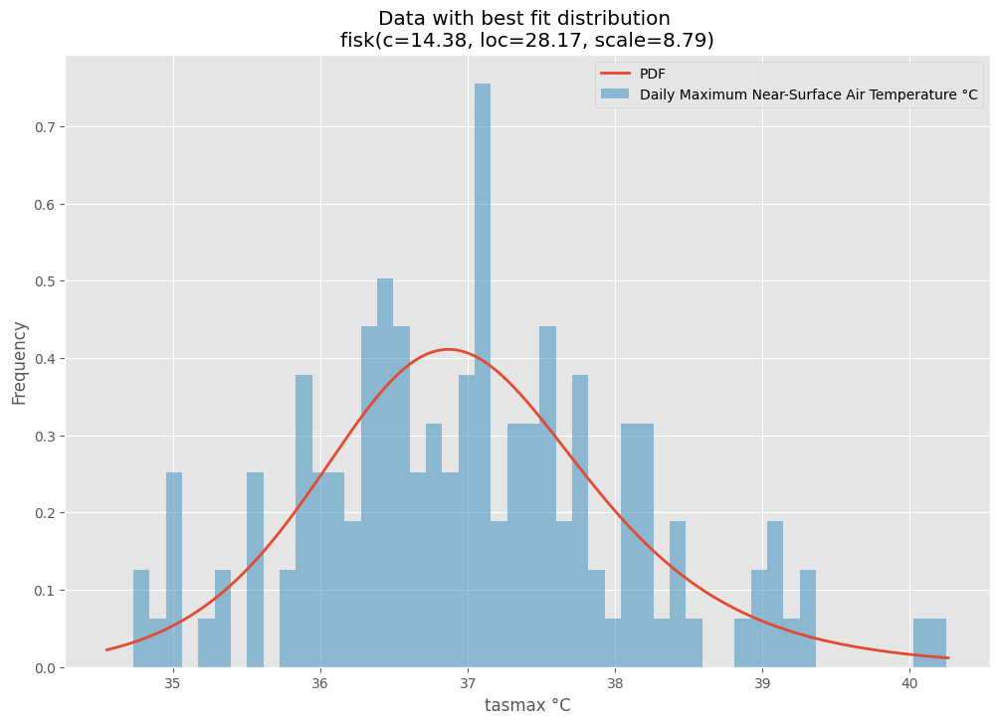

<Figure size 1200x800 with 0 Axes>

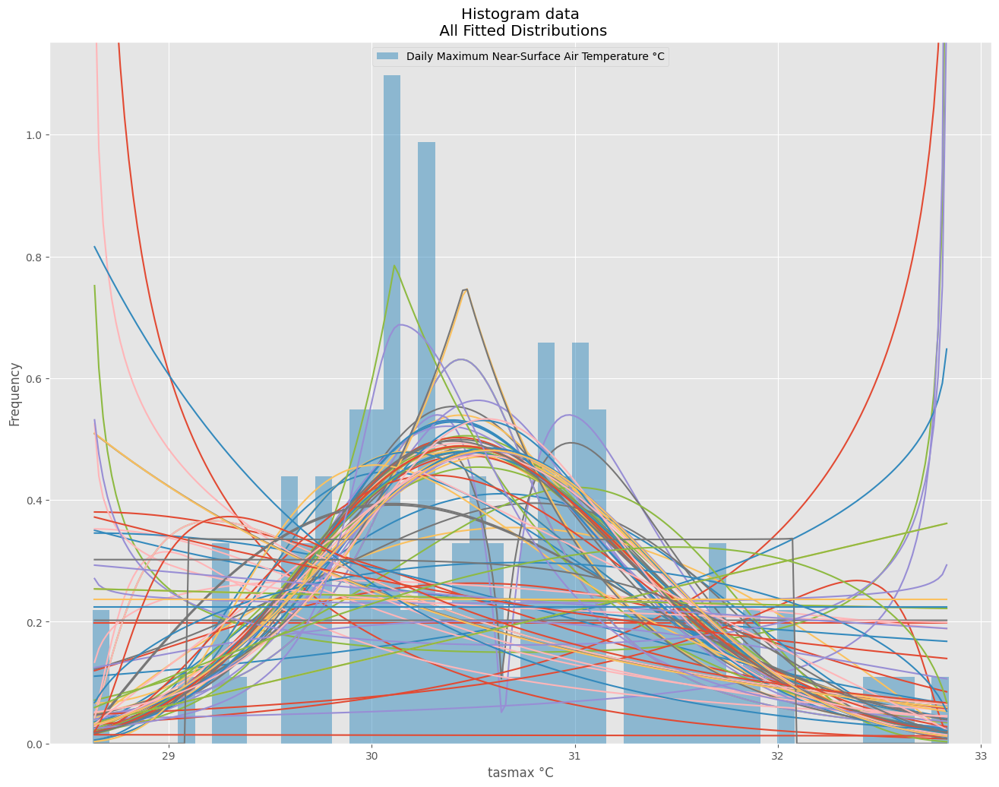

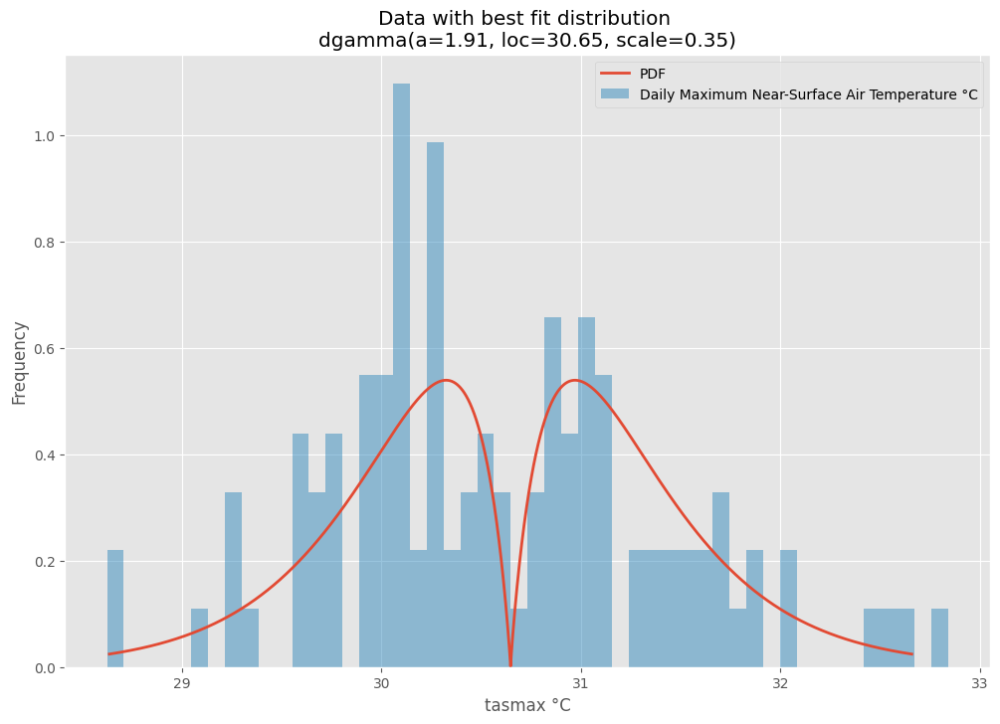

<Figure size 1200x800 with 0 Axes>

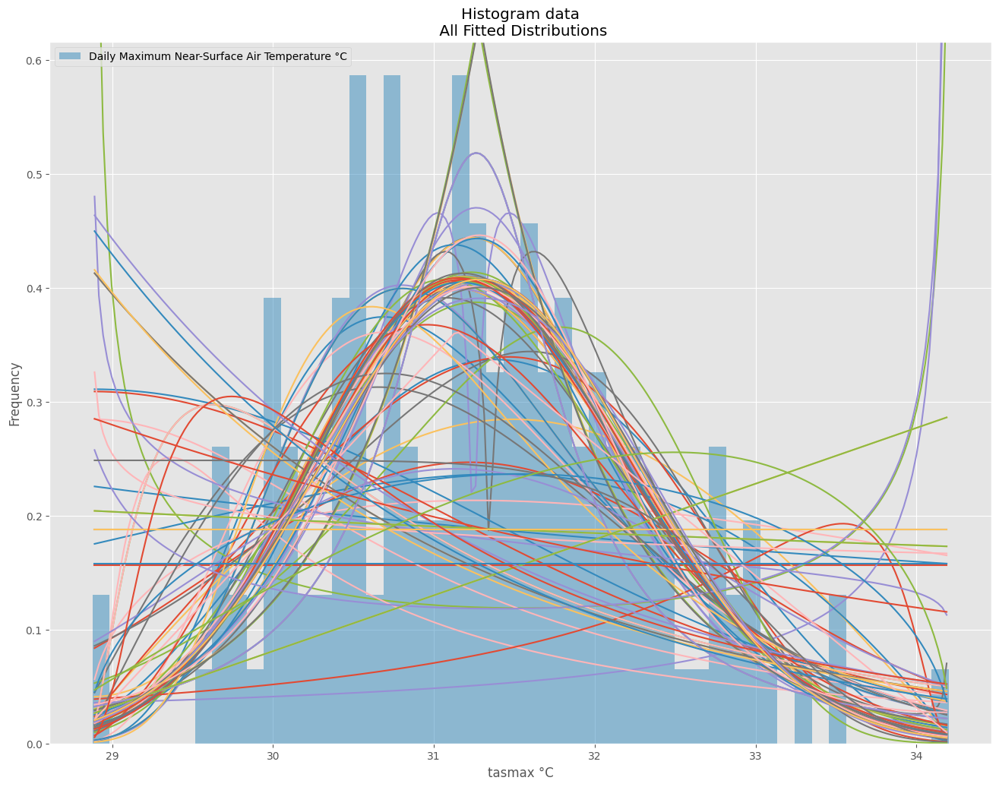

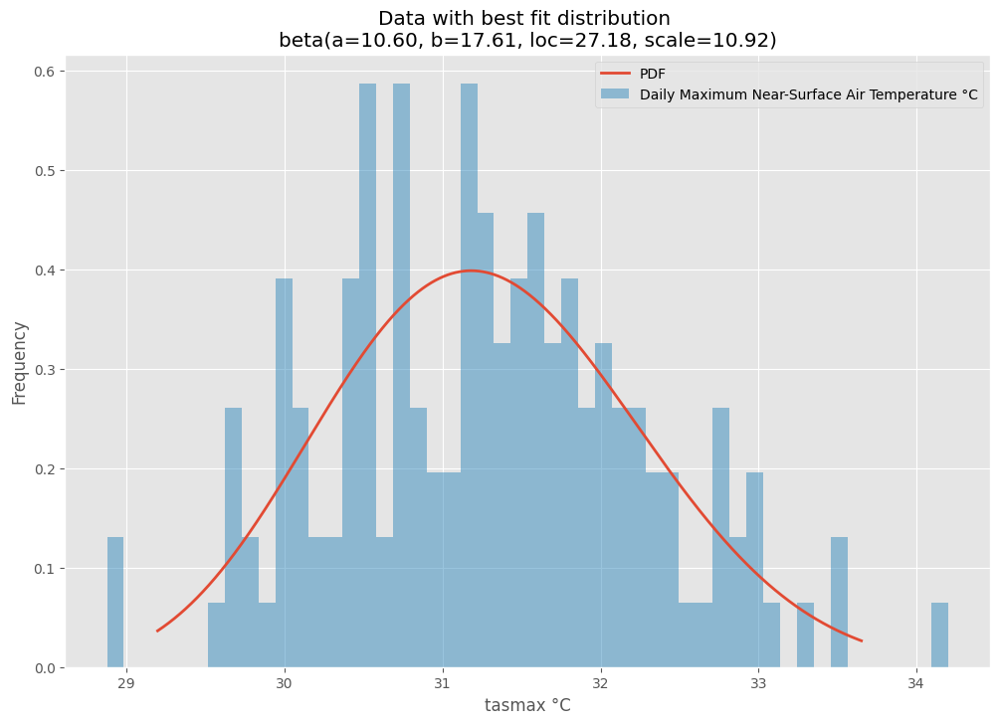

<Figure size 1200x800 with 0 Axes>

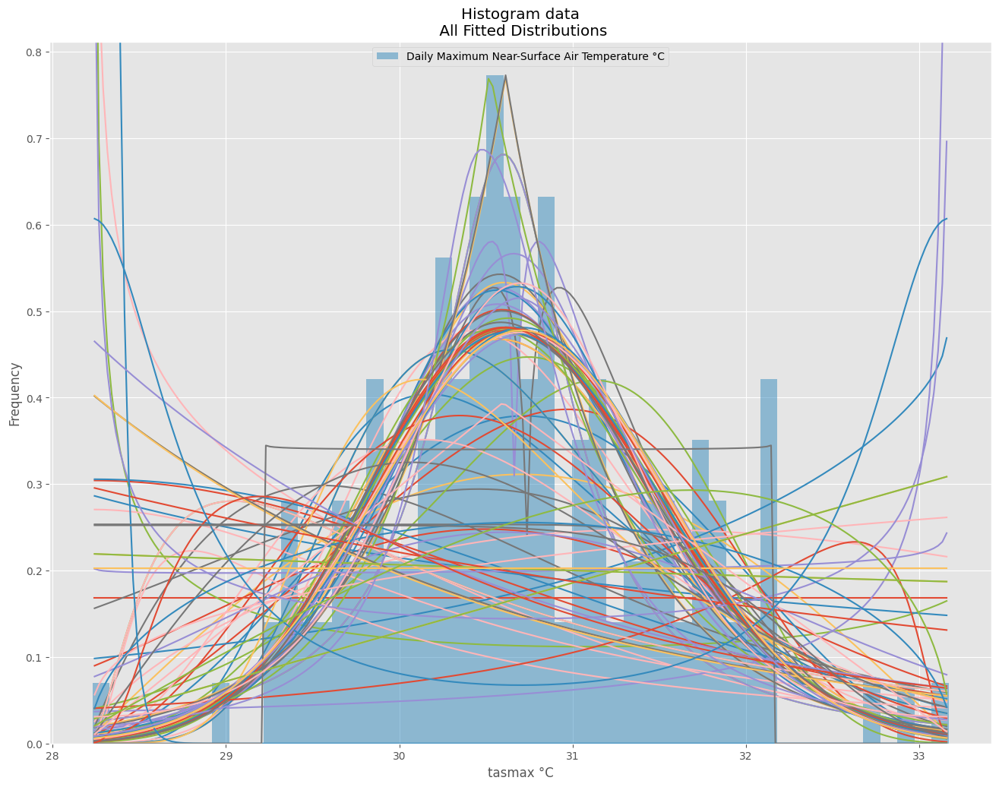

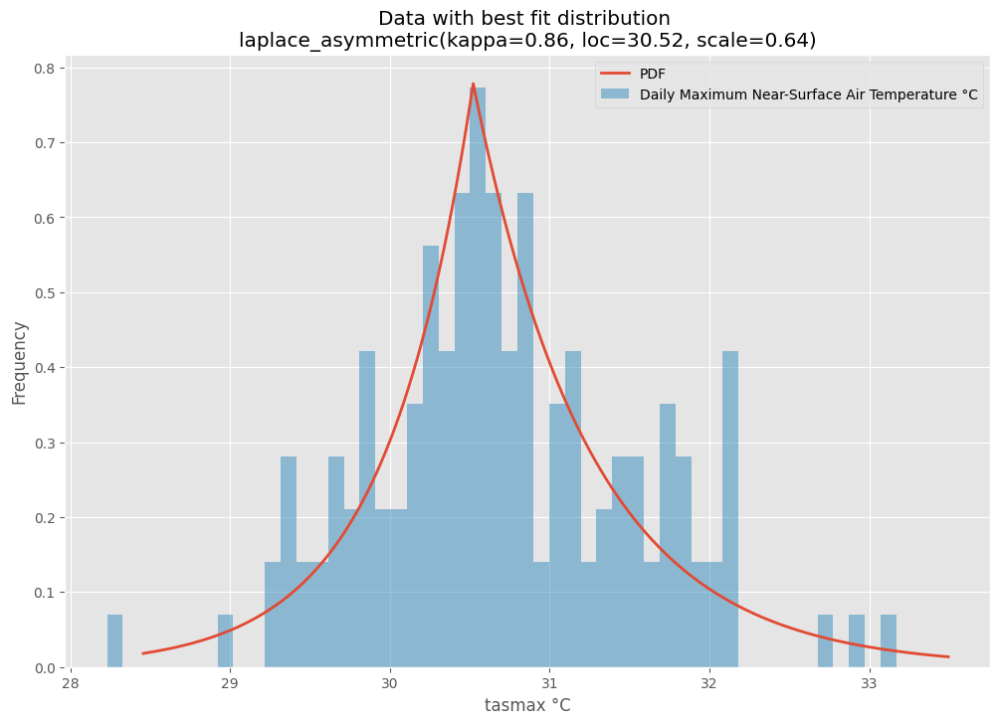

<Figure size 1200x800 with 0 Axes>

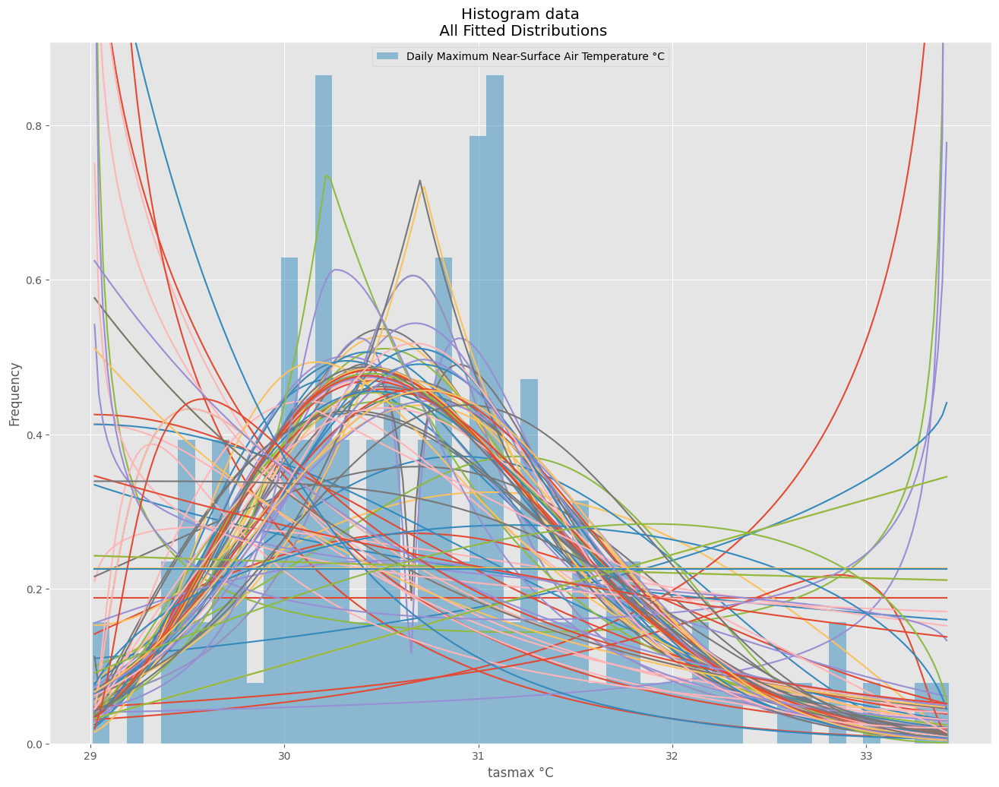

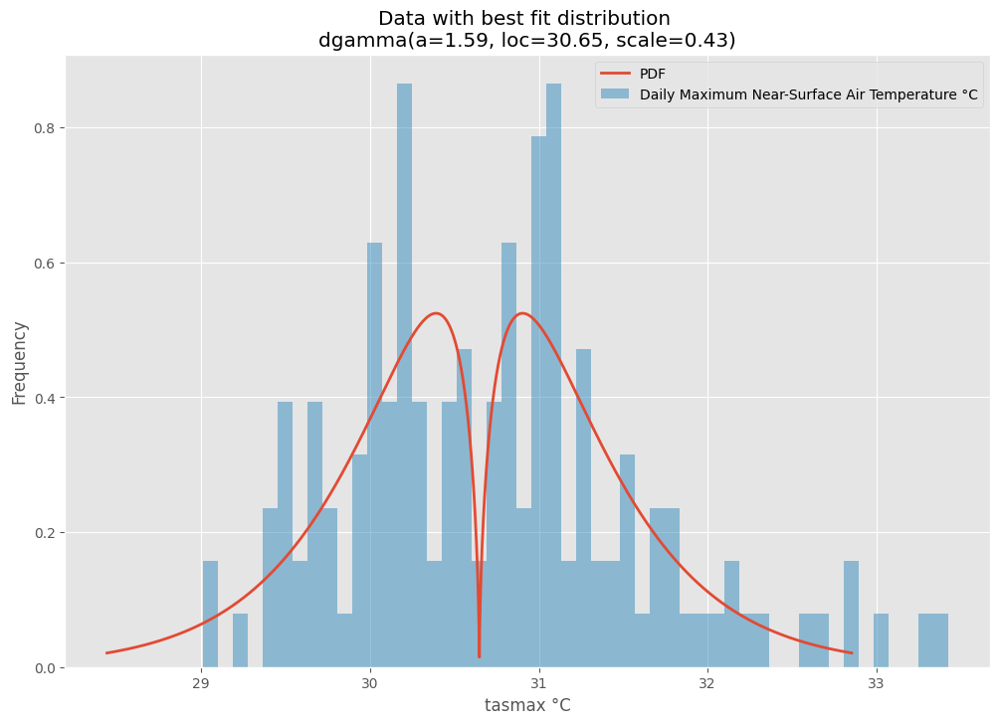

<Figure size 1200x800 with 0 Axes>

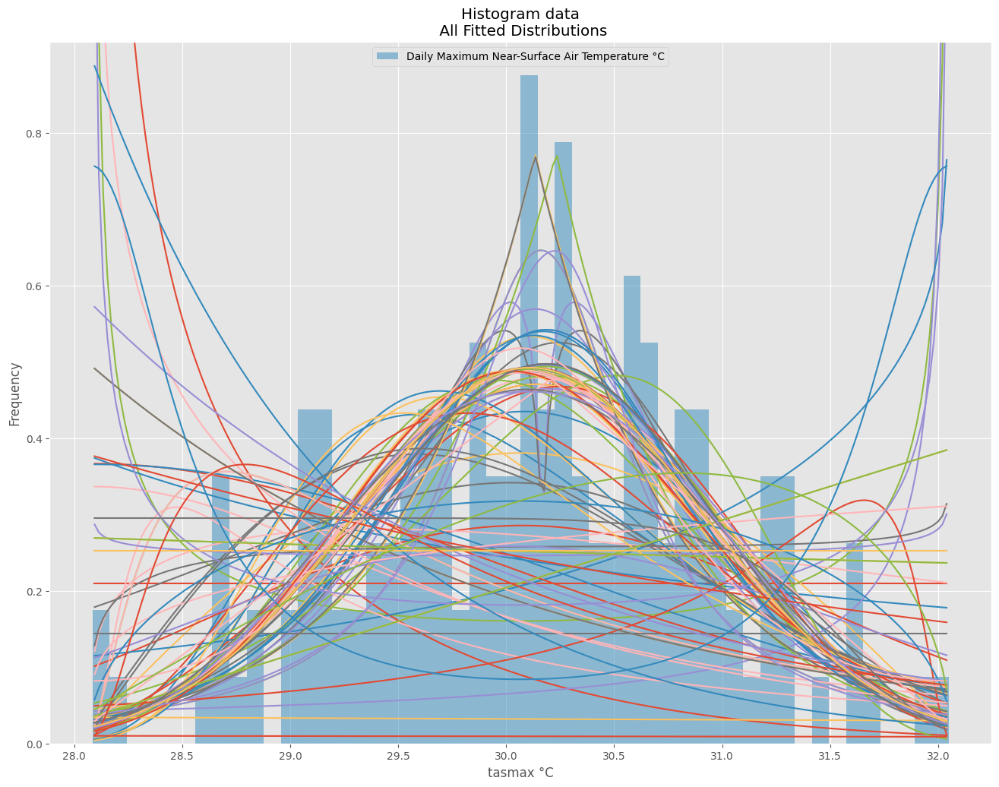

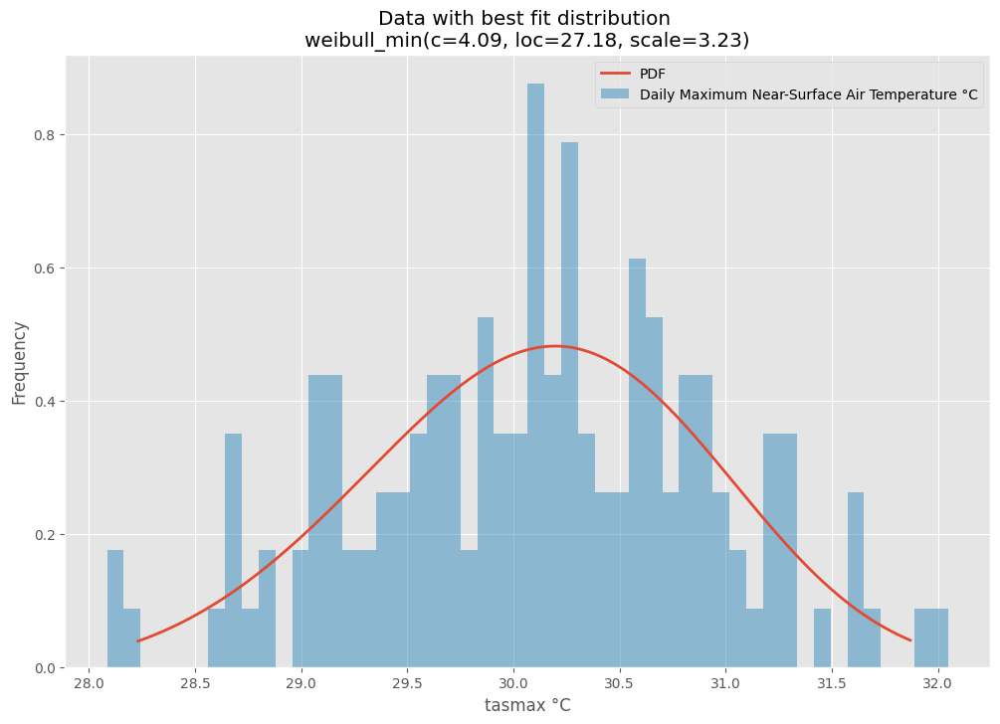

<Figure size 1200x800 with 0 Axes>

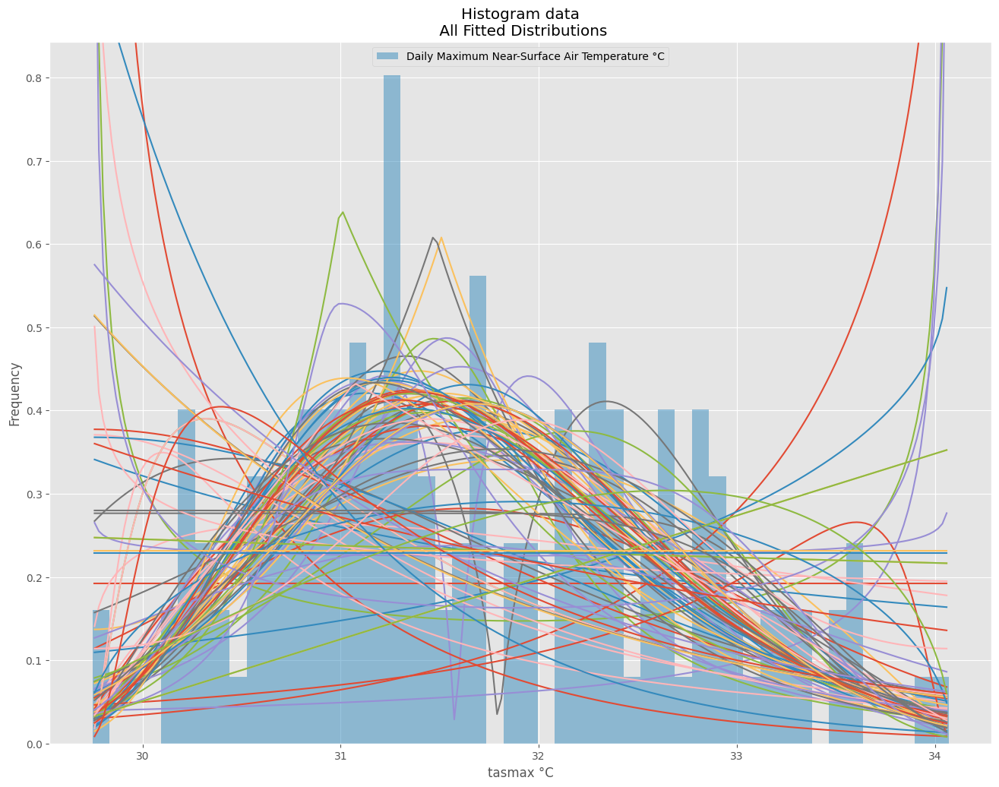

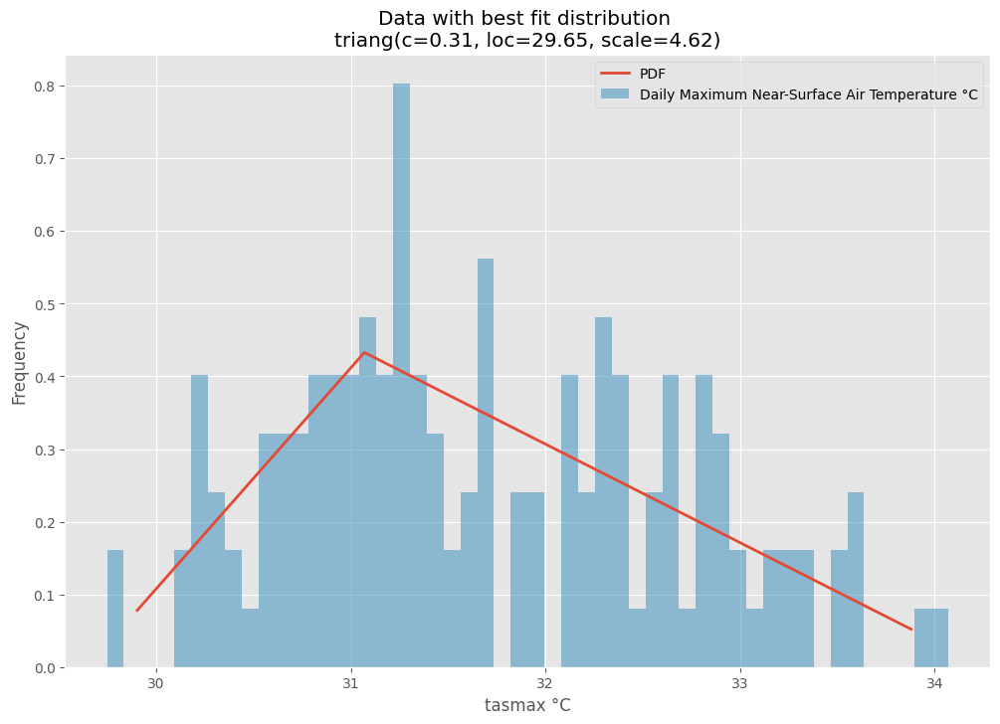

<Figure size 1200x800 with 0 Axes>

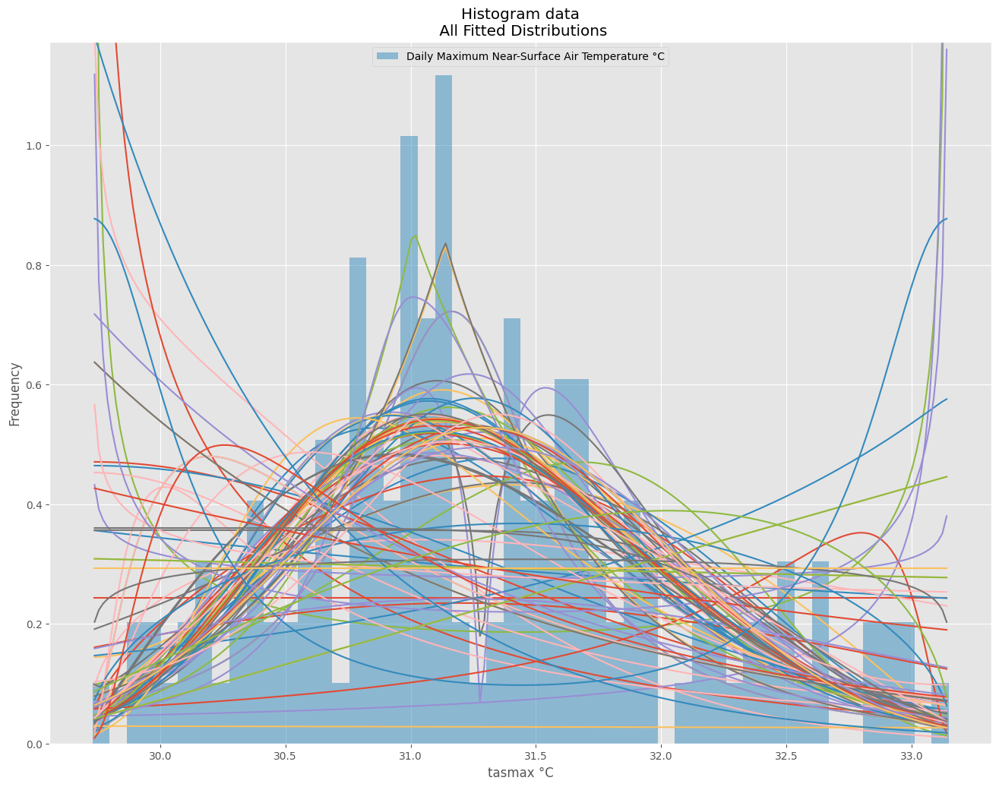

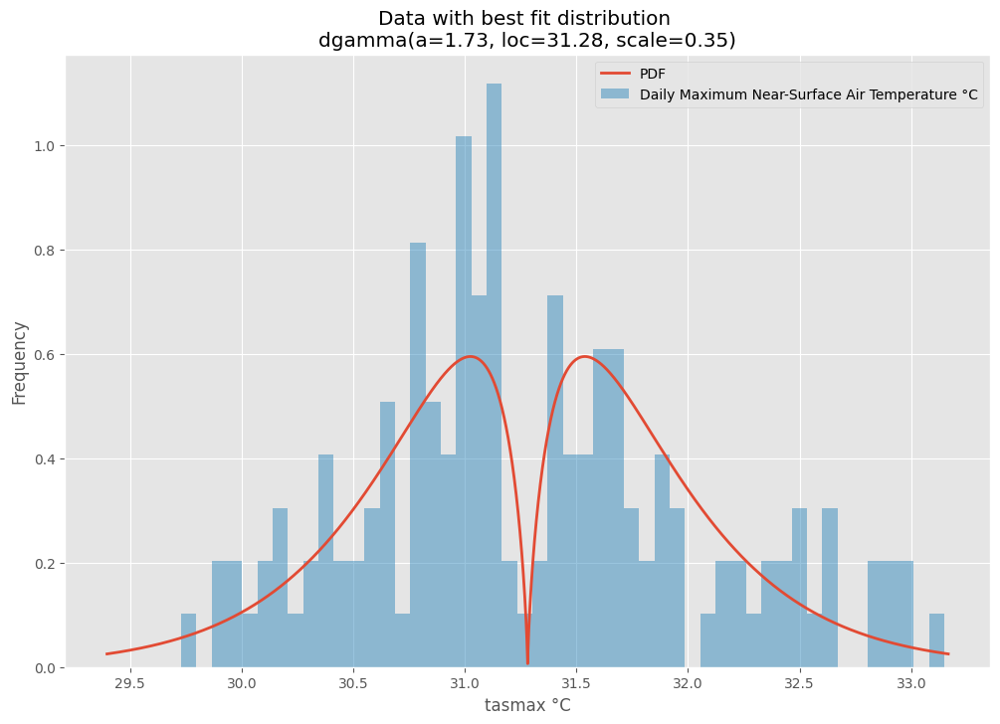

<Figure size 1200x800 with 0 Axes>

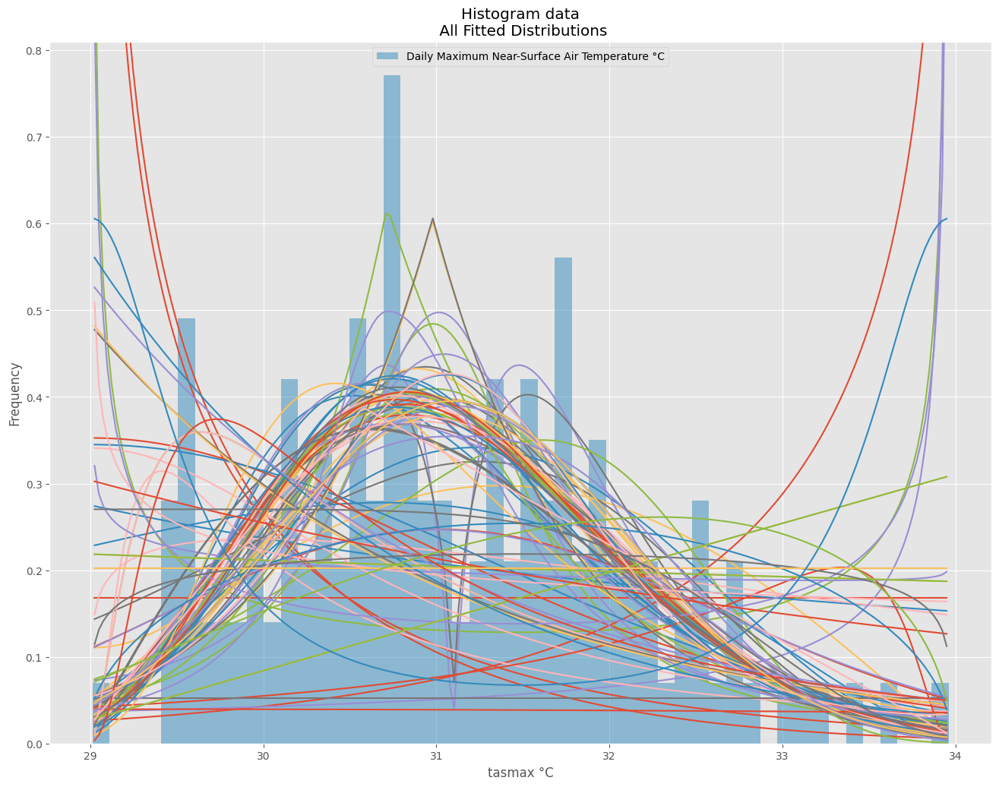

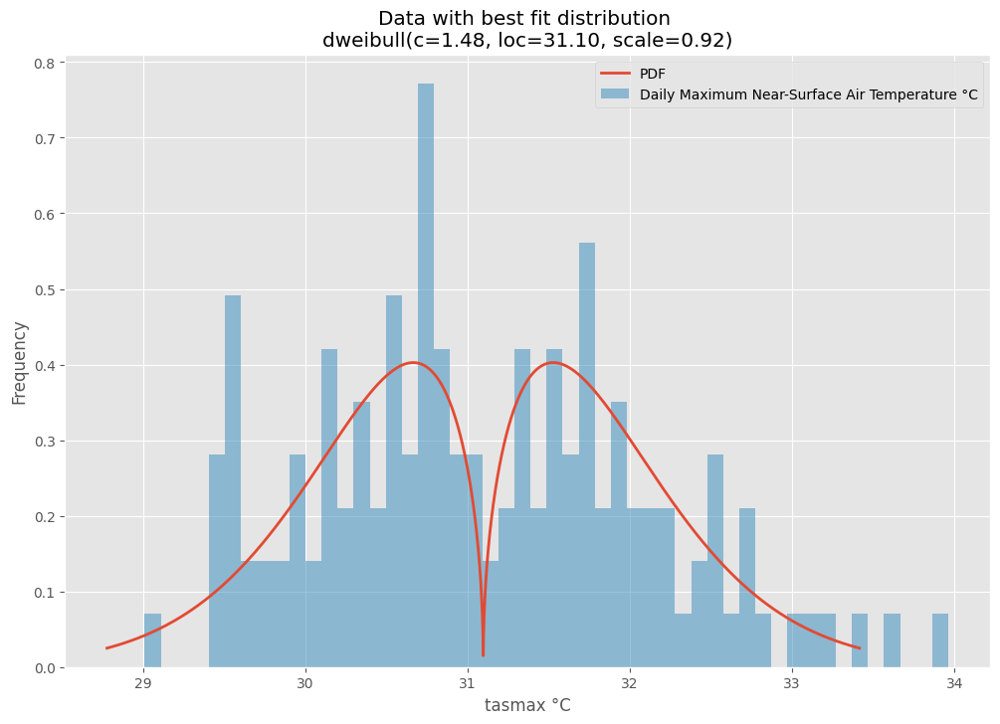

In [59]:
# probability with not BC data at Gorongosa
(proba_event_accross_model_gorongosa,likelihood_gorongosa)=likelihood_accross_models(df[(df['Name project']=='Gorongosa_EIB') & (df['Year'].between(2030,2065))].dropna(),'tasmax','°C','Daily Maximum Near-Surface Air Temperature °C',40,'>')

In [61]:
proba_event_accross_model_gorongosa_BC

0.04071317124467389

In [62]:
likelihood_gorongosa_BC

'Rare'

In [63]:
proba_event_accross_model_gorongosa

0.0011478587574690429

In [64]:
likelihood_gorongosa

'Rare'

## Precipitation : Future return period of one day rainfall event with a current return period of 100 years

### Import data

In [116]:
from Functions_ImportData import import_filtered_NOAA_obs
df_obs_NOAA = import_filtered_NOAA_obs()

In [65]:
# import original modeled NEX-GDDP-CMIP6
df_tas_NEXGDDPCMIP6=import_treat_modeled_NEX_GDDP_CMIP6('pr','mm_per_day','day',1950,2100)

In [69]:
df_tas_NEXGDDPCMIP6

,Name project,Experiment,Model,Latitude,Longitude,Date,Mean of the daily precipitation rate mm_per_day,Year,Month,Season
0,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,01-01-1950,0.657509,1950,Jan,Humid
1,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,02-01-1950,0.442182,1950,Jan,Humid
2,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,03-01-1950,0.031404,1950,Jan,Humid
3,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,04-01-1950,15.071664,1950,Jan,Humid
4,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,05-01-1950,12.865736,1950,Jan,Humid
...,...,...,...,...,...,...,...,...,...,...
8963095,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,27-12-2100,0.286506,2100,Dec,Humid
8963096,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,28-12-2100,0.050367,2100,Dec,Humid
8963097,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,29-12-2100,0.000000,2100,Dec,Humid
8963098,Pemba_EIB,ssp370,TaiESM1,-12.875,40.625,30-12-2100,0.581391,2100,Dec,Humid


In [66]:
# import BC NEX-GDDP-CMIP6 past
df_tasmax_NEXGDDPCMIP6_BC_NOAA_past=import_BC_NOAA_NEX_GDDP_CMIP6('pr',1970,2014,EmplacementStationNOAA='no')

In [67]:
# import BC NEX-GDDP-CMIP6 future
df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj=import_BC_NOAA_NEX_GDDP_CMIP6('pr',2030,2065,EmplacementStationNOAA='no')

In [ ]:
# select Part of interest in data

In [68]:
from Functions_Indicators import dataframe_threshold_coresponding_to_return_period_obs

In [71]:
from Functions_Indicators import dataframe_threshold_coresponding_to_return_period_model

In [145]:
df_tas_NEXGDDPCMIP6 = df_tas_NEXGDDPCMIP6[df_tas_NEXGDDPCMIP6['Model']!='NESM3']
df_tas_NEXGDDPCMIP6 = df_tas_NEXGDDPCMIP6[df_tas_NEXGDDPCMIP6['Model']!='TaiESM1']
df_tas_NEXGDDPCMIP6 = df_tas_NEXGDDPCMIP6[df_tas_NEXGDDPCMIP6['Model']!='CMCC-CM2-SR5']

In [146]:
df_model_past=df_tas_NEXGDDPCMIP6[df_tas_NEXGDDPCMIP6['Year'].between(1970,2014)]

In [186]:
df_model_past

,Name project,Experiment,Model,Latitude,Longitude,Date,Mean of the daily precipitation rate mm_per_day,Year,Month,Season
7305,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,01-01-1970,14.736932,1970,Jan,Humid
7306,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,02-01-1970,10.937477,1970,Jan,Humid
7307,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,03-01-1970,3.089670,1970,Jan,Humid
7308,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,04-01-1970,0.020694,1970,Jan,Humid
7309,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,05-01-1970,0.116412,1970,Jan,Humid
...,...,...,...,...,...,...,...,...,...,...
7054694,Pemba_EIB,historical,NorESM2-MM,-12.875,40.625,27-12-2014,0.000000,2014,Dec,Humid
7054695,Pemba_EIB,historical,NorESM2-MM,-12.875,40.625,28-12-2014,0.000000,2014,Dec,Humid
7054696,Pemba_EIB,historical,NorESM2-MM,-12.875,40.625,29-12-2014,0.468093,2014,Dec,Humid
7054697,Pemba_EIB,historical,NorESM2-MM,-12.875,40.625,30-12-2014,0.576708,2014,Dec,Humid


In [147]:
# past for modelled and non BC data
df_return_period_NEX_GDDP_CMIP6_past=dataframe_threshold_coresponding_to_return_period_model(df_model_past.dropna(),'Mean of the daily precipitation rate mm_per_day')

Name project Chimoio_WTP_EIB ssp historical model ACCESS-CM2
Name project Chimoio_WTP_EIB ssp historical model ACCESS-ESM1-5
Name project Chimoio_WTP_EIB ssp historical model BCC-CSM2-MR
Name project Chimoio_WTP_EIB ssp historical model CMCC-ESM2
Name project Chimoio_WTP_EIB ssp historical model CanESM5
Name project Chimoio_WTP_EIB ssp historical model IITM-ESM
Name project Chimoio_WTP_EIB ssp historical model MIROC6
Name project Chimoio_WTP_EIB ssp historical model MPI-ESM1-2-HR
Name project Chimoio_WTP_EIB ssp historical model MPI-ESM1-2-LR
Name project Chimoio_WTP_EIB ssp historical model MRI-ESM2-0
Name project Chimoio_WTP_EIB ssp historical model NorESM2-LM
Name project Chimoio_WTP_EIB ssp historical model NorESM2-MM
Name project Gorongosa_EIB ssp historical model ACCESS-CM2
Name project Gorongosa_EIB ssp historical model ACCESS-ESM1-5
Name project Gorongosa_EIB ssp historical model BCC-CSM2-MR
Name project Gorongosa_EIB ssp historical model CMCC-ESM2
Name project Gorongosa_EIB ss

In [148]:
df_return_period_NEX_GDDP_CMIP6_past['Period'] = '1970-2014'

In [149]:
df_return_period_NEX_GDDP_CMIP6

Value for return period 50 years mm/day  \
Name project    Experiment Model                                                   
Pemba_EIB       historical CMCC-CM2-SR5                                       54   
                           NorESM2-MM                                         49   
                           MPI-ESM1-2-HR                                      48   
                           BCC-CSM2-MR                                        62   
                           ACCESS-ESM1-5                                      43   
...                                                                          ...   
Chimoio_WTP_EIB ssp126     CMCC-ESM2                                          64   
                           MPI-ESM1-2-LR                                      64   
                           CanESM5                                            60   
                           ACCESS-CM2                                         78   
                           MRI-ESM2-0                                         67   

                                         Value for return period 100 years mm/day  \
Name project    Experiment Model                                                    
Pemba_EIB       historical CMCC-CM2-SR5                                        58   
                           NorESM2-MM                                          52   
                           MPI-ESM1-2-HR                                       52   
                           BCC-CSM2-MR                                         67   
                           ACCESS-ESM1-5                                       46   
...                                                                           ...   
Chimoio_WTP_EIB ssp126     CMCC-ESM2                                           70   
                           MPI-ESM1-2-LR                                       69   
                           CanESM5                                             66   
                           ACCESS-CM2                                          85   
                           MRI-ESM2-0                                          72   

                                             Period  
Name project    Experiment Model                     
Pemba_EIB       historical CMCC-CM2-SR5   1970-2014  
                           NorESM2-MM     1970-2014  
                           MPI-ESM1-2-HR  1970-2014  
                           BCC-CSM2-MR    1970-2014  
                           ACCESS-ESM1-5  1970-2014  
...                                             ...  
Chimoio_WTP_EIB ssp126     CMCC-ESM2      2030-2065  
                           MPI-ESM1-2-LR  2030-2065  
                           CanESM5        2030-2065  
                           ACCESS-CM2     2030-2065  
                           MRI-ESM2-0     2030-2065  

[280 rows x 3 columns]

In [150]:
df_model_future=df_tas_NEXGDDPCMIP6[df_tas_NEXGDDPCMIP6['Year'].between(2030,2065)]

In [151]:
df_return_period_NEX_GDDP_CMIP6_future=dataframe_threshold_coresponding_to_return_period_model(df_model_future.dropna(),'Mean of the daily precipitation rate mm_per_day')

Name project Chimoio_WTP_EIB ssp ssp126 model ACCESS-CM2
Name project Chimoio_WTP_EIB ssp ssp126 model ACCESS-ESM1-5
Name project Chimoio_WTP_EIB ssp ssp126 model BCC-CSM2-MR
Name project Chimoio_WTP_EIB ssp ssp126 model CMCC-ESM2
Name project Chimoio_WTP_EIB ssp ssp126 model CanESM5
Name project Chimoio_WTP_EIB ssp ssp126 model IITM-ESM
Name project Chimoio_WTP_EIB ssp ssp126 model MIROC6
Name project Chimoio_WTP_EIB ssp ssp126 model MPI-ESM1-2-HR
Name project Chimoio_WTP_EIB ssp ssp126 model MPI-ESM1-2-LR
Name project Chimoio_WTP_EIB ssp ssp126 model MRI-ESM2-0
Name project Chimoio_WTP_EIB ssp ssp126 model NorESM2-LM
Name project Chimoio_WTP_EIB ssp ssp126 model NorESM2-MM
Name project Chimoio_WTP_EIB ssp ssp245 model ACCESS-CM2
Name project Chimoio_WTP_EIB ssp ssp245 model ACCESS-ESM1-5
Name project Chimoio_WTP_EIB ssp ssp245 model BCC-CSM2-MR
Name project Chimoio_WTP_EIB ssp ssp245 model CMCC-ESM2
Name project Chimoio_WTP_EIB ssp ssp245 model CanESM5
Name project Chimoio_WTP_EIB ss

In [152]:
df_return_period_NEX_GDDP_CMIP6_future['Period'] = '2030-2065'

In [153]:
df_return_period_NEX_GDDP_CMIP6_future

Value for return period 50 years mm/day  \
Name project    Experiment Model                                                   
Pemba_EIB       ssp585     NorESM2-MM                                         54   
                           MPI-ESM1-2-HR                                      49   
                           BCC-CSM2-MR                                        58   
                           ACCESS-ESM1-5                                      68   
                           IITM-ESM                                           55   
...                                                                          ...   
Chimoio_WTP_EIB ssp126     CMCC-ESM2                                          64   
                           MPI-ESM1-2-LR                                      64   
                           CanESM5                                            60   
                           ACCESS-CM2                                         78   
                           MRI-ESM2-0                                         67   

                                         Value for return period 100 years mm/day  \
Name project    Experiment Model                                                    
Pemba_EIB       ssp585     NorESM2-MM                                          58   
                           MPI-ESM1-2-HR                                       53   
                           BCC-CSM2-MR                                         62   
                           ACCESS-ESM1-5                                       75   
                           IITM-ESM                                            60   
...                                                                           ...   
Chimoio_WTP_EIB ssp126     CMCC-ESM2                                           70   
                           MPI-ESM1-2-LR                                       69   
                           CanESM5                                             66   
                           ACCESS-CM2                                          85   
                           MRI-ESM2-0                                          72   

                                             Period  
Name project    Experiment Model                     
Pemba_EIB       ssp585     NorESM2-MM     2030-2065  
                           MPI-ESM1-2-HR  2030-2065  
                           BCC-CSM2-MR    2030-2065  
                           ACCESS-ESM1-5  2030-2065  
                           IITM-ESM       2030-2065  
...                                             ...  
Chimoio_WTP_EIB ssp126     CMCC-ESM2      2030-2065  
                           MPI-ESM1-2-LR  2030-2065  
                           CanESM5        2030-2065  
                           ACCESS-CM2     2030-2065  
                           MRI-ESM2-0     2030-2065  

[192 rows x 3 columns]

In [154]:
# calculate return period with observation data

In [160]:
# sure de cette function
import scipy
from scipy import stats
from scipy.stats import gumbel_r
from scipy.stats import gumbel_l
def return_period(df,T,start_y,stop_y):
    Z = df[df['Year'].between(start_y,stop_y)].groupby('Year')[['pr']].agg(np.nanmax)#.reshape(len(pr_obs_gorongosa_from_gorongosa.groupby('Year')[['pr']].max()),)
    #Z = Z[~np.isnan(Z)]
    (loc1,scale1)=scipy.stats.gumbel_r.fit(Z) # return the function necessary to establish the continous function
    value_for_T=threshold_coresponding_to_return_period(loc1,scale1,T)
    return value_for_T

In [156]:
def threshold_coresponding_to_return_period(loc,scale,T):
    p_non_exceedance = 1 - (1/T)
    try:
        threshold_coresponding = round(gumbel_r.ppf(p_non_exceedance,loc,scale))
    except OverflowError: # the result is not finite
        if math.isinf(gumbel_r.ppf(p_non_exceedance,loc,scale)) and gumbel_r.ppf(p_non_exceedance,loc,scale)<0:
            # ppf is the inverse of cdf
            # the result is -inf
            threshold_coresponding = 0 # the value of wero is imposed
    return threshold_coresponding

In [157]:
df_obs_NOAA = df_obs_NOAA.rename(columns={'PRCP':'pr'})

In [174]:
df_obs_NOAA_Chimoio = df_obs_NOAA[df_obs_NOAA['NAME']=='CHIMOIO, MZ']

In [188]:
df_return_period_obs=return_period(df_obs_NOAA_Chimoio[['pr','Year']],50,1970,2014)

In [189]:
df_return_period_obs

197

In [163]:
df_return_period_NEX_GDDP_CMIP6 = pd.concat([df_return_period_NEX_GDDP_CMIP6_past,df_return_period_NEX_GDDP_CMIP6_future])

In [164]:
df_return_period_NEX_GDDP_CMIP6

Value for return period 50 years mm/day  \
Name project    Experiment Model                                                   
Pemba_EIB       historical NorESM2-MM                                         49   
                           MPI-ESM1-2-HR                                      48   
                           BCC-CSM2-MR                                        62   
                           ACCESS-ESM1-5                                      43   
                           IITM-ESM                                           45   
...                                                                          ...   
Chimoio_WTP_EIB ssp126     CMCC-ESM2                                          64   
                           MPI-ESM1-2-LR                                      64   
                           CanESM5                                            60   
                           ACCESS-CM2                                         78   
                           MRI-ESM2-0                                         67   

                                         Value for return period 100 years mm/day  \
Name project    Experiment Model                                                    
Pemba_EIB       historical NorESM2-MM                                          52   
                           MPI-ESM1-2-HR                                       52   
                           BCC-CSM2-MR                                         67   
                           ACCESS-ESM1-5                                       46   
                           IITM-ESM                                            48   
...                                                                           ...   
Chimoio_WTP_EIB ssp126     CMCC-ESM2                                           70   
                           MPI-ESM1-2-LR                                       69   
                           CanESM5                                             66   
                           ACCESS-CM2                                          85   
                           MRI-ESM2-0                                          72   

                                             Period  
Name project    Experiment Model                     
Pemba_EIB       historical NorESM2-MM     1970-2014  
                           MPI-ESM1-2-HR  1970-2014  
                           BCC-CSM2-MR    1970-2014  
                           ACCESS-ESM1-5  1970-2014  
                           IITM-ESM       1970-2014  
...                                             ...  
Chimoio_WTP_EIB ssp126     CMCC-ESM2      2030-2065  
                           MPI-ESM1-2-LR  2030-2065  
                           CanESM5        2030-2065  
                           ACCESS-CM2     2030-2065  
                           MRI-ESM2-0     2030-2065  

[240 rows x 3 columns]

In [165]:
df_return_period_NEX_GDDP_CMIP6_gorongosa = df_return_period_NEX_GDDP_CMIP6.reset_index()[df_return_period_NEX_GDDP_CMIP6.reset_index()['Name project']=='Gorongosa_EIB']

In [166]:
plt.rcdefaults()

<Axes: xlabel='Period', ylabel='Value for return period 100 years mm/day'>

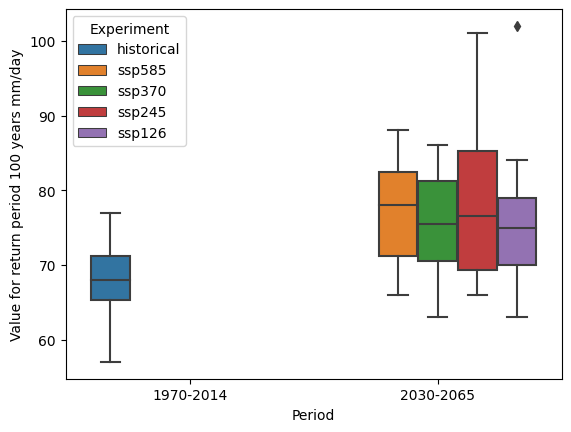

In [167]:
sns.boxplot(data=df_return_period_NEX_GDDP_CMIP6_gorongosa,x='Period',y='Value for return period 100 years mm/day',hue='Experiment')

<Axes: xlabel='Period', ylabel='Value for return period 50 years mm/day'>

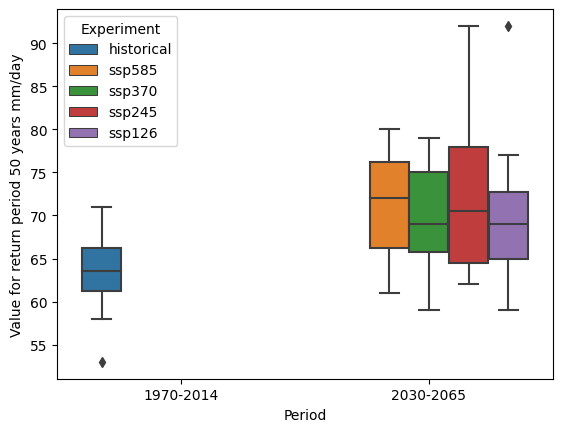

In [168]:
sns.boxplot(data=df_return_period_NEX_GDDP_CMIP6_gorongosa,x='Period',y='Value for return period 50 years mm/day',hue='Experiment')

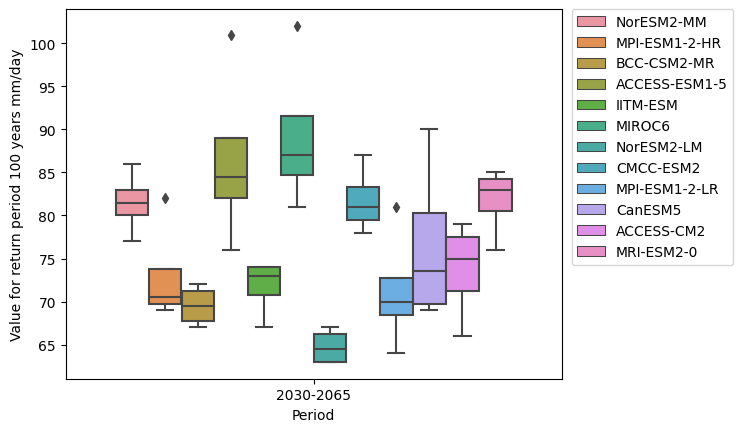

In [169]:
sns.boxplot(data=df_return_period_NEX_GDDP_CMIP6_gorongosa[df_return_period_NEX_GDDP_CMIP6_gorongosa['Period']=='2030-2065'],x='Period',y='Value for return period 100 years mm/day',hue='Model')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

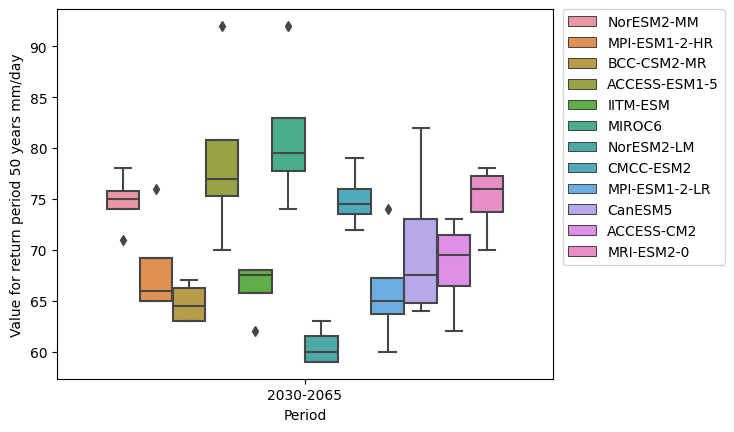

In [171]:
sns.boxplot(data=df_return_period_NEX_GDDP_CMIP6_gorongosa[df_return_period_NEX_GDDP_CMIP6_gorongosa['Period']=='2030-2065'],x='Period',y='Value for return period 50 years mm/day',hue='Model')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

In [ ]:
# same with modeled data

In [213]:
# return return period for dataframe of modelled data
def dataframe_threshold_coresponding_to_return_period_model(df,name_col):
    df_copy=df.copy(deep=True)
    df_copy=df_copy.drop(labels='Date',axis=1)
    df_max = df_copy.groupby(['Name project','Experiment','Model','Year']).max() # maximum    
    #return df_max
    midx = pd.MultiIndex.from_product([df_max.index.levels[0].tolist(),df_max.index.levels[1].tolist(),df_max.index.levels[2].tolist()],names=['Name project','Experiment', 'Model'])
    cols = ['Value for return period 50 years mm/day','Value for return period 100 years mm/day']
    return_period = pd.DataFrame(data = [], 
                                index = midx,
                                columns = cols)
    for name_p in df_max.index.levels[0].tolist():
        print(name_p)
        for ssp in df_max.index.levels[1].tolist():
            print(ssp)
            for model in df_max.index.levels[2].tolist():
                print(model)
                print('Name project '+name_p+ ' ssp '+ssp+ ' model '+model)
                Z=df_max.loc[(name_p,ssp,model)][name_col].values.reshape(len(df_max.loc[(name_p,ssp,model)][name_col]),)
                (loc1,scale)=stats.gumbel_r.fit(Z) # return the function necessary to establish the continous function
                # choice of gumbel because suits to extreme precipitation
                return_period.loc[(name_p,ssp,model),('Value for return period 50 years mm/day')] = threshold_coresponding_to_return_period(loc1,scale,50)
                return_period.loc[(name_p,ssp,model),('Value for return period 100 years mm/day')] = threshold_coresponding_to_return_period(loc1,scale,100)
                
    return return_period

In [212]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_past

,Date,Mean of the daily precipitation rate mm_per_day,Name project,Experiment,Model,Year,Month,Season
0,1970-01-01,0.000000,Chimoio_WTP_EIB,historical,MPI-ESM1-2-HR,1970,Jan,Humid
1,1970-01-02,0.000000,Chimoio_WTP_EIB,historical,MPI-ESM1-2-HR,1970,Jan,Humid
2,1970-01-03,0.000000,Chimoio_WTP_EIB,historical,MPI-ESM1-2-HR,1970,Jan,Humid
3,1970-01-04,0.000000,Chimoio_WTP_EIB,historical,MPI-ESM1-2-HR,1970,Jan,Humid
4,1970-01-05,0.000000,Chimoio_WTP_EIB,historical,MPI-ESM1-2-HR,1970,Jan,Humid
...,...,...,...,...,...,...,...,...
787207,2014-12-27,6.800688,WTP_Mutua_EIB,historical,NorESM2-LM,2014,Dec,Humid
787208,2014-12-28,1.000000,WTP_Mutua_EIB,historical,NorESM2-LM,2014,Dec,Humid
787209,2014-12-29,8.600000,WTP_Mutua_EIB,historical,NorESM2-LM,2014,Dec,Humid
787210,2014-12-30,55.494839,WTP_Mutua_EIB,historical,NorESM2-LM,2014,Dec,Humid


In [211]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj

,Date,Mean of the daily precipitation rate mm_per_day,Name project,Experiment,Model,Year,Month,Season
0,2030-01-01,5.100000,Pemba_EIB,ssp245,MRI-ESM2-0,2030,Jan,Humid
1,2030-01-02,0.000000,Pemba_EIB,ssp245,MRI-ESM2-0,2030,Jan,Humid
2,2030-01-03,0.000000,Pemba_EIB,ssp245,MRI-ESM2-0,2030,Jan,Humid
3,2030-01-04,0.069934,Pemba_EIB,ssp245,MRI-ESM2-0,2030,Jan,Humid
4,2030-01-05,51.608529,Pemba_EIB,ssp245,MRI-ESM2-0,2030,Jan,Humid
...,...,...,...,...,...,...,...,...
2942775,2065-12-27,0.000000,Gorongosa_EIB,ssp370,MPI-ESM1-2-HR,2065,Dec,Humid
2942776,2065-12-28,0.000000,Gorongosa_EIB,ssp370,MPI-ESM1-2-HR,2065,Dec,Humid
2942777,2065-12-29,0.000000,Gorongosa_EIB,ssp370,MPI-ESM1-2-HR,2065,Dec,Humid
2942778,2065-12-30,0.000000,Gorongosa_EIB,ssp370,MPI-ESM1-2-HR,2065,Dec,Humid


In [214]:
df_return_period_NEX_GDDP_CMIP6_past=dataframe_threshold_coresponding_to_return_period_model(df_tasmax_NEXGDDPCMIP6_BC_NOAA_past.dropna(),'Mean of the daily precipitation rate mm_per_day')

Chimoio_WTP_EIB
historical
ACCESS-CM2
Name project Chimoio_WTP_EIB ssp historical model ACCESS-CM2
ACCESS-ESM1-5
Name project Chimoio_WTP_EIB ssp historical model ACCESS-ESM1-5
BCC-CSM2-MR
Name project Chimoio_WTP_EIB ssp historical model BCC-CSM2-MR
CMCC-ESM2
Name project Chimoio_WTP_EIB ssp historical model CMCC-ESM2
CanESM5
Name project Chimoio_WTP_EIB ssp historical model CanESM5
IITM-ESM
Name project Chimoio_WTP_EIB ssp historical model IITM-ESM
MIROC6
Name project Chimoio_WTP_EIB ssp historical model MIROC6
MPI-ESM1-2-HR
Name project Chimoio_WTP_EIB ssp historical model MPI-ESM1-2-HR
MPI-ESM1-2-LR
Name project Chimoio_WTP_EIB ssp historical model MPI-ESM1-2-LR
MRI-ESM2-0
Name project Chimoio_WTP_EIB ssp historical model MRI-ESM2-0
NorESM2-LM
Name project Chimoio_WTP_EIB ssp historical model NorESM2-LM
NorESM2-MM
Name project Chimoio_WTP_EIB ssp historical model NorESM2-MM
Gorongosa_EIB
historical
ACCESS-CM2
Name project Gorongosa_EIB ssp historical model ACCESS-CM2
ACCESS-ESM1-5


In [215]:
df_return_period_NEX_GDDP_CMIP6_past['Period']='1970-2014'

In [216]:
df_return_period_NEX_GDDP_CMIP6_past

Value for return period 50 years mm/day  \
Name project    Experiment Model                                                   
Chimoio_WTP_EIB historical ACCESS-CM2                                        192   
                           ACCESS-ESM1-5                                     195   
                           BCC-CSM2-MR                                       201   
                           CMCC-ESM2                                         187   
                           CanESM5                                           206   
                           IITM-ESM                                          189   
                           MIROC6                                            189   
                           MPI-ESM1-2-HR                                     195   
                           MPI-ESM1-2-LR                                     189   
                           MRI-ESM2-0                                        195   
                           NorESM2-LM                                        180   
                           NorESM2-MM                                        201   
Gorongosa_EIB   historical ACCESS-CM2                                        194   
                           ACCESS-ESM1-5                                     197   
                           BCC-CSM2-MR                                       189   
                           CMCC-ESM2                                         191   
                           CanESM5                                           216   
                           IITM-ESM                                          196   
                           MIROC6                                            189   
                           MPI-ESM1-2-HR                                     189   
                           MPI-ESM1-2-LR                                     194   
                           MRI-ESM2-0                                        189   
                           NorESM2-LM                                        185   
                           NorESM2-MM                                        196   
Pemba_EIB       historical ACCESS-CM2                                        175   
                           ACCESS-ESM1-5                                     176   
                           BCC-CSM2-MR                                       176   
                           CMCC-ESM2                                         168   
                           CanESM5                                           186   
                           IITM-ESM                                          168   
                           MIROC6                                            177   
                           MPI-ESM1-2-HR                                     171   
                           MPI-ESM1-2-LR                                     165   
                           MRI-ESM2-0                                        182   
                           NorESM2-LM                                        173   
                           NorESM2-MM                                        167   
WTP_Mutua_EIB   historical ACCESS-CM2                                        240   
                           ACCESS-ESM1-5                                     274   
                           BCC-CSM2-MR                                       252   
                           CMCC-ESM2                                         252   
                           CanESM5                                           279   
                           IITM-ESM                                          256   
                           MIROC6                                            248   
                           MPI-ESM1-2-HR                                     257   
                           MPI-ESM1-2-LR                                     265   
                           MRI-ESM2-0                                        241   
         

In [217]:
df_return_period_NEX_GDDP_CMIP6_proj=dataframe_threshold_coresponding_to_return_period_model(df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj.dropna(),'Mean of the daily precipitation rate mm_per_day')

Chimoio_WTP_EIB
ssp126
ACCESS-CM2
Name project Chimoio_WTP_EIB ssp ssp126 model ACCESS-CM2
ACCESS-ESM1-5
Name project Chimoio_WTP_EIB ssp ssp126 model ACCESS-ESM1-5
BCC-CSM2-MR
Name project Chimoio_WTP_EIB ssp ssp126 model BCC-CSM2-MR
CMCC-CM2-SR5
Name project Chimoio_WTP_EIB ssp ssp126 model CMCC-CM2-SR5
CMCC-ESM2
Name project Chimoio_WTP_EIB ssp ssp126 model CMCC-ESM2
CanESM5
Name project Chimoio_WTP_EIB ssp ssp126 model CanESM5
IITM-ESM
Name project Chimoio_WTP_EIB ssp ssp126 model IITM-ESM
MIROC6
Name project Chimoio_WTP_EIB ssp ssp126 model MIROC6
MPI-ESM1-2-HR
Name project Chimoio_WTP_EIB ssp ssp126 model MPI-ESM1-2-HR
MPI-ESM1-2-LR
Name project Chimoio_WTP_EIB ssp ssp126 model MPI-ESM1-2-LR
MRI-ESM2-0
Name project Chimoio_WTP_EIB ssp ssp126 model MRI-ESM2-0
NorESM2-LM
Name project Chimoio_WTP_EIB ssp ssp126 model NorESM2-LM
NorESM2-MM
Name project Chimoio_WTP_EIB ssp ssp126 model NorESM2-MM
TaiESM1
Name project Chimoio_WTP_EIB ssp ssp126 model TaiESM1
ssp245
ACCESS-CM2
Name proj

ACCESS-ESM1-5
Name project Pemba_EIB ssp ssp370 model ACCESS-ESM1-5
BCC-CSM2-MR
Name project Pemba_EIB ssp ssp370 model BCC-CSM2-MR
CMCC-CM2-SR5
Name project Pemba_EIB ssp ssp370 model CMCC-CM2-SR5
CMCC-ESM2
Name project Pemba_EIB ssp ssp370 model CMCC-ESM2
CanESM5
Name project Pemba_EIB ssp ssp370 model CanESM5
IITM-ESM
Name project Pemba_EIB ssp ssp370 model IITM-ESM
MIROC6
Name project Pemba_EIB ssp ssp370 model MIROC6
MPI-ESM1-2-HR
Name project Pemba_EIB ssp ssp370 model MPI-ESM1-2-HR
MPI-ESM1-2-LR
Name project Pemba_EIB ssp ssp370 model MPI-ESM1-2-LR
MRI-ESM2-0
Name project Pemba_EIB ssp ssp370 model MRI-ESM2-0
NorESM2-LM
Name project Pemba_EIB ssp ssp370 model NorESM2-LM
NorESM2-MM
Name project Pemba_EIB ssp ssp370 model NorESM2-MM
TaiESM1
Name project Pemba_EIB ssp ssp370 model TaiESM1
ssp585
ACCESS-CM2
Name project Pemba_EIB ssp ssp585 model ACCESS-CM2
ACCESS-ESM1-5
Name project Pemba_EIB ssp ssp585 model ACCESS-ESM1-5
BCC-CSM2-MR
Name project Pemba_EIB ssp ssp585 model BCC-CSM

In [218]:
df_return_period_NEX_GDDP_CMIP6_proj

Value for return period 50 years mm/day  \
Name project    Experiment Model                                                   
Chimoio_WTP_EIB ssp126     ACCESS-CM2                                        185   
                           ACCESS-ESM1-5                                     193   
                           BCC-CSM2-MR                                       196   
                           CMCC-CM2-SR5                                      201   
                           CMCC-ESM2                                         189   
...                                                                          ...   
WTP_Mutua_EIB   ssp585     MPI-ESM1-2-LR                                     263   
                           MRI-ESM2-0                                        253   
                           NorESM2-LM                                        266   
                           NorESM2-MM                                        241   
                           TaiESM1                                           234   

                                         Value for return period 100 years mm/day  
Name project    Experiment Model                                                   
Chimoio_WTP_EIB ssp126     ACCESS-CM2                                         203  
                           ACCESS-ESM1-5                                      213  
                           BCC-CSM2-MR                                        216  
                           CMCC-CM2-SR5                                       223  
                           CMCC-ESM2                                          208  
...                                                                           ...  
WTP_Mutua_EIB   ssp585     MPI-ESM1-2-LR                                      289  
                           MRI-ESM2-0                                         279  
                           NorESM2-LM                                         295  
                           NorESM2-MM                                         266  
                           TaiESM1                                            257  

[224 rows x 2 columns]

In [219]:
df_return_period_NEX_GDDP_CMIP6_proj['Period']='2030-2065'

In [220]:
df_return_BC = pd.concat([df_return_period_NEX_GDDP_CMIP6_past,df_return_period_NEX_GDDP_CMIP6_proj])

In [222]:
df_return_BC

Value for return period 50 years mm/day  \
Name project    Experiment Model                                                   
Chimoio_WTP_EIB historical ACCESS-CM2                                        192   
                           ACCESS-ESM1-5                                     195   
                           BCC-CSM2-MR                                       201   
                           CMCC-ESM2                                         187   
                           CanESM5                                           206   
...                                                                          ...   
WTP_Mutua_EIB   ssp585     MPI-ESM1-2-LR                                     263   
                           MRI-ESM2-0                                        253   
                           NorESM2-LM                                        266   
                           NorESM2-MM                                        241   
                           TaiESM1                                           234   

                                         Value for return period 100 years mm/day  \
Name project    Experiment Model                                                    
Chimoio_WTP_EIB historical ACCESS-CM2                                         211   
                           ACCESS-ESM1-5                                      216   
                           BCC-CSM2-MR                                        223   
                           CMCC-ESM2                                          205   
                           CanESM5                                            228   
...                                                                           ...   
WTP_Mutua_EIB   ssp585     MPI-ESM1-2-LR                                      289   
                           MRI-ESM2-0                                         279   
                           NorESM2-LM                                         295   
                           NorESM2-MM                                         266   
                           TaiESM1                                            257   

                                             Period  
Name project    Experiment Model                     
Chimoio_WTP_EIB historical ACCESS-CM2     1970-2014  
                           ACCESS-ESM1-5  1970-2014  
                           BCC-CSM2-MR    1970-2014  
                           CMCC-ESM2      1970-2014  
                           CanESM5        1970-2014  
...                                             ...  
WTP_Mutua_EIB   ssp585     MPI-ESM1-2-LR  2030-2065  
                           MRI-ESM2-0     2030-2065  
                           NorESM2-LM     2030-2065  
                           NorESM2-MM     2030-2065  
                           TaiESM1        2030-2065  

[272 rows x 3 columns]

In [223]:
df_return_BC_gorongosa = df_return_BC.loc['Gorongosa_EIB']

In [224]:
df_return_BC_gorongosa

Value for return period 50 years mm/day  \
Experiment Model                                                   
historical ACCESS-CM2                                        194   
           ACCESS-ESM1-5                                     197   
           BCC-CSM2-MR                                       189   
           CMCC-ESM2                                         191   
           CanESM5                                           216   
...                                                          ...   
ssp585     MPI-ESM1-2-LR                                     191   
           MRI-ESM2-0                                        191   
           NorESM2-LM                                        190   
           NorESM2-MM                                        193   
           TaiESM1                                           188   

                         Value for return period 100 years mm/day     Period  
Experiment Model                                                              
historical ACCESS-CM2                                         214  1970-2014  
           ACCESS-ESM1-5                                      218  1970-2014  
           BCC-CSM2-MR                                        208  1970-2014  
           CMCC-ESM2                                          210  1970-2014  
           CanESM5                                            240  1970-2014  
...                                                           ...        ...  
ssp585     MPI-ESM1-2-LR                                      209  2030-2065  
           MRI-ESM2-0                                         211  2030-2065  
           NorESM2-LM                                         210  2030-2065  
           NorESM2-MM                                         213  2030-2065  
           TaiESM1                                            206  2030-2065  

[68 rows x 3 columns]

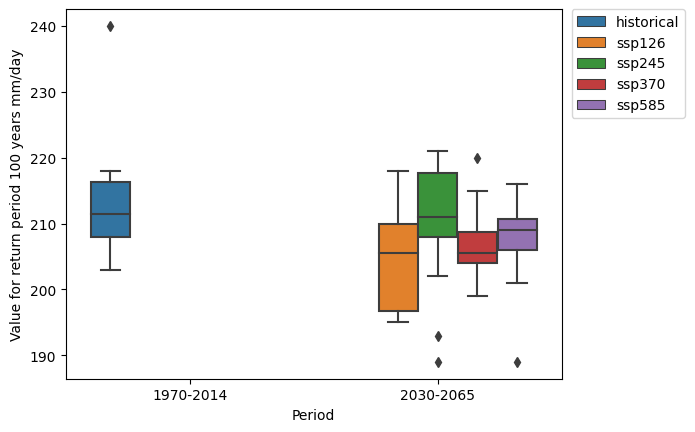

In [229]:
sns.boxplot(data=df_return_BC_gorongosa.reset_index(),x='Period',y='Value for return period 100 years mm/day',hue='Experiment')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

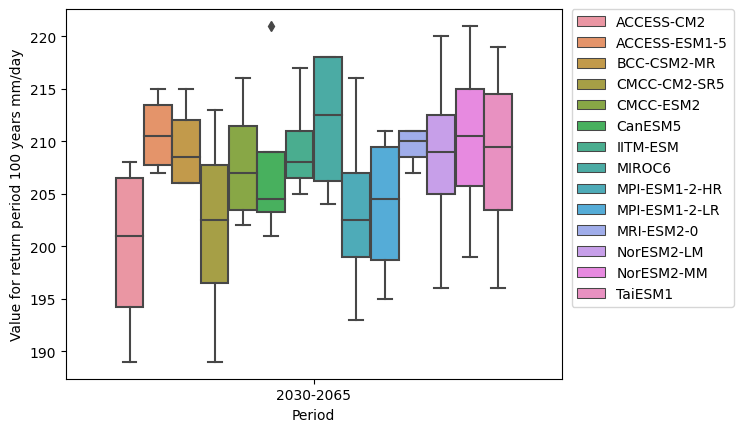

In [232]:
sns.boxplot(data=df_return_BC_gorongosa.reset_index()[df_return_BC_gorongosa.reset_index()['Period']=='2030-2065'],x='Period',y='Value for return period 100 years mm/day',hue='Model')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

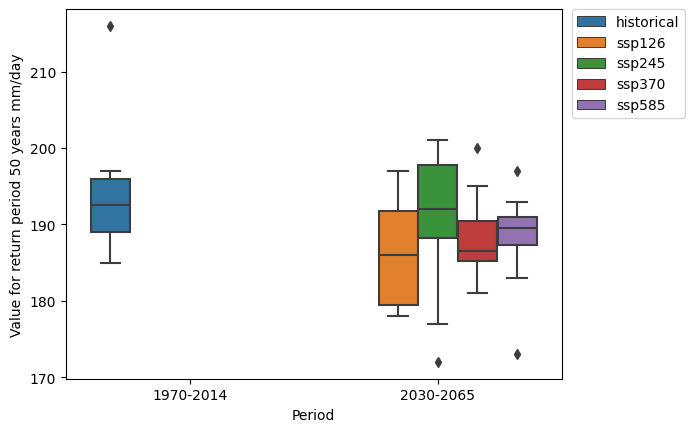

In [230]:
sns.boxplot(data=df_return_BC_gorongosa.reset_index(),x='Period',y='Value for return period 50 years mm/day',hue='Experiment')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

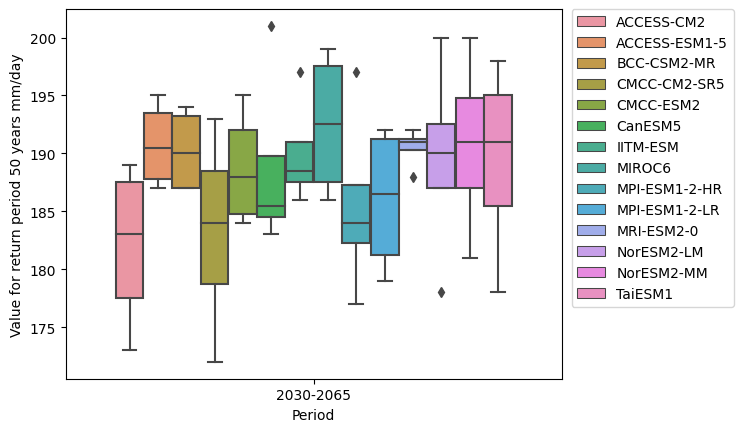

In [236]:
sns.boxplot(data=df_return_BC_gorongosa.reset_index()[df_return_BC_gorongosa.reset_index()['Period']=='2030-2065'],x='Period',y='Value for return period 50 years mm/day',hue='Model')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

In [238]:
df_obs_NOAA_Chimoio['Period']= 'Observation data from Chimoio 1970-2014'

In [255]:
df_obs_NOAA_Chimoio.columns

Index(['STATION', 'NAME', 'LATITUDE', 'LONGITUDE', 'ELEVATION', 'DATE', 'pr',
       'PRCP_ATTRIBUTES', 'TAVG', 'TAVG_ATTRIBUTES', 'TMAX', 'TMAX_ATTRIBUTES',
       'TMIN', 'TMIN_ATTRIBUTES', 'Year', 'Month', 'Season', 'PRCP MISSING',
       'TAVG MISSING', 'TMAX MISSING', 'TMIN MISSING', 'Period'],
      dtype='object')

In [257]:
df_obs_NOAA_Chimoio_pr=df_obs_NOAA_Chimoio[['DATE','pr','Period']]

In [239]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj_gorongosa = df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj[df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj['Name project']=='Gorongosa_EIB']

In [240]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj_gorongosa['Period']='Modelled and BC 2030-2065'

In [241]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_past_gorongosa=df_tasmax_NEXGDDPCMIP6_BC_NOAA_past[df_tasmax_NEXGDDPCMIP6_BC_NOAA_past['Name project']=='Gorongosa_EIB']

In [242]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_past_gorongosa['Period']='Modelled and BC 1970-2014'

In [244]:
df_tas_NEXGDDPCMIP6_past_gorongosa = df_tas_NEXGDDPCMIP6[(df_tas_NEXGDDPCMIP6['Name project']=='Gorongosa_EIB') & (df_tas_NEXGDDPCMIP6['Year'].between(1970,2014))]

In [245]:
df_tas_NEXGDDPCMIP6_past_gorongosa['Period']='Modelled 1970-2014'

In [246]:
df_tas_NEXGDDPCMIP6_future_gorongosa = df_tas_NEXGDDPCMIP6[(df_tas_NEXGDDPCMIP6['Name project']=='Gorongosa_EIB') & (df_tas_NEXGDDPCMIP6['Year'].between(2030,2065))]

In [247]:
df_tas_NEXGDDPCMIP6_future_gorongosa['Period']='Modelled 2030-2065'

In [ ]:
df_obs_NOAA_Chimoio_pr['Model']='Observation data from Chimoio 1970-2014'

In [263]:
df_obs_NOAA_Chimoio_pr.rename(columns={'DATE':'Date','pr':'Mean of the daily precipitation rate mm_per_day'},inplace=True)

In [259]:
df_tas_NEXGDDPCMIP6_past_gorongosa.columns

Index(['Name project', 'Experiment', 'Model', 'Latitude', 'Longitude', 'Date',
       'Mean of the daily precipitation rate mm_per_day', 'Year', 'Month',
       'Season', 'Period'],
      dtype='object')

In [260]:
df_tas_NEXGDDPCMIP6_future_gorongosa.columns

Index(['Name project', 'Experiment', 'Model', 'Latitude', 'Longitude', 'Date',
       'Mean of the daily precipitation rate mm_per_day', 'Year', 'Month',
       'Season', 'Period'],
      dtype='object')

In [261]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_past_gorongosa.columns

Index(['Date', 'Mean of the daily precipitation rate mm_per_day',
       'Name project', 'Experiment', 'Model', 'Year', 'Month', 'Season',
       'Period'],
      dtype='object')

In [262]:
df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj_gorongosa.columns

Index(['Date', 'Mean of the daily precipitation rate mm_per_day',
       'Name project', 'Experiment', 'Model', 'Year', 'Month', 'Season',
       'Period'],
      dtype='object')

In [264]:
df_data=pd.concat([df_obs_NOAA_Chimoio_pr,df_tas_NEXGDDPCMIP6_past_gorongosa,df_tas_NEXGDDPCMIP6_future_gorongosa,df_tasmax_NEXGDDPCMIP6_BC_NOAA_past_gorongosa,df_tasmax_NEXGDDPCMIP6_BC_NOAA_proj_gorongosa])

<Axes: xlabel='Period', ylabel='Mean of the daily precipitation rate mm_per_day'>

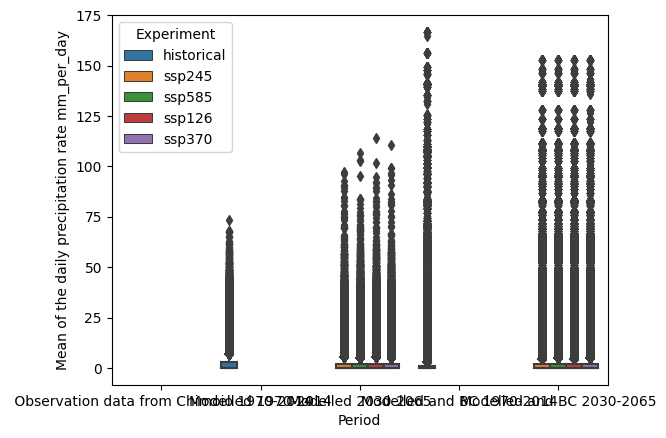

In [266]:
sns.boxplot(data= df_data, x='Period',y= 'Mean of the daily precipitation rate mm_per_day',hue='Experiment')

In [250]:
df_data

,STATION,NAME,LATITUDE,LONGITUDE,ELEVATION,DATE,pr,PRCP_ATTRIBUTES,TAVG,TAVG_ATTRIBUTES,...,TMAX MISSING,TMIN MISSING,Period,Name project,Experiment,Model,Latitude,Longitude,Date,Mean of the daily precipitation rate mm_per_day
2689,MZ000067295,"CHIMOIO, MZ",-19.117,33.467,732.0,1970-01-01,0.4,",,Q",NaN,NaN,...,0.0,0.0,Observation data from Chimoio 1970-2014,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2690,MZ000067295,"CHIMOIO, MZ",-19.117,33.467,732.0,1970-01-02,0.0,",,Q",NaN,NaN,...,0.0,0.0,Observation data from Chimoio 1970-2014,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2691,MZ000067295,"CHIMOIO, MZ",-19.117,33.467,732.0,1970-01-03,0.0,",,Q",NaN,NaN,...,0.0,0.0,Observation data from Chimoio 1970-2014,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2692,MZ000067295,"CHIMOIO, MZ",-19.117,33.467,732.0,1970-01-04,0.0,",,Q",NaN,NaN,...,0.0,0.0,Observation data from Chimoio 1970-2014,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2693,MZ000067295,"CHIMOIO, MZ",-19.117,33.467,732.0,1970-01-05,0.0,",,Q",NaN,NaN,...,0.0,0.0,Observation data from Chimoio 1970-2014,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2942775,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Modelled and BC 2030-2065,Gorongosa_EIB,ssp370,MPI-ESM1-2-HR,NaN,NaN,2065-12-27,0.0
2942776,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Modelled and BC 2030-2065,Gorongosa_EIB,ssp370,MPI-ESM1-2-HR,NaN,NaN,2065-12-28,0.0
2942777,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Modelled and BC 2030-2065,Gorongosa_EIB,ssp370,MPI-ESM1-2-HR,NaN,NaN,2065-12-29,0.0
2942778,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Modelled and BC 2030-2065,Gorongosa_EIB,ssp370,MPI-ESM1-2-HR,NaN,NaN,2065-12-30,0.0


In [ ]:
# do the same presentation but with gorongosa data

In [267]:
from Functions_ImportData import import_gorongosa_obs_pr
obs_data_pr = import_gorongosa_obs_pr() 

In [269]:
obs_data_pr = obs_data_pr[obs_data_pr['Year'].between(1980,2014)]

In [273]:
df_return_period_obs=return_period(obs_data_pr[['pr','Year']].dropna(),100,1980,2014)

In [274]:
df_return_period_obs

250

In [275]:
from Functions_ImportData import import_BC_Gorongosa_NEX_GDDP_CMIP6

In [276]:
BC_Gorongosa_NEX_GDDP_CMIP6_past=import_BC_Gorongosa_NEX_GDDP_CMIP6(1980,2014, climate_var='pr',resolution='day',unit='mm_per_day')

In [277]:
BC_Gorongosa_NEX_GDDP_CMIP6_future=import_BC_Gorongosa_NEX_GDDP_CMIP6(2030,2065, climate_var='pr',resolution='day',unit='mm_per_day')

In [278]:
df_return_period_BC_NEX_GDDP_CMIP6_past=dataframe_threshold_coresponding_to_return_period_model(BC_Gorongosa_NEX_GDDP_CMIP6_past.dropna(),'Mean of the daily precipitation rate mm_per_day')

Gorongosa_EIB
historical
ACCESS-CM2
Name project Gorongosa_EIB ssp historical model ACCESS-CM2
ACCESS-ESM1-5
Name project Gorongosa_EIB ssp historical model ACCESS-ESM1-5
BCC-CSM2-MR
Name project Gorongosa_EIB ssp historical model BCC-CSM2-MR
CMCC-ESM2
Name project Gorongosa_EIB ssp historical model CMCC-ESM2
CanESM5
Name project Gorongosa_EIB ssp historical model CanESM5
IITM-ESM
Name project Gorongosa_EIB ssp historical model IITM-ESM
MIROC6
Name project Gorongosa_EIB ssp historical model MIROC6
MPI-ESM1-2-HR
Name project Gorongosa_EIB ssp historical model MPI-ESM1-2-HR
MPI-ESM1-2-LR
Name project Gorongosa_EIB ssp historical model MPI-ESM1-2-LR
MRI-ESM2-0
Name project Gorongosa_EIB ssp historical model MRI-ESM2-0
NorESM2-LM
Name project Gorongosa_EIB ssp historical model NorESM2-LM
NorESM2-MM
Name project Gorongosa_EIB ssp historical model NorESM2-MM


In [279]:
df_return_period_BC_NEX_GDDP_CMIP6_future=dataframe_threshold_coresponding_to_return_period_model(BC_Gorongosa_NEX_GDDP_CMIP6_future.dropna(),'Mean of the daily precipitation rate mm_per_day')

Gorongosa_EIB
ssp126
ACCESS-CM2
Name project Gorongosa_EIB ssp ssp126 model ACCESS-CM2
ACCESS-ESM1-5
Name project Gorongosa_EIB ssp ssp126 model ACCESS-ESM1-5
BCC-CSM2-MR
Name project Gorongosa_EIB ssp ssp126 model BCC-CSM2-MR
CMCC-ESM2
Name project Gorongosa_EIB ssp ssp126 model CMCC-ESM2
CanESM5
Name project Gorongosa_EIB ssp ssp126 model CanESM5
IITM-ESM
Name project Gorongosa_EIB ssp ssp126 model IITM-ESM
MIROC6
Name project Gorongosa_EIB ssp ssp126 model MIROC6
MPI-ESM1-2-HR
Name project Gorongosa_EIB ssp ssp126 model MPI-ESM1-2-HR
MPI-ESM1-2-LR
Name project Gorongosa_EIB ssp ssp126 model MPI-ESM1-2-LR
MRI-ESM2-0
Name project Gorongosa_EIB ssp ssp126 model MRI-ESM2-0
NorESM2-LM
Name project Gorongosa_EIB ssp ssp126 model NorESM2-LM
NorESM2-MM
Name project Gorongosa_EIB ssp ssp126 model NorESM2-MM
ssp245
ACCESS-CM2
Name project Gorongosa_EIB ssp ssp245 model ACCESS-CM2
ACCESS-ESM1-5
Name project Gorongosa_EIB ssp ssp245 model ACCESS-ESM1-5
BCC-CSM2-MR
Name project Gorongosa_EIB ssp

In [280]:
df_return_period_BC_NEX_GDDP_CMIP6_past['Period'] = '1980-2014'

In [281]:
df_return_period_BC_NEX_GDDP_CMIP6_future['Period'] = '2030-2065'

In [282]:
df_return_BC_gorongosa = pd.concat([df_return_period_BC_NEX_GDDP_CMIP6_past,df_return_period_BC_NEX_GDDP_CMIP6_future])

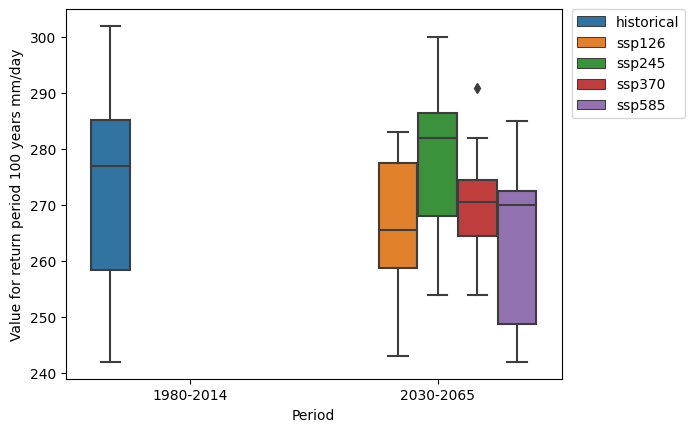

In [288]:
sns.boxplot(data=df_return_BC_gorongosa.reset_index(),x='Period',y='Value for return period 100 years mm/day',hue='Experiment')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

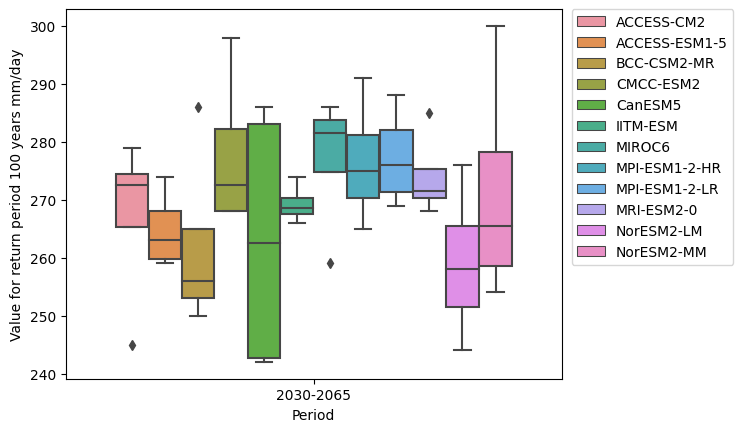

In [289]:
sns.boxplot(data=df_return_BC_gorongosa.reset_index()[df_return_BC_gorongosa.reset_index()['Period']=='2030-2065'],x='Period',y='Value for return period 100 years mm/day',hue='Model')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

## DELTE UNTIL HERE (FROM THE DELETE FROM HERE)

<a id='wind'></a>
## Wind Speed

Daily wind speed, historical and projected.

Data source : https://cds.climate.copernicus.eu/cdsapp#!/dataset/projections-cmip6?tab=form

In [ ]:
### Extraction of Near-surface wind speed data
global_variable = 'Wind'
name_variable = 'near_surface_wind_speed'

#### Historical data for wind speed

#### Projection data for wind speed

<a id='humidity'></a>
## Humidity

Source : https://cds.climate.copernicus.eu/cdsapp#!/dataset/projections-cmip6?tab=form

### Relative humidity

Relative humidity of air: amount if moisture it contains compared to the maximum amount of moisture it can have at a specific temperature

### Extraction of Relative humidity data

In [ ]:
global_variable = 'Relative_Humidity'
name_variable = 'near_surface_relative_humidity' # only available on a monthly basis

#### Historical data

#### Projections

<a id='solar_radiation'></a>
## Solar radiation

In [ ]:
global_variable = 'Solar_radiation'
# choose of the climate variable from copernicus to represent : choose of surface_downwelling_shortwave_radiation because
# 1. interest for project located at the surface of the Earth
# 2. for most project (for example solar panels), we are interest in radiation going down, not up
# 3. Shortwave radiation are the ones produce by the sun
name_variable = 'surface_downwelling_shortwave_radiation' # only available on a monthly basis

#### Historical data for solar radiation

#### Projection for data solar radiation

<a id='land_climate_variables'></a>
# LAND

[Home](#beginning_CRVA)

<a id='landslides'></a>
## Landslides - Land

source: https://datacatalog.worldbank.org/search/dataset/0037584 (Global Landslide Hazard Map, The World Bank)

### Description of LS_TH : 
The Global Landslide Hazard Map presents a qualitative representation of global landslide hazard at a global scale. It is the combination of the The Global Landslide Hazard Map: Median Annual Rainfall-Triggered Landslide Hazard (1980-2018) and The Global Landslide Hazard Map: Earthquake-Triggered Landslide Hazard which has then been simplified to four rank categories, ranging from Very low to High landslide hazard, based on the existing system used by ThinkHazard! (www.thinkhazard.org)

### Description of LS_RF_Median_1980-2018 :
The Global Rainfall-Triggered Landslide Hazard Map presents a quantitative representation of landslide hazard. This component is the median annual rainfall-triggered landslide hazard assessment for the period 1980 – 2018. Raster values represent the modelled average annual frequency of significant rainfall-triggered landslides per sq. km.

In [ ]:

#Landslides data path
landslidesTH_path=os.path.join(data_folder,'landslides/wb_GlLandslHazard/ls_th/LS_TH.tif') ## Global landslide hazard map (TH ranks --> Think hazard ranks)
landslidesRF_path=os.path.join(data_folder,'landslides/wb_GlLandslHazard/ls_rf_median_1980-2018/LS_RF_Median_1980-2018.tif')

#spatial stats
projects['landslides_THmax']=pd.DataFrame(zonal_stats(vectors=projects_buf, raster=landslidesTH_path, 
                                                            all_touched=True, stats='max'))
projects['landslidesRF_medianMax']=pd.DataFrame(zonal_stats(vectors=projects_buf, raster=landslidesRF_path, 
                                                            all_touched=True, stats='max'))
#show table
projects[[project_id,'landslides_THmax','landslidesRF_medianMax']].head()

#plot landslides TH
fig, ax = plt.subplots()
landslides = rioxarray.open_rasterio(landslidesTH_path)
landslides_clip = landslides.rio.clip(study_area.geometry, study_area.crs, drop=True)
landslides_clip.plot(ax=ax, cmap='Reds',vmin=1, vmax=4)
points=projects.plot(ax=ax,cmap='Greys') # what are those points ????

#close
landslides.close()
landslides_clip.close()

# didn't achieved to present the RF datas
#plot landslides RF
#fig, ax = plt.subplots()
#landslides = rioxarray.open_rasterio(landslidesRF_path)
#landslides_clip = landslides.rio.clip(study_area.geometry, study_area.crs, drop=True)
#landslides_clip.plot(ax=ax, cmap='Reds',vmin=1, vmax=4)
#points=projects.plot(ax=ax,cmap='Greys') # what are those points ????
#landslides.close()

## Global wildfire hazard - Land

This jupyter notebook is to study the global wildfire hazard

Source : https://datacatalog.worldbank.org/search/dataset/0042058/Global-wildfire-hazard

Description of the source : The approach to classify wildfire hazard levels used is based solely on fire weather index climatology. Fire weather indices are used in many countries to assess both the onset of conditions that will allow fires to spread, as well as the likelihood of fire at any point in the landscape. The method presented uses statistical modelling (extreme value analysis) of a 30 year fire weather climatology to assess the predicted fire weather intensity for specific return period intervals. These intensities are classified based on thresholds using conventions to provide hazard classes that correspond to conditions that can support problematic fire spread in the landscape if an ignition and sufficient fuel were to be present.

Date of export : 23.03.23

Projection FWI for europe : https://cds.climate.copernicus.eu/cdsapp#!/dataset/sis-tourism-fire-danger-indicators?tab=overview

Projection seasonal severity rating of for EUrope : https://www.eea.europa.eu/data-and-maps/figures/projected-meteorological-forest-fire-danger

Calculation of the FWI : https://cwfis.cfs.nrcan.gc.ca/background/summary/fwi

GLOBAL PROJeTIONS NOT FOUND


## Soil erosion - Land

Source for global actual situations : https://data.jrc.ec.europa.eu/dataset/jrc-esdac-120

<a id='hydrosphere_climate_variables'></a>
# HYDROSPHERE

[Home](#beginning_CRVA)

<a id='relative_sea_level_rise'></a>
## Relative sea level rise

In [ ]:
## use copernicus or NASA data ? NASA data are in COWI servor \\COWI.net\projects\A245000\A248363\CRVA\Datasets\SeaLevelRise\Nasa
# use mean sea level > https://cds.climate.copernicus.eu/cdsapp#!/dataset/sis-water-level-change-indicators-cmip6?tab=overview

<a id='sea_water_temperature'></a>
## Sea water temperature

In [ ]:
global_variable = 'Sea_water_temperature'
name_variable = 'sea_surface_temperature' # only estimate for the surface in the copernicus CMIP6

#### Historical data

In [ ]:
(year_historical, year_str_historical, index_historical)=year_copernicus(1850,2014)
temporal_resolution = 'monthly'
# Register data from copernicus for humidity in a dataframe and production of a csv file for the period indicated above
Sea_water_temperature_historical = dataframe_csv_copernicus(temporal_resolution,year_str_historical,copernicus_elements.experiments_historical,copernicus_elements.models,out_path,global_variable, name_variable,area)    

#### Projection data

In [ ]:
(year, year_str, index)=year_copernicus(2020,2100)
temporal_resolution = 'monthly'
# Register data from copernicus for humidity in a dataframe and production of a csv file for the period indicated above
Sea_water_temperature = dataframe_csv_copernicus(temporal_resolution,year_str,copernicus_elements.experiments,copernicus_elements.models,out_path,global_variable, name_variable,area)    

<a id='water_availability'></a>
## Water availability
Represented with water stress

Did not find historical data, look into world bank

Source for projections from 2020 to 2050 : https://www.wri.org/data/aqueduct-water-stress-projections-data
Informations about how the shp is designed located here : data_folder, Water_Availability_WaterStress\aqueduct_projections_20150309_shp\aqueduct_projections_schematic_20140615 (excel sheet)

In [ ]:
## Projection of water stress
# register path to water stress data
water_stress_location_path=os.path.join(data_folder,'Water_Availability_WaterStress/aqueduct_projections_20150309_shp/aqueduct_projections_20150309.shp')
# register data in default projection 4326
water_stress = gpd.read_file(water_stress_location_path).to_crs(bCRS) # uncertain that projeciton is the default one
ws_geometry = water_stress.geometry # register geometry for later
# filter columns of dataframe that are not water stress related
elements_to_drop=('sv','ut','bt','r','u','c','20','BasinID','dwnBasinID','Shape_Leng','Shape_Le_1') # if a column contains a str in this list, the column should be drop
# 20 to remove the projections for 2020 (the projections were made in 2015)

for name_column_out in elements_to_drop:
    water_stress=water_stress.drop(water_stress.filter(regex=name_column_out).columns, axis=1)
    
# making name of columns more precise
# information on column names come from 
#\\COWI.net\projects\A245000\A248363\CRVA\Datasets\Water_Availability_WaterStress\aqueduct_projections_20150309_shp\aqueduct_projections_schematic_20140615
scenarios_ws=['ssp2_rcp45','ssp2_rcp85','ssp3_rcp85']
projections_ws = ['projection_2030 ','projection_2040 ']
old_name = ['ws', '30','40','24','28','38','tl']
new_name = ['water stress ','projection_2030 ','projection_2040 ','ssp2_rcp45','ssp2_rcp85','ssp3_rcp85','']

for o,n in zip(old_name,new_name): # iterate accross the two list at a time
    water_stress.columns = water_stress.columns.str.replace(o, n) # replacing "40" by "projection_2040" in names of columns
        
# water_stress is a panda dataframe, not geopanda.dataframe. Need to convert it again in geopandas.geodataframe.GeoDataFrame. 
# Otherwise, impossible to use sjoin later
water_stress = GeoDataFrame(water_stress, crs=bCRS, geometry=ws_geometry) # convert panda.dataframe in geopandas.geodataframe.GeoDataFrame

# join information from water stress to projects

projects=projects.sjoin(water_stress,how='left',predicate='within', lsuffix="_left") # need to rename name of columns to make it understandable
projects.drop('index_right', axis=1, inplace=True) # drop column containing index from water stress
projects # projects stays a geopandas.geodataframe.GeoDataFrame

In [ ]:
Display_map_projects(projects,study_area,'water stress','Map presenting water stress projections for Mozambique projects', 2, 3, out_path)
# This function aims to display every projects wanted by the user with a map as a background
### Parameters of the function : 
# projects: geopanda.dataframe containing projects information
# study_area: geopanda.dataframe containing study_area information
# str_interest: string of the climate variable of interest to be represented
# title_for_image: title for image composed of subplots
# number_rows: the user should indicate the number of rows for the subplots
# number_cols: the user should indicate the number of cols for the subplots
# out_path: begenning of the path to register the image

In [ ]:
# select climate variable to be represented
columns_to_represent= list(projects.filter(regex='water stress').columns) # select columns that should be presented in plots
columns_to_represent2=[ ('\n').join(k.split(' ')[-2:])  for k in columns_to_represent] # delete 'water stress' from 
# the list column_to_represent and insert \n to do a back to line
number_plots = len(columns_to_represent)

# create figure
fig, axs = plt.subplots(nrows=2,ncols=3, sharex=True, sharey=True,figsize=(8,8))

color_dict = {'Low':'green', 'Antarctica':'white', 'Asia':'pink', 
              'Europe':'green', 'North America':'brown',
              'Oceania':'blue', 'Seven seas (open ocean)':'gray',
              'South America':'red'}

# map in the subplot
k = 0

for i in np.arange(0,3):# columns
    for j in np.arange(0,2): # lines
        base = study_area.plot(ax=axs[j][i],color='white', edgecolor='black')# background is map of the study area presenting 
        # country borders of this area
        projects.plot(ax=axs[j][i], column=columns_to_represent[k])# plot the projects as points; legeng = True 
        # impose a color for the projects point depending on the value in the column
        
        # give subplot a title
        ax_created = axs[j][i]
        ax_created.title.set_text(columns_to_represent2[k])
        
        k+=1 # incrementation to iterate columns_to_represent
plr
plt.suptitle('Map presenting water stress projections for Mozambique projects') # give a global name to the image
plt.savefig(os.path.join(out_path,'figures','water stress','Map presenting water stress projections for Mozambique projects'),format ='png') # savefig or save text must be before plt.show. for savefig, format should be explicity written
plt.show()

In [ ]:
np.arange(0,3)

In [ ]:
axs

In [ ]:
projects

In [ ]:
columns_to_represent= list(projects.filter(regex='water stress').columns) # select columns that should be presented in plots
columns_to_represent=[ (' ').join(k.split(' ')[-2:])  for k in columns_to_represent] # delete 'water stress' from the list column_to_represent

In [ ]:
columns_to_represent

In [ ]:
[s.replace('water stress ', '') for s in columns_to_represent]
columns_to_represent

In [ ]:
# plot results for projects
columns_to_represent= list(projects.filter(regex='water stress').columns) # select columns that should be presented in plots
number_plots = len(columns_to_represent)

# trying to do a map with shape of area and points projets
#projects.plot(column='water stress projection_2030 ssp2_rcp45', legend=True)

In [ ]:
fig, (ax1, ax2,ax3) = plt.subplots(ncols=3, sharex=True, sharey=True,figsize=(8,8))
#norm = plt.colors.Normalize(vmin=projects.val.min(), vmax=projects.val.max()) # to normalize legend between the different plots
# wait to see if new intallation worked
base = study_area.plot(ax=ax1,color='white', edgecolor='black')
projects.plot(ax=ax1, column='water stress projection_2030 ssp2_rcp45',legend=True)
base = study_area.plot(ax=ax2,color='white', edgecolor='black')
projects.plot(ax=ax2, column='water stress projection_2040 ssp2_rcp45',legend=True)
base = study_area.plot(ax=ax3,color='white', edgecolor='black')
projects.plot(ax=ax3, column='water stress projection_2030 ssp2_rcp85',legend=True)
#projects.plot(column='water stress projection_2030 ssp2_rcp45',ax=base, legend=True);

<a id='floods'></a>
## Floods - Hydrosphere

####  Fluvial
Sources:
1) JRC Flood Hazard Map, http://data.europa.eu/89h/jrc-floods-floodmapgl_rp100y-tif : The map depicts flood prone areas at global scale for flood events with 100-year return period. Resolution is 30 arcseconds (approx. 1km). Cell values indicate water depth (in m). The map can be used to assess flood exposure and risk of population and assets. NOTE: this dataset is based on JRC elaborations and is not an official flood hazard map (for details and limitations please refer to related publications).
2) Dataset of tropical cyclone Idai and subsequent flood disaster in Southern Africa (March 2019). National Tibetan Plateau Data Center, https://data.tpdc.ac.cn/en/data/8d836d13-a8e6-492b-9324-00fbfce40619/ 

#### Coastal 
Source: WRI Aqueduct database

In [ ]:
# save the path for the image presenting the floods which have a return period of a 100 year
flood_path=os.path.join(data_folder,'floodMapGL_rp100y/floodMapGL_rp100y.tif')

buffer_flood=1000#meters # pas sure : sert a avoir les 
if buffer_flood != 0:
    projects_bufFlood=projects.to_crs(mCRS)  #project to crs with metric units to get buffer in meters
    projects_bufFlood['geometry']=projects.to_crs(mCRS).buffer(buffer_flood) #assign the buffer as the new geometry - 
    projects_bufFlood=projects_bufFlood.to_crs(bCRS)#project back to orginal crs

projects['floods100yr_max']=pd.DataFrame(zonal_stats(vectors=projects_bufFlood, raster=flood_path, 
                                                            all_touched=True, stats='max'))
#plot
fig, ax = plt.subplots()
floods = rioxarray.open_rasterio(flood_path)
floods_clip = floods.rio.clip(study_area.geometry, study_area.crs, drop=True)
floods_clip.plot(ax=ax,cmap='Blues',vmin=0,vmax=25)
projects.plot(ax=ax,color='Black') # mapping the projects located in the study area
#cb.set_label('Water depth (m)') # name for color scale ne fonctionne pas car cette ligne appartient a basemap language
ax.set_title('Floods extent with a\nreturn period of 100 years') # set a title to the image

#close
floods_clip.close()
floods.close()

#### Sea level rise

Global Mean Sea Level
Source : https://climate.nasa.gov/vital-signs/sea-level/ ; used the Global Mean Sea Level (Global Isostatic Adjustment (GIA) applied) variation (mm) with respect to 20-year TOPEX/Jason collinear mean reference 

Sea Level Trends
Source : https://sealevel.colorado.edu/trend-map : sea level trend from 1992 to 2022

<a id='second_effect_climate_variables'></a>
# Second effect climate variables

[Home](#beginning_CRVA)

<a id='cyclone_risk'></a>
## Cyclones
data source: https://wesr.unepgrid.ch/?project=MX-XVK-HPH-OGN-HVE-GGN&language=en UNEP-GRID, 

cyclone risk level from 1 (low) to 5 (extreme)

C:\Users\RAPY\Miniconda3\envs\geodata\lib\site-packages\rasterstats\main.py:156: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  if 'Point' in geom.type:
C:\Users\RAPY\Miniconda3\envs\geodata\lib\site-packages\rasterstats\main.py:156: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  if 'Point' in geom.type:
C:\Users\RAPY\Miniconda3\envs\geodata\lib\site-packages\rasterstats\main.py:156: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  if 'Point' in geom.type:
C:\Users\RAPY\Miniconda3\envs\geodata\lib\site-packages\rasterstats\main.py:156: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  if 'Point' in

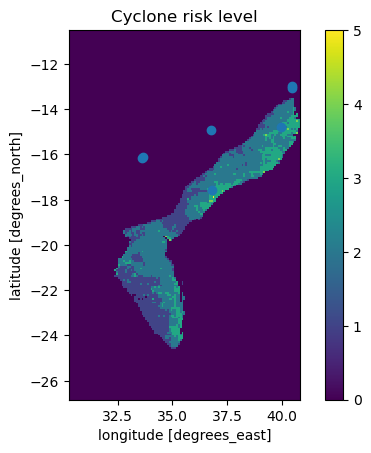

In [5]:
#cyclone data path
cyclone_path=os.path.join(data_folder,'cyclones/unep_grid/cy_risk.tif')
 
   # \\COWI.net\projects\A245000\A248363\CRVA\Datasets\cyclones\unep_grid
#spatial stats
projects['cyclone_risk']=pd.DataFrame(zonal_stats(vectors=projects_buf, raster=cyclone_path, all_touched=True, stats='max'))

#show table
projects[[project_id,'cyclone_risk']].head()

#plot
fig, ax = plt.subplots()
cyclone = rioxarray.open_rasterio(cyclone_path)
cyclone_clip = cyclone.rio.clip(study_area.geometry, study_area.crs, drop=True)
cyclone_clip.plot(ax=ax)
projects.plot(ax=ax) # plot the projects on the map

plt.title('Cyclone risk level') # title of the graph

#close
cyclone_clip.close()
cyclone.close()

<a id='climate_change_info_for_each_project_in_study_area'></a>
# Climate change information concerning the projects in the study area

Display climate change information concerning the project you are looking into.

[Home](#beginning_CRVA)

In [ ]:
# selection of projects in the study area
#RAPY: not useful since study area is just for plotting purposes, projects should be only the relevant ones already
#projects_of_interest=projects[projects.within(study_area)]

# selection of the information to display
list_of_names=['Name','province','climatology-hd40_2020-2039_ssp245_median',
               'daily-median-Wind-2100-ssp5_8_5','landslides_THmax','floods100yr_max','cyclone_risk']

# display selected climate change information of the projects in the study area
projects_of_interest_filtered = projects[list_of_names]
projects_of_interest_filtered

# Export
Exports the calculated climate variables to a csv file

[Home](#beginning_CRVA)

In [ ]:
projects.T.to_csv('outputs/csv/projects_climate_risks.csv')